In [1]:
from google.colab import drive
drive.mount('/gdrive')
%cd /gdrive/MyDrive/Thesis

Mounted at /gdrive
/gdrive/.shortcut-targets-by-id/1LdjoFY4CYOvLDf-UHEhwqzwER6Wbae6v/Thesis


In [2]:
pip install point_cloud_utils

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.3/9.3 MB 16.3 MB/s eta 0:00:00


In [3]:
!pip install open3d

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 399.7/399.7 MB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 23.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.4/139.4 kB 17.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 66.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 33.8 MB/s eta 0:00:00
  Attempting uninstall: widgetsnbextension
    Found existing installation: widgetsnbextension 3.6.6
    Uninstalling widgetsnbextension-3.6.6:
      Successfully uninstalled widgetsnbextension-3.6.6
  Attempting uninstall: ipywidgets
    Found existing installation: ipywidgets 7.7.1
    Uninstalling ipywidgets-7.7.1:
      Successfully uninstalled ipywidgets-7.7.1


# Import

In [ ]:
import tensorflow as tf
import numpy as np
import os
import random
import pandas as pd
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
# from sklearn.datasets import load_boston
from sklearn.model_selection import train_test_split
import warnings
import logging
import tensorflow as tf
import numpy as np
import os
import random
import pandas as pd
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from tensorflow.keras.models import load_model
# import visualkeras
import os
import glob
# import trimesh
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from matplotlib import pyplot as plt
import numpy as np
from scipy.spatial.distance import cdist
tf.random.set_seed(1234)
import random
from IPython.display import clear_output
from keras import layers
from keras import initializers

tfk = tf.keras
tfkl = tf.keras.layers
print(tf.__version__)

# Random seed for reproducibility
seed = 42

random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)
np.random.seed(seed)
tf.random.set_seed(seed)
tf.compat.v1.set_random_seed(seed)
tf.config.experimental.enable_op_determinism()



2.15.0


# import Data

## Import Data manually

In [ ]:
import numpy as np
import os

def extract_point_cloud(file_path):
    points = []

    with open(file_path, 'r') as obj_file:
        for line in obj_file:
            if line.startswith('v '):
                coordinates = line.strip().split()[1:]  # Extract coordinates after 'v'
                points.append([float(coord) for coord in coordinates])

    return points

# Provide the root directory path containing the folders with OBJ files
root_directory = 'dataset'

# Create an empty list to store the point cloud arrays
point_clouds = []

# Iterate over the root directory and its subdirectories
for dir_path, dir_names, file_names in os.walk(root_directory):
    # Iterate over the files in the folder
    for file_name in file_names:
        if file_name.endswith('.obj'):
            obj_file_path = os.path.join(dir_path, file_name)
            point_cloud = extract_point_cloud(obj_file_path)
            if point_cloud:
                point_clouds.append(point_cloud)

# Determine the maximum number of points in a point cloud
max_points_per_cloud = max(len(pc) for pc in point_clouds)

# Create a new array with consistent number of points in each point cloud
point_clouds_array = np.zeros((len(point_clouds), max_points_per_cloud, 3))

# Fill the array with the XYZ coordinates
for i, pc in enumerate(point_clouds):
    for j, point in enumerate(pc):
        point_clouds_array[i, j, :] = point

# # Print the array
# print(point_clouds_array)



In [ ]:
X = point_clouds_array
point_clouds_array.shape
# np.save('point_clouds_array.npy', point_clouds_array)

# face_v = point_clouds_array.copy()
# face_vn = point_clouds_array.copy()


In [ ]:
### add v & vn

everything = []
# everything [i] = np.concatenate((X[i], transformed_point_cloud[i]), axis=1)
for i in range(len(X)):
    everything.append(np.vstack((face_v[i],face_vn[i] )))

everything = np.array(everything)
everything.shape

(99, 270676, 3)

In [ ]:
import numpy as np
import os
paaa=[]
# Provide the root directory path containing the folders with text files
root_directory = 'dataset'

# Create an empty list to store the XYZ coordinate arrays
xyz_coordinates = []

# Iterate over the root directory and its subdirectories
for dir_path, dir_names, file_names in os.walk(root_directory):
    # Iterate over the files in the folder
    for file_name in file_names:
        if file_name.endswith('.txt'):
            txt_file_path = os.path.join(dir_path, file_name)
            coordinates = []

            with open(txt_file_path, 'r') as txt_file:
                for line in txt_file:

                    if line.strip() and not line.startswith('landmark names'):
                        coordinate = line.strip().split('\t')[1].strip('()').split(',')
                        coordinate = [float(coord) for coord in coordinate]
                        coordinates.append(coordinate)

            if len(coordinates) == 50:
                xyz_coordinates.append(coordinates)
            else:
                paaa.append(dir_path)


# Convert the list of XYZ coordinate arrays to a multi-dimensional array


# Print the array
# print(xyz_coordinates_array)


In [ ]:
xyz_coordinates_array = np.array(xyz_coordinates)
# y= xyz_coordinates_array[:,1,:]
y= xyz_coordinates_array
y.shape
# np.save('xyz_coordinates_array.npy', xyz_coordinates_array)


(99, 50, 3)

## Import samples (trimesh)

In [ ]:
import numpy as np
import os
# Provide the root directory path containing the folders with OBJ files
root_directory = 'dataset'

# Create an empty list to store the point cloud arrays
point_clouds = []

# Iterate over the root directory and its subdirectories
for dir_path, dir_names, file_names in os.walk(root_directory):
    # Iterate over the files in the folder
    for file_name in file_names:
        if file_name.endswith('.obj'):
            mesh = trimesh.load(os.path.join(dir_path, file_name),force='mesh')
            points = mesh.sample(100000)
            # points = mesh.sample(500)

            point_clouds.append(points)


In [ ]:
point_clouds = np.array(point_clouds)
X = point_clouds
point_clouds.shape

(99, 10000, 3)

In [ ]:
y= xyz_coordinates_array
y.shape

(99, 50, 3)

In [ ]:
everything = []
# everything [i] = np.concatenate((X[i], transformed_point_cloud[i]), axis=1)
for i in range(len(X)):
    everything.append(np.vstack((X[i],y[i] )))

In [ ]:
everything = np.array(everything)
everything[0].shape

(100050, 3)

## Import registered

In [ ]:
#import 10K points registered

# np.save('faces_aligned_10k_500.npy', faces_aligned)
# np.save('landmark_aligned_10k_500.npy', landmark_aligned)
faces_aligned = np.load('faces_aligned_10k_500.npy',allow_pickle=True)
landmark_aligned = np.load('landmark_aligned_10k_500.npy',allow_pickle=True)

In [ ]:
# np.save('faces_aligned_1k.npy', faces_aligned)
# np.save('landmark_aligned_1k.npy', landmark_aligned)

# np.save('faces_aligned_10k_500.npy', faces_aligned)
# np.save('landmark_aligned_10k_500.npy', landmark_aligned)

faces_aligned = np.load('faces_aligned.npy',allow_pickle=True)
landmark_aligned = np.load('landmark_aligned.npy',allow_pickle=True)

In [ ]:
point_clouds_array = np.zeros((99, 135338, 3))

# Fill the array with the XYZ coordinates
for i, pc in enumerate(faces_aligned):
    for j, point in enumerate(pc):
        point_clouds_array[i, j, :] = point

faces_aligned = point_clouds_array

In [ ]:
## import register
faces_aligned_100k_new = np.load('faces_aligned_10k.npy',allow_pickle=True)
#### separate land marks
faces_aligned=[]
landmark_aligned=[]
for i in range(len(faces_aligned_100k_new)):
    faces_aligned.append(faces_aligned_100k_new[i][:100000])
    landmark_aligned.append(faces_aligned_100k_new[i][100000:])

faces_aligned = np.array(faces_aligned)
landmark_aligned= np.array(landmark_aligned)
print(faces_aligned[0].shape, landmark_aligned[0].shape)

(100000, 3) (50, 3)


# Registration

ICP

In [ ]:
import numpy as np
from scipy.spatial import KDTree

def icp_registration2(source_points, target_points, Landmarks, max_iterations=100, tolerance=1e-6):
    """
    Performs ICP registration to align two sets of 3D point clouds.

    Args:
    source_points: numpy array of shape (N, 3) representing the source point cloud.
    target_points: numpy array of shape (M, 3) representing the target point cloud.
    max_iterations: maximum number of iterations for ICP (default: 100).
    tolerance: convergence tolerance for ICP (default: 1e-6).

    Returns:
    aligned_points: numpy array of shape (N, 3) representing the aligned source point cloud.
    transformation: 4x4 numpy array representing the transformation matrix (source_points = transformation @ aligned_points).
    """
    # Initialize transformation matrix as identity
    transformation = np.eye(4)
    transformation_all = transformation
    i=0

    for iteration in range(max_iterations):
        i=i+1

        # Find nearest neighbors
        tree = KDTree(target_points)
        _, nearest_indices = tree.query(source_points)

        # Extract corresponding points
        nearest_points = target_points[nearest_indices]

        # Compute centroid of points
        source_center = np.mean(source_points, axis=0)
        nearest_center = np.mean(nearest_points, axis=0)

        # Subtract centroids to center the points
        centered_source_points = source_points - source_center
        centered_nearest_points = nearest_points - nearest_center

        # Compute covariance matrix
        covariance_matrix = np.dot(centered_source_points.T, centered_nearest_points)

        # Perform singular value decomposition
        u, _, v = np.linalg.svd(covariance_matrix)

        # Compute rotation matrix
        rotation_matrix = np.dot(v.T, u.T)

        # Compute translation vector
        translation_vector = nearest_center - np.dot(rotation_matrix, source_center)

        # Construct transformation matrix
        transformation[:3, :3] = rotation_matrix
        transformation[:3, 3] = translation_vector

        # transformation_all = np.dot(transformation, transformation_all)






        # Apply transformation to source points
        aligned_points = np.dot(transformation[:3, :], np.vstack((source_points.T, np.ones(source_points.shape[0])))).T[:, :3]

        aligned_landmarks = np.dot(transformation[:3, :], np.vstack((Landmarks.T, np.ones(Landmarks.shape[0])))).T[:, :3]



        # Check convergence
        mean_distance = np.mean(np.linalg.norm(nearest_points - source_points, axis=1))
        if mean_distance < tolerance:
            break

        # Update source points for the next iteration
        source_points = aligned_points
        Landmarks = aligned_landmarks

    return aligned_points, aligned_landmarks


In [ ]:
import numpy as np
from scipy.spatial import KDTree

# def icp_registration(source_points, target_points, Landmarks, max_iterations=100, tolerance=1e-6):
def icp_registration(source_points, target_points, max_iterations=100, tolerance=1e-6):

    """
    Performs ICP registration to align two sets of 3D point clouds.

    Args:
    source_points: numpy array of shape (N, 3) representing the source point cloud.
    target_points: numpy array of shape (M, 3) representing the target point cloud.
    max_iterations: maximum number of iterations for ICP (default: 100).
    tolerance: convergence tolerance for ICP (default: 1e-6).

    Returns:
    aligned_points: numpy array of shape (N, 3) representing the aligned source point cloud.
    transformation: 4x4 numpy array representing the transformation matrix (source_points = transformation @ aligned_points).
    """
    # Initialize transformation matrix as identity
    transformation = np.eye(4)
    transformation_all = transformation
    i=0

    for iteration in range(max_iterations):
        i=i+1

        # Find nearest neighbors
        tree = KDTree(target_points)
        _, nearest_indices = tree.query(source_points)

        # Extract corresponding points
        nearest_points = target_points[nearest_indices]

        # Compute centroid of points
        source_center = np.mean(source_points, axis=0)
        nearest_center = np.mean(nearest_points, axis=0)

        # Subtract centroids to center the points
        centered_source_points = source_points - source_center
        centered_nearest_points = nearest_points - nearest_center

        # Compute covariance matrix
        covariance_matrix = np.dot(centered_source_points.T, centered_nearest_points)

        # Perform singular value decomposition
        u, _, v = np.linalg.svd(covariance_matrix)

        # Compute rotation matrix
        rotation_matrix = np.dot(v.T, u.T)

        # Compute translation vector
        translation_vector = nearest_center - np.dot(rotation_matrix, source_center)

        # Construct transformation matrix
        transformation[:3, :3] = rotation_matrix
        transformation[:3, 3] = translation_vector

        # transformation_all = np.dot(transformation, transformation_all)






        # Apply transformation to source points
        aligned_points = np.dot(transformation[:3, :], np.vstack((source_points.T, np.ones(source_points.shape[0])))).T[:, :3]


        # Check convergence
        mean_distance = np.mean(np.linalg.norm(nearest_points - source_points, axis=1))
        if mean_distance < tolerance:
            break

        # Update source points for the next iteration
        source_points = aligned_points


    return aligned_points


In [ ]:
# point_clouds.shape

In [ ]:
# a = np.array(point_clouds[0])
# b = np.array(point_clouds[49])
# lanmark49 = xyz_coordinates_array[49]

# aligned_points, aligned_landmark = icp_registration(b, a, lanmark49)
# print("Aligned Points:")
# print(aligned_points)
# print("Transformation Matrix:")
# # print(transformation)

In [ ]:
point_clouds = everything.copy()
len(point_clouds)

99

In [ ]:
point_clouds_alligned=[]
xyz_coordinates_alligned=[]
for i in range(len(point_clouds)):

    aligned_point = icp_registration(np.array(point_clouds[i]), np.array(point_clouds[0]))
    point_clouds_alligned.append(aligned_point)


In [ ]:
face_v.shape

(99, 135338, 3)

In [ ]:
###v & vn
v_alligned=[]
vn_alligned=[]
for i in range(len(face_v)):

    aligned_v, aligned_vn = icp_registration2(np.array(face_v[i]), np.array(face_v[0]), np.array(face_vn[i]))

    v_alligned.append(aligned_v)
    vn_alligned.append(aligned_vn)

v_alligned = np.array(v_alligned)
vn_alligned = np.array(vn_alligned)
# landmark_aligned

In [ ]:
# faces_aligned =point_clouds_alligned
# landmark_aligned =xyz_coordinates_alligned

# faces_aligned_10k = np.array(faces_aligned)
# landmark_aligned_10k = np.array(landmark_aligned)

faces_aligned_100k_new = np.array(point_clouds_alligned)


np.save('faces_aligned_10k.npy', faces_aligned_100k_new)


# np.save('faces_aligned_10k.npy', faces_aligned_10k)
# np.save('landmark_aligned_10k.npy', landmark_aligned_10k)

In [ ]:
#### separate land marks
faces_aligned=[]
landmark_aligned=[]
for i in range(len(faces_aligned_100k_new)):
    faces_aligned.append(faces_aligned_100k_new[i][:100000])
    landmark_aligned.append(faces_aligned_100k_new[i][100000:])

faces_aligned = np.array(faces_aligned)
landmark_aligned= np.array(landmark_aligned)
print(faces_aligned[0].shape, landmark_aligned[0].shape)

(100000, 3) (50, 3)


In [ ]:
### for all but wrong
faces_aligned =point_clouds_alligned
landmark_aligned =xyz_coordinates_alligned

faces_aligned = np.array(faces_aligned)
landmark_aligned = np.array(landmark_aligned)

faces_aligned.shape

(99, 10000, 3)

In [ ]:
faces_aligned.shape

(99, 10000, 3)

# VIEW

In [ ]:
X = faces_aligned
y = landmark_aligned

In [ ]:
import numpy as np
import plotly.graph_objects as go

# Assuming you have the actual landmarks stored in 'actual_landmarks'
# and the predicted landmarks stored in 'predicted_landmarks'
face_num = 25
# predictions = ffnn.predict(X, verbose=0)
# predictions = fix_precition(X, predictions)

# Example point cloud with 40000 points in 3D space
point_cloud = X[face_num]  # Replace with your actual face point cloud

# Example landmark coordinates for the actual and predicted landmarks
actual_landmarks = y[face_num]  # Replace with your actual landmark coordinates3


# Create a scatter plot for the original point cloud
scatter_original = go.Scatter3d(
    x=point_cloud[:, 0],
    y=point_cloud[:, 1],
    z=point_cloud[:, 2],
    mode='markers',
    marker=dict(size=0.5, color='blue', opacity=0.5),
    name='Point Cloud'
)

# Create a scatter plot for the actual landmarks
scatter_actual_landmarks = go.Scatter3d(
    x=actual_landmarks[:, 0],
    y=actual_landmarks[:, 1],
    z=actual_landmarks[:, 2],
    mode='markers',
    marker=dict(size=2, color='green', symbol='circle', opacity=1),
    name='Actual Landmarks'
)

# # Create a scatter plot for the predicted landmarks
# scatter_predicted_landmarks = go.Scatter3d(
#     x=predicted_landmarks[:, 0],
#     y=predicted_landmarks[:, 1],
#     z=predicted_landmarks[:, 2],
#     mode='markers',
#     marker=dict(size=2, color='red', symbol='circle', opacity=1),
#     name='Predicted Landmarks'
# )

# Create the 3D figure
# fig = go.Figure(data=[scatter_original, scatter_actual_landmarks, scatter_predicted_landmarks])
fig = go.Figure(data=[scatter_original, scatter_actual_landmarks])

# Set layout options
fig.update_layout(
    scene=dict(aspectmode="data"),
    scene_camera=dict(eye=dict(x=1.25, y=1.25, z=1.25)),
    title='Point Cloud with Landmarks',
    showlegend=True
)

# Show the interactive 3D plot
fig.show()


In [ ]:
pip install mayavi

  Using cached mayavi-4.8.1.tar.gz (20.6 MB)
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 229.3/229.3 kB 5.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.9/268.9 kB 10.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 17.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.1/5.1 MB 11.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 62.4 MB/s eta 0:00:00
  Using cached vtk-9.2.6-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (79.3 MB)
  Created wheel for mayavi: filename=mayavi-4.8.1-cp310-cp310-linux_x86_64.whl size=16167221 sha256=85b0794ef400a915b6746f4c2bccaf9913d256fbb51a1a5a9e07e888f31a5877
  Stored in directory: /root/.cache/pip/wheels/c2/6b/23/49aa8ae5063a76fbc35ce90e74f8361cddb9d3a86d5a41ec0a
Successfully built mayavi


In [ ]:
import numpy as np
from mayavi import mlab

def visualize_3d_coordinates(coordinates, colors, scale_factor, *single_coordinates):
    fig = mlab.figure(bgcolor=(0.11764705882352941, 0.11764705882352941, 0.11764705882352941))

    for coords, color, scale_factor in zip(coordinates, colors, scale_factor):
        x = np.array([c[0] for c in coords])
        y = np.array([c[1] for c in coords])
        z = np.array([c[2] for c in coords])

        mlab.points3d(x, y, z, color=color, scale_mode='none', scale_factor=scale_factor)

    if single_coordinates:
        for single_coordinate in single_coordinates:
            x, y, z = single_coordinate
            mlab.points3d(x, y, z, color=(1, 0, 0), scale_mode='none', scale_factor= 1)

    mlab.show()

/usr/local/lib/python3.10/dist-packages/traits/etsconfig/etsconfig.py:425: UserWarning: Environment variable "HOME" not set, setting home directory to /tmp
  warn(


In [ ]:
# Example usage
coordinates = [
        X[56],
        y[56],
        # y_test[5],
        # y_test[18],
        # faces_aligned[69],
        # landmark_aligned[69]
]
colors = [
          # (1, 1, 1)
          # (0, 0, 1), #Blue
          (0, 1, 0), #green
          (1, 0, 0)    #Red
          ]  # Black for the first set, red for the second set

scale_factor = [ 0.3 ,
                  # 1,
                  1
                ]


visualize_3d_coordinates(coordinates, colors, scale_factor)

In [ ]:
X_test.shape

(20, 10000, 3)

## View prediction

In [ ]:
face_num = 0
face=[]
face.append(X_test[face_num])
face = np.array(face)
predictions = ffnn.predict(face, verbose=0)
# predictions = vgg_model.predict(face, verbose=0)
# predictions = ensemble_model.predict(face, verbose=0)

predictions.shape

(1, 50, 3)

In [ ]:
# Example usage
coordinates = [
  X_test[face_num],  # First set of coordinates
  y_test[face_num],
  predictions[0]  # Second set of coordinates
]
colors = [(0, 0, 1),
          (0, 1, 0),
          (1,0,0)
          ]  # Black for the first set, red for the second set

scale_factor = [ 0.5 ,
                  1,
                  1
                ]

visualize_3d_coordinates(coordinates, colors, scale_factor)

IndexError: ignored

## View prediction 2

In [ ]:
face_num = 40
face=[]
face.append(X[face_num])
face = np.array(face)
predictions = ffnn.predict(face, verbose=0)
predictions.shape

(1, 50, 3)

In [ ]:
X_full = np.load('re_registered_croppped_faces_41K.npy',allow_pickle=True)
y_full = np.load('re_registered_croppped_landmarks_41K.npy',allow_pickle=True)

In [ ]:
# Example usage
coordinates = [
  X_full[face_num],  # First set of coordinates
  y[face_num],
  predictions[0]  # Second set of coordinates
]
colors = [(0, 0, 1),
          (0, 1, 0),
          (1,0,0)
          ]  # Black for the first set, red for the second set

scale_factor = [ 0.5 ,
                  1,
                  1
                ]

visualize_3d_coordinates(coordinates, colors, scale_factor)

# Data augmentation

Rotation and scaling

In [ ]:
# X = faces_aligned
# y = landmark_aligned
# X.shape

In [ ]:
X= X_pre

In [ ]:
import numpy as np
from scipy.spatial.transform import Rotation

def rotate_point_cloud(point_cloud, angle_degrees, axis):
    """
    Rotate a 3D point cloud around a specified axis by the given angle in degrees.

    Parameters:
        point_cloud (numpy.array): The input 3D point cloud of shape (n_points, 3).
        angle_degrees (float): The angle of rotation in degrees.
        axis (str): The axis of rotation. Should be one of 'x', 'y', or 'z'.

    Returns:
        numpy.array: The rotated 3D point cloud.
    """
    rotation_vector = np.radians(angle_degrees) * np.array([1 if a == axis else 0 for a in 'xyz'])
    rotation_matrix = Rotation.from_rotvec(rotation_vector).as_matrix()
    rotated_point_cloud = np.dot(point_cloud, rotation_matrix.T)
    return rotated_point_cloud

def scale_point_cloud(point_cloud, scale_factor):
    """
    Scale a 3D point cloud uniformly by a given scale factor.

    Parameters:
        point_cloud (numpy.array): The input 3D point cloud of shape (n_points, 3).
        scale_factor (float): The scale factor for the point cloud.

    Returns:
        numpy.array: The scaled 3D point cloud.
    """
    scaled_point_cloud = point_cloud * scale_factor
    return scaled_point_cloud

def augment_point_cloud(point_clouds, rotation_angles, scale_factors):
    """
    Perform data augmentation on a set of 3D point clouds.

    Parameters:
        point_clouds (numpy.array): The input 3D point clouds of shape (n_models, n_points, 3).
        rotation_angles (list): List of angles in degrees for rotation along each axis.
        scale_factors (list): List of scale factors for scaling the point clouds.

    Returns:
        numpy.array: The augmented 3D point clouds of shape (n_augmented_models, n_points, 3).
    """
    augmented_point_clouds = []
    for point_cloud in point_clouds:
        for angle_x in rotation_angles:
            for angle_y in rotation_angles:
                for angle_z in rotation_angles:
                    for scale_factor in scale_factors:
                        rotated_x = rotate_point_cloud(point_cloud, angle_x, 'x')
                        rotated_y = rotate_point_cloud(rotated_x, angle_y, 'y')
                        rotated_z = rotate_point_cloud(rotated_y, angle_z, 'z')
                        scaled = scale_point_cloud(rotated_z, scale_factor)
                        augmented_point_clouds.append(scaled)
    return np.array(augmented_point_clouds)

# Example usage:
# Assuming you have a 3D point cloud array 'face_models' of shape (99, 10000, 3)
# rotation_angles = [-15, 0, 15]  # degrees to rotate along each axis
# scale_factors = [0.9, 1.0, 1.1]  # scale factors for augmentation

# rotation_angles = [15]  # degrees to rotate along each axis
# scale_factors = [1.0]  # scale factors for augmentation

# augmented_face_models = augment_point_cloud(X, rotation_angles, scale_factors)
# print("Original number of face models:", len(X))
# print("Number of augmented face models:", len(augmented_face_models))

# augmented_face_models_landmark = augment_point_cloud(y, rotation_angles, scale_factors)
# print("Original number of face models:", len(y))
# print("Number of augmented face models:", len(augmented_face_models_landmark))

Original number of face models: 197
Number of augmented face models: 197
Original number of face models: 197
Number of augmented face models: 197


In [ ]:
augmented_face_models_landmark.shape
plot_two_face(X[10],augmented_face_models[10])


In [ ]:
# augmented_face_models.shape
# augmented_face_models_landmark.shape

In [ ]:
# # Example usage
# coordinates = [
#   augmented_face_models[0],  # First set of coordinates
#   augmented_face_models[195],  # First set of coordinates

#   # point_clouds_array[0],
#   # point_clouds_array[16]  # Second set of coordinates
#   # augmented_face_models_landmark[5000]
# ]
# colors = [
#           # (1, 1, 1)
#           # (0, 0, 1), #Blue
#           (0, 1, 0), #green
#           (1, 0, 0)    #Red
#           ]  # Black for the first set, red for the second set

# scale_factor = [ 0.5 ,
#                   # 1,
#                   1
#                 ]


# visualize_3d_coordinates(coordinates, colors, scale_factor)

non-rigid

In [ ]:
# X = faces_aligned
# y = landmark_aligned
# X.shape

In [ ]:
import numpy as np
from scipy.ndimage import affine_transform


# Define transformation parameters
def apply_non_rigid_transformation(point_cloud, scale_factors, translation, axes_to_transform):
    num_samples, num_points, num_dims = point_cloud.shape

    # Generate a transformation matrix with scaling and translation
    transformation_matrix = np.eye(num_dims + 1)
    transformation_matrix[:num_dims, :num_dims] = np.diag(scale_factors)
    transformation_matrix[:num_dims, num_dims] = translation

    # Select the axes to transform based on the provided list
    axes_indices = [0, 1, 2]  # Indices for X, Y, Z axes
    for axis in axes_to_transform:
        transformation_matrix[axis, axis] = scale_factors[axis]
        transformation_matrix[axis, num_dims] = translation[axis]

    # Homogeneous coordinates for transformation
    homogeneous_coords = np.hstack((point_cloud.reshape(-1, num_dims), np.ones((num_samples * num_points, 1))))

    # Apply the transformation to the homogeneous coordinates
    transformed_coords = np.dot(transformation_matrix, homogeneous_coords.T).T

    # Reshape the transformed coordinates back to the original shape
    transformed_point_cloud = transformed_coords[:, :num_dims].reshape(num_samples, num_points, num_dims)

    return transformed_point_cloud


# Generate a random point cloud for demonstration (replace this with your actual data)
point_cloud = X.copy()
point_cloud_landmark = y.copy()

# # Specify the transformation parameters and axes to transform
# scale_factors = np.array([2.0, 1.0, 1.5])  # Scaling factors for X, Y, Z axes
# translation = np.array([0.1, -0.05, 0.0])  # Translation values for X, Y, Z axes
# axes_to_transform = [0, 2]  # Apply transformation to X and Z axes

# Specify the transformation parameters and axes to transform
scale_factors = np.array([1 , 1, 1])  # Scaling factors for X, Y, Z axes
translation = np.array([0, 0, 0])  # Translation values for X, Y, Z axes
axes_to_transform = [0,1, 2]  # Apply transformation to X and Z axes

# Apply non-rigid transformation to the point cloud
transformed_point_cloud = apply_non_rigid_transformation(point_cloud, scale_factors, translation, axes_to_transform)
transformed_Landmark = apply_non_rigid_transformation(point_cloud_landmark, scale_factors, translation, axes_to_transform)


# y_copy = y_train.copy()
# X_train = np.concatenate((X_train, transformed_point_cloud), axis=0)
# y_train = np.concatenate((y_train, y_copy), axis=0)


In [ ]:
# plot_two_face(X[10], X[10])
plot_face(transformed_point_cloud[0])

In [ ]:
# transformed_point_cloud.shape
# # 158/79

In [ ]:
# big_face=[]
# for i in range(len(X)):
#     # X[i] =  np.concatenate((X[i], transformed_point_cloud[i]), axis=1)
#     # big_face.append(np.vstack((X[i],transformed_point_cloud[i] )))

#     big_face.append(np.vstack((big_X[i],transformed_point_cloud[i] )))

# big_face = np.array(big_face)
# big_face.shape

In [ ]:
# big_X = big_face.copy()
# big_X.shape

In [ ]:
# # Example usage
# coordinates = [
#   # X[0],
#   transformed_point_cloud[0],  # First set of coordinates
#   transformed_Landmark[0],
#   # transformed_point_cloud2[0]
#   # y[0],  # First set of coordinates

#   # point_clouds_array[0],
#   # point_clouds_array[16]  # Second set of coordinates
#   # augmented_face_models_landmark[5000]
# ]
# colors = [
#           # (1, 1, 1)
#           (0, 0, 1), #Blue
#           (0, 1, 0), #green
#           (1, 0, 0),    #Red
#           ]  # Black for the first set, red for the second set

# scale_factor = [ 0.5 ,
#                 # 0.5,
#                   1,
#                   1
#                 ]


# visualize_3d_coordinates(coordinates, colors, scale_factor)

# Cropping

Y-axis

In [ ]:
filtered_points=[]
for i in range(len(faces_aligned)):
    # filtered_points.append(faces_aligned[i][faces_aligned[i][ :, 1] > -80 ])
    mask = np.logical_and(faces_aligned[i][:, 1] > -80, faces_aligned[i][:, 1] < 140)
    filtered_face = faces_aligned[i][mask]
    filtered_points.append(filtered_face)


leng=[]
for i in range(len(filtered_points)):
    leng.append(len(filtered_points[i]))
leng
faces_aligned = filtered_points
# leng
# maxleng=max(leng)
# maxleng



# leng
# faces_aligned = np.zeros((99, maxleng, 3))
# # Fill the array with the XYZ coordinates
# for i, pc in enumerate(filtered_points):
#     for j, point in enumerate(pc):
#         faces_aligned[i, j, :] = point

# faces_aligned.shape


Z-axis

In [ ]:
filtered_points=[]
for i in range(len(faces_aligned)):
    filtered_points.append(faces_aligned[i][faces_aligned[i][ :, 2] > -130 ])
    # mask = np.logical_and(faces_aligned[i][:, 2] > -80, faces_aligned[i][:, 2] < 140)
    # filtered_face = faces_aligned[i][mask]
    # filtered_points.append(filtered_face)

leng=[]
for i in range(len(filtered_points)):
    leng.append(len(filtered_points[i]))
leng
faces_aligned = filtered_points

toSample= min(leng)
toSample


# faces.shape

41383

In [ ]:
type(faces_aligned[0])
len(faces_aligned[56])

51406

## Resampling

In [ ]:
pip install open3d

In [ ]:
import numpy as np
import open3d as o3d

# Replace this with your unevenly sampled point clouds
uneven_point_clouds = faces_aligned

# desired_num_points = 10000  # The desired number of points after resampling
# desired_num_points =  toSample
desired_num_points =  41000


resampled_point_clouds = []
for point_cloud in uneven_point_clouds:
    pcd = o3d.geometry.PointCloud()
    pcd.points = o3d.utility.Vector3dVector(point_cloud)

    downsampled_pcd = pcd.voxel_down_sample(voxel_size=0.01)  # Adjust voxel_size as needed

    downsampled_points = np.asarray(downsampled_pcd.points)
    sample_indices = np.random.choice(downsampled_points.shape[0], desired_num_points, replace=False)
    resampled_point_clouds.append(downsampled_points[sample_indices])

for i, pc in enumerate(resampled_point_clouds):
    print(f"Resampled point cloud {i + 1} shape:", pc.shape)


Resampled point cloud 1 shape: (41000, 3)
Resampled point cloud 2 shape: (41000, 3)
Resampled point cloud 3 shape: (41000, 3)
Resampled point cloud 4 shape: (41000, 3)
Resampled point cloud 5 shape: (41000, 3)
Resampled point cloud 6 shape: (41000, 3)
Resampled point cloud 7 shape: (41000, 3)
Resampled point cloud 8 shape: (41000, 3)
Resampled point cloud 9 shape: (41000, 3)
Resampled point cloud 10 shape: (41000, 3)
Resampled point cloud 11 shape: (41000, 3)
Resampled point cloud 12 shape: (41000, 3)
Resampled point cloud 13 shape: (41000, 3)
Resampled point cloud 14 shape: (41000, 3)
Resampled point cloud 15 shape: (41000, 3)
Resampled point cloud 16 shape: (41000, 3)
Resampled point cloud 17 shape: (41000, 3)
Resampled point cloud 18 shape: (41000, 3)
Resampled point cloud 19 shape: (41000, 3)
Resampled point cloud 20 shape: (41000, 3)
Resampled point cloud 21 shape: (41000, 3)
Resampled point cloud 22 shape: (41000, 3)
Resampled point cloud 23 shape: (41000, 3)
Resampled point clou

In [ ]:
resampled_point_clouds = np.array(resampled_point_clouds)
resampled_point_clouds.shape
faces_aligned = resampled_point_clouds
faces_aligned.shape

(99, 41000, 3)

Uniform sampling

In [ ]:
# pip install Open3d

In [ ]:
import numpy as np
import open3d as o3d

# Replace this with your unevenly sampled point clouds
uneven_point_clouds = faces_aligned

desired_num_points = toSample  # The desired number of points after resampling


desired_num_points = 41000  # The desired number of points after resampling


resampled_point_clouds = []
for point_cloud in uneven_point_clouds:
    num_points = len(point_cloud)
    segment_size = num_points // desired_num_points
    remaining_points = num_points % desired_num_points

    # Create segments of points
    segments = [point_cloud[i : i + segment_size] for i in range(0, num_points - remaining_points, segment_size)]

    # Randomly sample from each segment
    resampled_points = [segment[np.random.randint(len(segment))] for segment in segments]
    resampled_point_clouds.append(np.array(resampled_points))

for i, pc in enumerate(resampled_point_clouds):
    print(f"Resampled point cloud {i + 1} shape:", pc.shape)


In [ ]:
resampled_point_clouds = np.array(resampled_point_clouds)
resampled_point_clouds.shape
faces_aligned = resampled_point_clouds
faces_aligned.shape

(99, 41000, 3)

In [ ]:
# Example usage
coordinates = [
        resampled_point_clouds[40],
        # resampled_point_clouds[9]
        landmark_aligned[40],
        # landmark_aligned[40]
]
colors = [
          # (1, 1, 1)
          # (0, 0, 1), #Blue
          (0, 1, 0), #green
          (1, 0, 0)    #Red
          ]  # Black for the first set, red for the second set

scale_factor = [ 0.5 ,
                  1,
                #   0.5
                ]


visualize_3d_coordinates(coordinates, colors, scale_factor)

## re register

In [ ]:
point_clouds_alligned=[]
xyz_coordinates_alligned=[]
for i in range(len(faces_aligned)):

    aligned_point, aligned_landmark = icp_registration2(np.array(faces_aligned[i]), np.array(faces_aligned[0]), np.array(landmark_aligned[i]))

    point_clouds_alligned.append(aligned_point)
    xyz_coordinates_alligned.append(aligned_landmark)

faces_aligned = np.array(point_clouds_alligned)
landmark_aligned = np.array(xyz_coordinates_alligned)

In [ ]:
# np.save('re_registered_croppped_faces.npy', faces_aligned)
# np.save('re_registered_croppped_landmarks.npy', landmark_aligned)

# np.save('re_registered_croppped_faces_41K.npy', faces_aligned)
# np.save('re_registered_croppped_landmarks_41K.npy', landmark_aligned)

# np.save('re_registered_croppped_faces_41K_randomSample.npy', faces_aligned)
# np.save('re_registered_croppped_landmarks_41K_randomSample.npy', landmark_aligned)

##############################################################################################

# faces_aligned = np.load('re_registered_croppped_faces.npy',allow_pickle=True)
# landmark_aligned = np.load('re_registered_croppped_landmarks.npy',allow_pickle=True)

# faces_aligned = np.load('re_registered_croppped_faces_41K.npy',allow_pickle=True)
# landmark_aligned = np.load('re_registered_croppped_landmarks_41K.npy',allow_pickle=True)

# faces_aligned = np.load('re_registered_croppped_faces_41K_randomSample.npy',allow_pickle=True)
# landmark_aligned = np.load('re_registered_croppped_landmarks_41K_randomSample.npy',allow_pickle=True)

# faces_aligned = np.load('re_registered_90000.npy',allow_pickle=True)
# landmark_aligned = np.load('re_registered_90000_landmarks.npy',allow_pickle=True)

# faces_aligned = np.load('NEW_faces_re_regis_41K.npy',allow_pickle=True)
# landmark_aligned = np.load('NEW_landmarks_re_regis_41K.npy',allow_pickle=True)

all_faces_ready = np.load('everythin_ready.npy', allow_pickle=True)
all_faces_ready.shape

(201, 41050, 3)

In [ ]:
# alpha = np.max(np.abs(all_faces_ready))
# all_faces_ready = all_faces_ready / np.max(np.abs(all_faces_ready))

In [ ]:
#### separate land marks ORIGINAL
faces_aligned=[]
landmark_aligned=[]
for i in range(len(all_faces_ready)):
    faces_aligned.append(all_faces_ready[i][:41000])
    landmark_aligned.append(all_faces_ready[i][41000:])

faces_aligned = np.array(faces_aligned)
landmark_aligned = np.array(landmark_aligned)
print( faces_aligned.shape , landmark_aligned.shape)

(201, 41000, 3) (201, 50, 3)


In [ ]:
# #### VN
# import open3d as o3d
# input_array=[]
# for i in range(len(faces_aligned)):

#   # Convert your NumPy point cloud to an Open3D PointCloud object
#   pcd = o3d.geometry.PointCloud()
#   pcd.points = o3d.utility.Vector3dVector(faces_aligned[i])

#   # Compute normals for the point cloud
#   pcd.estimate_normals(search_param=o3d.geometry.KDTreeSearchParamHybrid(radius=20, max_nn=250))

#   # Extract the calculated normals as a NumPy array
#   normals = np.asarray(pcd.normals)
#   # nors.append(normals)
#   # input_array.append(np.concatenate((faces_aligned[i], normals), axis=-1))
#   input_array.append(normals)


# input_array = np.array(input_array)


In [ ]:
# # np.save('VN_90k.npy', input_array)
# input_array = np.load('VN_90k.npy',allow_pickle=True)


In [ ]:
# import open3d as o3d

# input_array = []

# for i in range(len(faces_aligned)):
#     # Convert your NumPy point cloud to an Open3D PointCloud object
#     pcd = o3d.geometry.PointCloud()
#     pcd.points = o3d.utility.Vector3dVector(faces_aligned[i])

#     # Compute normals for the point cloud
#     pcd.estimate_normals(search_param=o3d.geometry.KDTreeSearchParamHybrid(radius=0.02, max_nn=30))

#     # Extract the calculated normals as a NumPy array
#     normals = np.asarray(pcd.normals)

#     # Calculate the covariance matrix for each point's neighborhood
#     neighborhood_radius = 0.02  # Adjust this radius as needed
#     kdtree = o3d.geometry.KDTreeFlann(pcd)
#     curvature = np.zeros(faces_aligned[i].shape[0])

#     for j in range(len(faces_aligned[i])):
#         indices = kdtree.search_radius_vector_3d(faces_aligned[i][j], neighborhood_radius)  # Remove the '_'
#         if len(indices) >= 5:
#             neighborhood_normals = normals[indices]
#             covariance_matrix = np.cov(neighborhood_normals.T)
#             eigenvalues, _ = np.linalg.eig(covariance_matrix)
#             curvature[j] = np.min(eigenvalues) / np.sum(eigenvalues)

#     # Concatenate XYZ coordinates, normals, and curvature
#     input_array.append(np.concatenate((faces_aligned[i], normals, curvature[:, np.newaxis]), axis=-1))

# input_array = np.array(input_array)


In [ ]:
# input_array.shape

In [ ]:
# # Stack the arrays along a new axis to create a new array with shape (99, 41000, 2, 3)
# # stacked_array = np.stack((faces_aligned, input_array), axis=2)

# stacked_array = np.concatenate((faces_aligned, input_array), axis=-1)
# # stacked_array = stacked_array.reshape(99, 2, 90529, 3)

# # Verify the shape of the stacked array
# print(stacked_array.shape)

(201, 41000, 6)


# TRAINING

In [1]:
from google.colab import drive
drive.mount('/gdrive')
%cd /gdrive/MyDrive/Thesis

Drive already mounted at /gdrive; to attempt to forcibly remount, call drive.mount("/gdrive", force_remount=True).
/gdrive/.shortcut-targets-by-id/1LdjoFY4CYOvLDf-UHEhwqzwER6Wbae6v/Thesis


In [22]:
import tensorflow as tf
import numpy as np
import os
import random
import pandas as pd
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
# from sklearn.datasets import load_boston
from sklearn.model_selection import train_test_split
import warnings
import logging
import tensorflow as tf
import numpy as np
import os
import random
import pandas as pd
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from tensorflow.keras.models import load_model
# import visualkeras
import os
import glob
# import trimesh
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from matplotlib import pyplot as plt
import numpy as np
from scipy.spatial.distance import cdist
tf.random.set_seed(1234)
import random
from IPython.display import clear_output
from keras import layers
from keras import initializers
import open3d as o3d
tfk = tf.keras
tfkl = tf.keras.layers
print(tf.__version__)

# Random seed for reproducibility
seed = 42

random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)
np.random.seed(seed)
tf.random.set_seed(seed)
tf.compat.v1.set_random_seed(seed)
tf.config.experimental.enable_op_determinism()


all_faces_ready = np.load('unique_everything.npy', allow_pickle=True)
# all_faces_ready = np.load('everythin_ready.npy', allow_pickle=True)
all_faces_ready.shape

alpha = np.absolute(all_faces_ready).max()


#### separate land marks ORIGINAL
faces_aligned=[]
landmark_aligned=[]
for i in range(len(all_faces_ready)):
    faces_aligned.append(all_faces_ready[i][:all_faces_ready.shape[1]-50])
    landmark_aligned.append(all_faces_ready[i][all_faces_ready.shape[1]-50:])

faces_aligned = np.array(faces_aligned)
landmark_aligned = np.array(landmark_aligned)
print( faces_aligned.shape , landmark_aligned.shape)


def resample(faces_aligned,toSample, replace= True):
  # Replace this with your unevenly sampled point clouds

  # Replace this with your unevenly sampled point clouds
  uneven_point_clouds = faces_aligned

  # desired_num_points = 10000  # The desired number of points after resampling
  desired_num_points =  toSample
  # desired_num_points =  41000


  resampled_point_clouds = []
  for point_cloud in uneven_point_clouds:
      pcd = o3d.geometry.PointCloud()
      pcd.points = o3d.utility.Vector3dVector(point_cloud)

      downsampled_pcd = pcd.voxel_down_sample(voxel_size=0.01)  # Adjust voxel_size as needed

      downsampled_points = np.asarray(downsampled_pcd.points)
      sample_indices = np.random.choice(downsampled_points.shape[0], desired_num_points, replace=replace)
      resampled_point_clouds.append(downsampled_points[sample_indices])

  return resampled_point_clouds


import open3d as o3d
import numpy as np

def resample_with_normals(faces_aligned, toSample, replace=True):
    uneven_point_clouds = faces_aligned[:, :3]  # Extract only the point coordinates
    uneven_normals = faces_aligned[:, 3:]  # Extract the vector normals

    desired_num_points = toSample

    resampled_point_clouds = []

    pcd = o3d.geometry.PointCloud()
    pcd.points = o3d.utility.Vector3dVector(uneven_point_clouds)
    pcd.normals = o3d.utility.Vector3dVector(uneven_normals)

    downsampled_pcd = pcd.voxel_down_sample(voxel_size=0.01)

    downsampled_points = np.asarray(downsampled_pcd.points)
    downsampled_normals = np.asarray(downsampled_pcd.normals)

    sample_indices = np.random.choice(downsampled_points.shape[0], desired_num_points, replace=replace)

    # Concatenate the downsampled points and normals along the second axis
    resampled_point_clouds.append(np.concatenate((downsampled_points[sample_indices], downsampled_normals[sample_indices]), axis=1))

    return resampled_point_clouds


def fix_precition(X,Predictions):
    for i in range(len(X)):

        # Define your point cloud as a numpy array (each row is a point)
        point_cloud = X[i,:,:3]
        # point_cloud = X[i,0,:,:]

        for j in range(len(predictions[i])):

            # Define the point in space to which you want to find the closest point
            target_point = predictions[i][j]

            # Calculate the Euclidean distances between the target point and all points in the cloud
            distances = cdist([target_point], point_cloud, 'euclidean')

            # Find the index of the closest point
            closest_point_index = np.argmin(distances)

            # Get the closest point from the point cloud
            closest_point = point_cloud[closest_point_index]

            # # Print the closest point
            # print("Target Point:", target_point)
            # print("Closest Point:", closest_point)
            predictions[i][j] = closest_point

    return predictions

import numpy as np
from scipy.spatial.distance import cdist

def fix_precition_new(X, Predictions, k=3):
    for i in range(len(X)):
        # Define your point cloud as a numpy array (each row is a point)
        point_cloud = X[i, :, :3]

        for j in range(len(Predictions[i])):
            # Define the point in space to which you want to find the closest points
            target_point = Predictions[i][j]

            # Calculate the Euclidean distances between the target point and all points in the cloud
            distances = cdist([target_point], point_cloud, 'euclidean')

            # Find the indices of the k closest points
            closest_point_indices = np.argsort(distances)[0][:k]

            # Get the coordinates of the k closest points
            closest_points = point_cloud[closest_point_indices]

            # Calculate the barycenter of the k closest points
            barycenter = np.mean(closest_points, axis=0)

            # Assign the barycenter as the new prediction
            Predictions[i][j] = barycenter

    return Predictions

def fix_precition_finetune(X,Predictions):
    for i in range(len(X)):

        # Define your point cloud as a numpy array (each row is a point)
        point_cloud = X[i,:,:3]
        # point_cloud = X[i,0,:,:3]

        for j in range(len(predictions[i])):

            # Define the point in space to which you want to find the closest point
            target_point = predictions[i][j]

            # Calculate the Euclidean distances between the target point and all points in the cloud
            distances = cdist([target_point], point_cloud, 'euclidean')

            # Find the index of the closest point
            closest_point_index = np.argmin(distances)

            # Get the closest point from the point cloud
            closest_point = point_cloud[closest_point_index]

            # # Print the closest point
            # print("Target Point:", target_point)
            # print("Closest Point:", closest_point)
            predictions[i][j] = closest_point

    return predictions


def fix_precition_finetune_new(X,Predictions,k=3):
    for i in range(len(X)):

        # Define your point cloud as a numpy array (each row is a point)
        point_cloud = X[i,:,:3]
        # point_cloud = X[i,0,:,:3]

        for j in range(len(predictions[i])):

            # Define the point in space to which you want to find the closest point
            target_point = predictions[i][j]

            # Calculate the Euclidean distances between the target point and all points in the cloud
            distances = cdist([target_point], point_cloud, 'euclidean')

            # Find the indices of the k closest points
            closest_point_indices = np.argsort(distances)[0][:k]

            # Get the coordinates of the k closest points
            closest_points = point_cloud[closest_point_indices]

            # Calculate the barycenter of the k closest points
            barycenter = np.mean(closest_points, axis=0)

            # Assign the barycenter as the new prediction
            Predictions[i][j] = barycenter

    return predictions

import open3d as o3d
import numpy as np

def add_normals(faces_aligned):
    input_array = []

    for i in range(len(faces_aligned)):
        # Convert your NumPy point cloud to an Open3D PointCloud object
        pcd = o3d.geometry.PointCloud()
        pcd.points = o3d.utility.Vector3dVector(faces_aligned[i])

        # Compute normals for the point cloud
        pcd.estimate_normals(search_param=o3d.geometry.KDTreeSearchParamHybrid(radius=20, max_nn=250))

        # Extract the calculated normals as a NumPy array
        normals = np.asarray(pcd.normals)

        # Identify normals that are consistently pointing in the wrong direction
        dot_products = np.sum(normals * (faces_aligned[i] - np.mean(faces_aligned[i], axis=0)), axis=-1)
        reversed_normals_indices = np.where(dot_products < 0)[0]

        # Flip the identified reversed normals
        normals[reversed_normals_indices] *= -1

        input_array.append(np.concatenate((faces_aligned[i], normals), axis=-1))

    input_array = np.array(input_array)
    return input_array


indices_to_remove = [23,32,79,180]
# X = np.delete(input_array, indices_to_remove, axis=0)

# X_pre = np.delete(stacked_array, indices_to_remove, axis=0)

X_pre = np.delete(faces_aligned, indices_to_remove, axis=0)
y = np.delete(landmark_aligned, indices_to_remove, axis=0)
# y = np.delete(all_gt, indices_to_remove, axis=0)



import numpy as np
import point_cloud_utils as pcu

X_pre = np.array(resample(X_pre, 10000, False))
################################################################################################

# X = []
# for i in range(len(X_pre)):
#   pts = X_pre[i]

#   # quantize points to bins of size 1/128
#   # NOTE: quantized point coordinates must lie between -1048576 and 1048576
#   eps = 1.0 / 128.0
#   pts_quantized = (pts / eps).astype(np.int32)

#   # Convert points to morton codes
#   # morton_codes has shape [pts.shape[0],] (one code per point)
#   morton_codes = pcu.morton_encode(pts_quantized)
#   sorted_pts = pts[np.argsort(morton_codes)]
#   X.append(sorted_pts)

# X = np.array(X)
# X.shape
#   # Decode morton codes back to integer coordinates
#   # pts_decoded = pcu.morton_decode(morton_codes)

################################################################################################

import math

def calculate_distance(point1, point2):
    # Assuming point1 and point2 are tuples or lists representing 3D points
    return math.sqrt((point1[0] - point2[0])**2 + (point1[1] - point2[1])**2 + (point1[2] - point2[2])**2)

def sort_point_cloud_by_distance(point_cloud, reference_point):
    # Use a lambda function as the key to the sorted function
    sorted_point_cloud = sorted(point_cloud, key=lambda point: calculate_distance(point, reference_point))
    return sorted_point_cloud

X = []
for i in range(len(X_pre)):
  clear_output()
  print(i , 'out of ',len(X_pre))
  point_cloud = X_pre[i]
  reference_point = (0, 0, 0)
  # reference_point = np.mean(point_cloud,axis=0)
  X.append(sort_point_cloud_by_distance(point_cloud, reference_point))

X = np.array(X)
X.shape

################################################################################################

landmarks = [
 ['Trichion', 'Tr'],
 ['Glabella', 'G'],
 ['Nasion', 'N'],
 ['Pronasale', 'Prn'],
 ['Columella', "C'"],
 ['Subnasale', 'Sn'],
 ['Labiale Superius', 'Ls'],
 ['Stomion', 'Sto'],
 ['Labiale Inferius', 'Li'],
 ['Sublabiale', 'Sl'],
 ['Pogonion', 'Pg'],
 ['Gnathion', 'Gn'],

 ['Tragion  Right', 'T'],
 ['Preaurale  Right', 'Pra'],
 ['Superaurale  Right', 'Sa'],
 ['Postaurale  Right', 'Pa'],
 ['Subaurale  Right', 'Sba'],
 ['Frontotemporale  Right', 'Ft'],
 ['Zygion  Right', 'Zy'],
 ['Gonion  Right', 'Go'],
 ['Incisura Sovraorbitaria  Right', 'Is'],
 ['Exocanthion  Right', 'Ex'],
 ['Orbitale  Right', 'Or'],
 ['Endocanthion  Right', 'En'],
 ['Malare [Cheek]  Right', 'Chk'],
 ['Cresta Alare  Right', 'Ac'],
 ['Alare  Right', 'Al'],
 ['Terminale Inferiore della Narice  Right', 'Itn'],
 ['Terminale Superiore della Narice  Right', 'Stn'],
 ['Crista Philtri  Right', 'Cph'],
 ['Cheilion  Right', 'Ch'],

 ['Tragion  Left', 'T'],
 ['Preaurale  Left', 'Pra'],
 ['Superaurale  Left', 'Sa'],
 ['Postaurale  Left', 'Pa'],
 ['Subaurale  Left', 'Sba'],
 ['Frontotemporale  Left', 'Ft'],
 ['Zygion  Left', 'Zy'],
 ['Gonion  Left', 'Go'],
 ['Incisura Sovraorbitaria  Left', 'Is'],
 ['Exocanthion  Left', 'Ex'],
 ['Orbitale  Left', 'Or'],
 ['Endocanthion  Left', 'En'],
 ['Malare [Cheek]  Left', 'Chk'],
 ['Cresta Alare  Left', 'Ac'],
 ['Alare  Left', 'Al'],
 ['Terminale Inferiore della Narice  Left', 'Itn'],
 ['Terminale Superiore della Narice  Left', 'Stn'],
 ['Crista Philtri  Left', 'Cph'],
 ['Cheilion  Left', 'Ch']]



196 out of  197


In [23]:
from sklearn.model_selection import train_test_split


# SPLIT DATA INTO TRAIN AND TEST SET
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size =0.2, #by default is 75%-25%
                                                    random_state= 123,
                                                    shuffle=True) #fix random seed for replicability

# X_train = X[:159]
# X_test = X[159:]

# y_train= y[:159]
# y_test = y[159:]
print(X_train.shape,y_train.shape,X_test.shape, y_test.shape)


X_train_orig = X_train.copy()
X_test_orig = X_test.copy()
y_train_orig = y_train.copy()
y_test_orig = y_test.copy()


(157, 10000, 3) (157, 50, 3) (40, 10000, 3) (40, 50, 3)


## Custom Model

In [24]:
input_shape = X_train.shape[1:]
output_shape = y_train.shape[1:]
output_shape

(50, 3)

In [26]:

def build_ffnn(input_shape, output_shape):
    # Build the neural network layer by layer
    input_layer = tfkl.Input(shape=input_shape, name='Input')
    x = input_layer


# ###############################################################################################  poitwise
    x = tfkl.Conv1D(filters=32, kernel_size=1, activation='relu', kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed),padding='same' )(x)
    x = tfkl.Conv1D(filters=32, kernel_size=1, activation='relu', kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed),padding='same' )(x)
    x = tfkl.MaxPooling1D(pool_size=4)(x)

    x = tfkl.Conv1D(filters=64, kernel_size=1, activation='relu', kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed),padding='same')(x)
    x = tfkl.Conv1D(filters=64, kernel_size=1, activation='relu', kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed),padding='same')(x)
    x = tfkl.MaxPooling1D(pool_size=5)(x)


    x = tfkl.Conv1D(filters=128, kernel_size=1, activation='relu', kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed),padding='same')(x)
    x = tfkl.Conv1D(filters=128, kernel_size=1, activation='relu', kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed),padding='same')(x)
    x = tfkl.MaxPooling1D(pool_size=5)(x)


    x = tfkl.Conv1D(filters=256, kernel_size=1, activation='relu', kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed),padding='same')(x)
    x = tfkl.Conv1D(filters=256, kernel_size=1, activation='relu', kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed),padding='same')(x)
    # x = tfkl.MaxPooling1D(pool_size=4)(x)


# ###############################################################################################  poitwise


    # x = tfkl.GlobalAveragePooling1D()(x)
    x = tfkl.Flatten()(x)
    x = tfkl.Dense(units=1024, activation='relu', kernel_initializer=tfk.initializers.GlorotNormal(seed=seed))(x)
    x = tfkl.Dropout(0.3)(x)
    x = tfkl.Dense(units=output_shape[0] *output_shape[1], activation='linear',  kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed))(x)
    x = tfkl.Reshape(output_shape)(x)
    output_layer = x

    # Connect input and output through the Model class
    model = tfk.Model(inputs=input_layer, outputs=output_layer, name='FFNN')

    # Compile the model
    model.compile(loss=tfk.losses.MeanAbsoluteError(), optimizer=tfk.optimizers.Adam(), metrics=['mae'])

    # Return the model
    return model





In [27]:
ffnn = build_ffnn(input_shape ,output_shape)
ffnn.summary()
# tfk.utils.plot_model(ffnn)

Model: "FFNN"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input (InputLayer)          [(None, 10000, 3)]        0         
                                                                 
 conv1d_8 (Conv1D)           (None, 10000, 32)         128       
                                                                 
 conv1d_9 (Conv1D)           (None, 10000, 32)         1056      
                                                                 
 max_pooling1d_4 (MaxPooling  (None, 2500, 32)         0         
 1D)                                                             
                                                                 
 conv1d_10 (Conv1D)          (None, 2500, 64)          2112      
                                                                 
 conv1d_11 (Conv1D)          (None, 2500, 64)          4160      
                                                              

In [28]:
# Train the model
history = ffnn.fit(
    x = X_train,
    y = y_train,
    batch_size = 4,
    epochs = 5000,
    validation_data=(X_test, y_test),
    callbacks = [
        tfk.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=15, restore_best_weights=True),
        tfk.callbacks.ReduceLROnPlateau(monitor='val_loss', mode='min', patience=10, factor=0.1, min_lr=1e-15)
    ]
).history

Epoch 1/5000


40/40 [==============================] - 9s 192ms/step - loss: 11.2347 - mae: 11.2347 - val_loss: 5.3463 - val_mae: 5.3463 - lr: 0.0010
Epoch 2/5000
40/40 [==============================] - 7s 178ms/step - loss: 6.6616 - mae: 6.6616 - val_loss: 5.3321 - val_mae: 5.3321 - lr: 0.0010
Epoch 3/5000
40/40 [==============================] - 7s 185ms/step - loss: 6.1937 - mae: 6.1937 - val_loss: 4.2526 - val_mae: 4.2526 - lr: 0.0010
Epoch 4/5000
40/40 [==============================] - 7s 184ms/step - loss: 5.6717 - mae: 5.6717 - val_loss: 4.1067 - val_mae: 4.1067 - lr: 0.0010
Epoch 5/5000
40/40 [==============================] - 7s 174ms/step - loss: 5.4751 - mae: 5.4751 - val_loss: 3.8169 - val_mae: 3.8169 - lr: 0.0010
Epoch 6/5000
40/40 [==============================] - 7s 173ms/step - loss: 5.3475 - mae: 5.3475 - val_loss: 3.9177 - val_mae: 3.9177 - lr: 0.0010
Epoch 7/5000
40/40 [==============================] - 7s 171ms/step - loss: 5.4378 - mae: 5.4378 - val_loss: 4.5222 - val_mae: 4.

KeyboardInterrupt: 

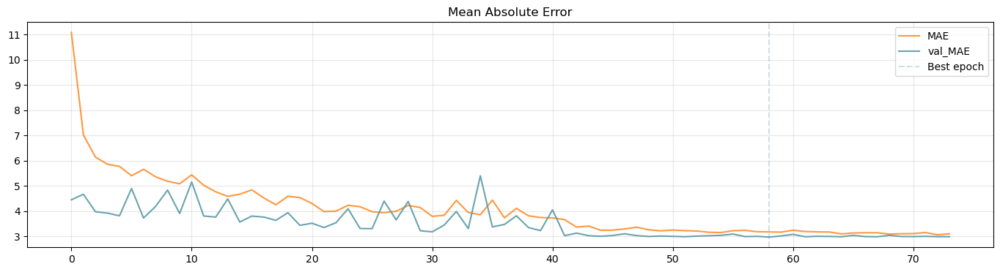

In [10]:
best_epoch = np.argmin(history['val_mae'])
plt.figure(figsize=(17,4))
plt.plot(history['mae'], label='MAE', alpha=.8, color='#ff7f0e')
plt.plot(history['val_mae'], label='val_MAE', alpha=.9, color='#5a9aa5')
plt.axvline(x=best_epoch, label='Best epoch', alpha=.3, ls='--', color='#5a9aa5')
plt.title('Mean Absolute Error')
plt.legend()
plt.grid(alpha=.3)
plt.show()

In [8]:
# ffnn = tfk.models.load_model('MODELS/base_line_(Estimation_model)_dat_aug_scale',compile=False)
# ffnn.compile(loss=tfk.losses.MeanAbsoluteError(), optimizer=tfk.optimizers.Adam(), metrics=['mae'])

# ffnn.save('MODELS/base_line_(Estimation_model)_dat_aug_scale')

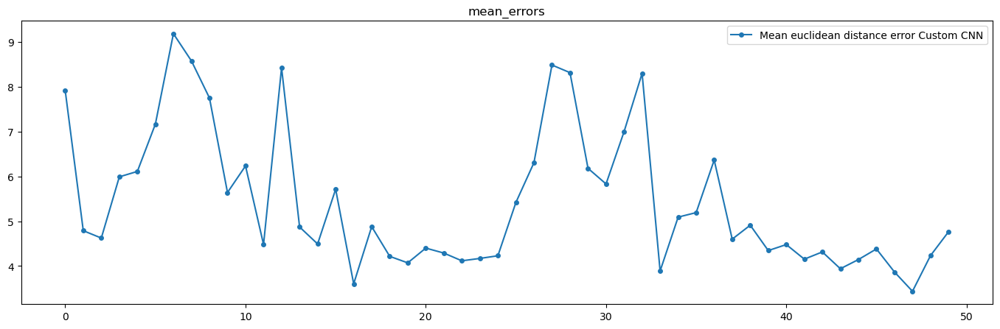

Average error of all points:  5.4368225510774755
Minimum error of all points:  3.4352204876863786  for point:  47
Maximim error of all points:  9.184246668875891  for point:  6


In [11]:
import numpy as np
import matplotlib.pyplot as plt


def calculate_error(predicted_coords, actual_coords):
    errors = np.sqrt(np.sum((predicted_coords - actual_coords) ** 2, axis=1))
    return errors



all_error=[]
predictions = ffnn.predict(X_test, verbose=0)
predictions = fix_precition(X_test, predictions)
# predictions = fix_precition_new(X_test, predictions)


# y_test = y_test * alpha
# predictions = predictions * alpha

for i in range(len(predictions)):
    errors = calculate_error(predictions[i], y_test[i])
    all_error.append(errors)

all_error = np.array(all_error).transpose()
mean_errors=[]

for i in range(len(all_error)):
    mean_errors.append(all_error[i].mean())

plt.figure(figsize=(17,5))
plt.plot(mean_errors,  marker='o', markersize=4, linestyle='-',label = "Mean euclidean distance error Custom CNN")
plt.title('mean_errors')
plt.legend()
plt.show()
print("Average error of all points: " , np.array(mean_errors).mean())
print("Minimum error of all points: " , np.array(mean_errors).min(), " for point: " , mean_errors.index(np.array(mean_errors).min()))
print("Maximim error of all points: " , np.array(mean_errors).max(), " for point: " , mean_errors.index(np.array(mean_errors).max()))

# print("minimu error of all points: " , np.array(mean_errors).mean())



In [ ]:
print("Average error of all points: " , np.array(mean_errors).mean()*alpha)

Average error of all points:  4.923960593018544


27.361133590324258


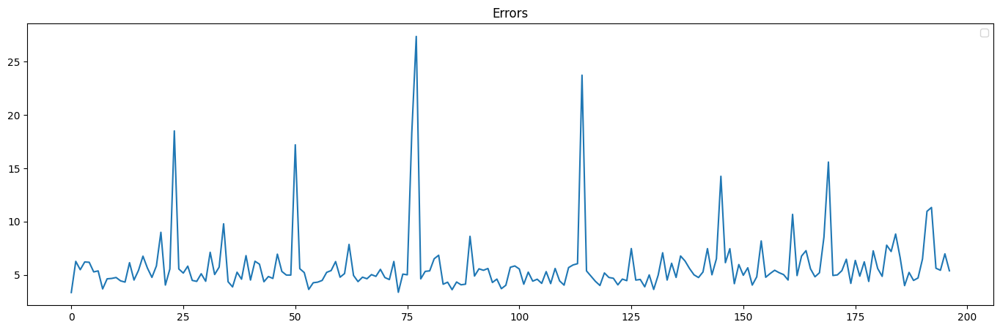

In [ ]:
all_faces = []
for i in range(len(X)):
    face_num = i
    face=[]
    face.append(X[face_num])
    face = np.array(face)
    predictions = ffnn.predict(face, verbose=0)
    predictions
    # predictions = predictions.reshape(50,3)
    predictions.shape
    y[face_num].shape
    # predictions[0].shape

    import math
    actual_ = y[face_num]
    predicted_ = predictions[0]


    def euclidean_distance(coord1, coord2):
        if len(coord1) != 3 or len(coord2) != 3:
            raise ValueError("Coordinates must be 3D (x, y, z)")

        squared_sum = sum((coord1[i] - coord2[i])**2 for i in range(3))
        distance = math.sqrt(squared_sum)
        return distance


    errors=[]
    for i in range(len(actual_)):
        # actual_set = set(actual_[i])
        # predicted_set = set(predicted_[i])
        errors.append(euclidean_distance(actual_[i], predicted_[i]))

    all_faces.append(np.array(errors).mean())

all_faces = np.array(all_faces)
# print(np.array(errors).mean())
print(max(all_faces))
plt.figure(figsize=(17,5))
plt.plot(all_faces)
plt.title('Errors')
plt.legend()
plt.show()

In [ ]:
for i in range(len(all_faces)):
    if all_faces[i]>15:
        print(i, all_faces[i])

In [ ]:
import matplotlib.pyplot as plt

# Your array of data
data = all_faces

# Plotting the histogram
plt.hist(data, bins='auto', alpha=0.7, rwidth=0.85)
plt.grid(axis='y', alpha=0.75)
plt.xlabel('Mean Ecludean Distance')
plt.ylabel('Count')
plt.title('Vertex Distribution Histogram')
plt.show()

NameError: name 'all_faces' is not defined

In [ ]:
#### X
import numpy as np
import plotly.graph_objects as go

# Assuming you have the actual landmarks stored in 'actual_landmarks'
# and the predicted landmarks stored in 'predicted_landmarks'
face_num = 195
predictions = ffnn.predict(X, verbose=0)
predictions = fix_precition(X, predictions)

# Example point cloud with 40000 points in 3D space
point_cloud = X[face_num]  # Replace with your actual face point cloud

# Example landmark coordinates for the actual and predicted landmarks
actual_landmarks = y[face_num]  # Replace with your actual landmark coordinates
predicted_landmarks = predictions[face_num]  # Replace with your predicted landmark coordinates

# Create a scatter plot for the original point cloud
scatter_original = go.Scatter3d(
    x=point_cloud[:, 0],
    y=point_cloud[:, 1],
    z=point_cloud[:, 2],
    mode='markers',
    marker=dict(size=0.5, color='blue', opacity=0.5),
    name='Point Cloud'
)

# Create a scatter plot for the actual landmarks
scatter_actual_landmarks = go.Scatter3d(
    x=actual_landmarks[:, 0],
    y=actual_landmarks[:, 1],
    z=actual_landmarks[:, 2],
    mode='markers',
    marker=dict(size=2, color='green', symbol='circle', opacity=1),
    name='Actual Landmarks'
)

# Create a scatter plot for the predicted landmarks
scatter_predicted_landmarks = go.Scatter3d(
    x=predicted_landmarks[:, 0],
    y=predicted_landmarks[:, 1],
    z=predicted_landmarks[:, 2],
    mode='markers',
    marker=dict(size=2, color='red', symbol='circle', opacity=1),
    name='Predicted Landmarks'
)

# Create the 3D figure
fig = go.Figure(data=[scatter_original, scatter_actual_landmarks, scatter_predicted_landmarks])

# Set layout options
fig.update_layout(
    scene=dict(aspectmode="data"),
    scene_camera=dict(eye=dict(x=1.25, y=1.25, z=1.25)),
    title='Point Cloud with Landmarks',
    showlegend=True
)

# Show the interactive 3D plot
fig.show()


In [ ]:
import numpy as np
import plotly.graph_objects as go

# Assuming you have the actual landmarks stored in 'actual_landmarks'
# and the predicted landmarks stored in 'predicted_landmarks'
face_num = 79
# predictions = ffnn.predict(X, verbose=0)
# predictions = fix_precition(X, predictions)

# Example point cloud with 40000 points in 3D space
point_cloud = X[face_num]  # Replace with your actual face point cloud

# Example landmark coordinates for the actual and predicted landmarks
actual_landmarks = y[face_num]  # Replace with your actual landmark coordinates3


# Create a scatter plot for the original point cloud
scatter_original = go.Scatter3d(
    x=point_cloud[:, 0],
    y=point_cloud[:, 1],
    z=point_cloud[:, 2],
    mode='markers',
    marker=dict(size=0.5, color='blue', opacity=0.5),
    name='Point Cloud'
)

# Create a scatter plot for the actual landmarks
scatter_actual_landmarks = go.Scatter3d(
    x=actual_landmarks[:, 0],
    y=actual_landmarks[:, 1],
    z=actual_landmarks[:, 2],
    mode='markers',
    marker=dict(size=2, color='green', symbol='circle', opacity=1),
    name='Actual Landmarks'
)

# # Create a scatter plot for the predicted landmarks
# scatter_predicted_landmarks = go.Scatter3d(
#     x=predicted_landmarks[:, 0],
#     y=predicted_landmarks[:, 1],
#     z=predicted_landmarks[:, 2],
#     mode='markers',
#     marker=dict(size=2, color='red', symbol='circle', opacity=1),
#     name='Predicted Landmarks'
# )

# Create the 3D figure
# fig = go.Figure(data=[scatter_original, scatter_actual_landmarks, scatter_predicted_landmarks])
fig = go.Figure(data=[scatter_original, scatter_actual_landmarks])

# Set layout options
fig.update_layout(
    scene=dict(aspectmode="data"),
    scene_camera=dict(eye=dict(x=1.25, y=1.25, z=1.25)),
    title='Point Cloud with Landmarks',
    showlegend=True
)

# Show the interactive 3D plot
fig.show()


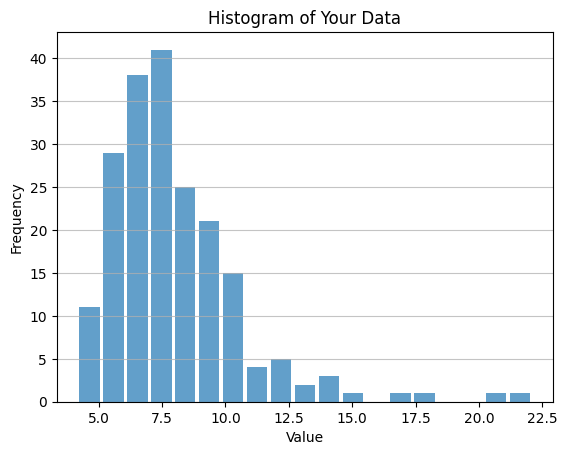

In [ ]:
import matplotlib.pyplot as plt

# Your array of data
data = all_faces

# Plotting the histogram
plt.hist(data, bins='auto', alpha=0.7, rwidth=0.85)
plt.grid(axis='y', alpha=0.75)
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.title('Histogram of Your Data')
plt.show()

In [ ]:
  face_num= 40
# Example usage
coordinates = [
        X[face_num],
        y[face_num],
        # predictions
        # X[0],
        # y_test[5],
        # y_test[18],
        # faces_aligned[69],
        # landmark_aligned[69]
]
colors = [
          # (1, 1, 1)
          (0, 0, 1), #Blue
          (0, 1, 0), #green
          (1, 0, 0)    #Red
          ]  # Black for the first set, red for the second set

scale_factor = [ 0.3 ,
                1,
                  1,
                #   1
                ]


visualize_3d_coordinates(coordinates, colors, scale_factor)

## Custom PointNet Model

In [6]:
input_shape = X_train.shape[1:]
output_shape = y_train.shape[1:]
output_shape

(50, 3)

In [7]:
def conv_block(x, filters, name):
    x = layers.Conv1D(filters, kernel_size=1, kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed), padding="valid", name=f"{name}_conv")(x)
    x = layers.BatchNormalization(name=f"{name}_batch_norm")(x)
    return layers.Activation("relu", name=f"{name}_relu")(x)


def mlp_block(x, filters, name):
    x = layers.Dense(filters,kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed), name=f"{name}_dense")(x)
    x = layers.BatchNormalization(name=f"{name}_batch_norm")(x)
    return layers.Activation("relu", name=f"{name}_relu")(x)


class OrthogonalRegularizer(keras.regularizers.Regularizer):
    """Reference: https://keras.io/examples/vision/pointnet/#build-a-model"""

    def __init__(self, num_features, l2reg=0.001):
        self.num_features = num_features
        self.l2reg = l2reg
        self.identity = tf.eye(num_features)

    def __call__(self, x):
        x = tf.reshape(x, (-1, self.num_features, self.num_features))
        xxt = tf.tensordot(x, x, axes=(2, 2))
        xxt = tf.reshape(xxt, (-1, self.num_features, self.num_features))
        return tf.reduce_sum(self.l2reg * tf.square(xxt - self.identity))

    # def get_config(self):
    #     config = super(OrthogonalRegularizer, self).get_config()
    #     config.update({"num_features": self.num_features, "l2reg_strength": self.l2reg})
    #     return config



def transformation_net(inputs, num_features, name):
    """
    Reference: https://keras.io/examples/vision/pointnet/#build-a-model.

    The `filters` values come from the original paper:
    https://arxiv.org/abs/1612.00593.
    """
    x = conv_block(inputs, filters=64, name=f"{name}_1")
    x = conv_block(x, filters=128, name=f"{name}_2")
    x = conv_block(x, filters=1024, name=f"{name}_3")
    x = layers.GlobalMaxPooling1D()(x)
    x = mlp_block(x, filters=512, name=f"{name}_1_1")
    x = mlp_block(x, filters=256, name=f"{name}_2_1")
    return layers.Dense(
        num_features * num_features,
        kernel_initializer="zeros",
        bias_initializer=keras.initializers.Constant(np.eye(num_features).flatten()),
        activity_regularizer=OrthogonalRegularizer(num_features),
        name=f"{name}_final",
    )(x)


def transformation_block(inputs, num_features, name):
    transformed_features = transformation_net(inputs, num_features, name=name)
    transformed_features = layers.Reshape((num_features, num_features))(
        transformed_features
    )
    return layers.Dot(axes=(2, 1), name=f"{name}_mm")([inputs, transformed_features])

In [10]:


# def concat_transformation_block(inputs, num_features, name):
#     # Extract 3D coordinates (first three values)
#     coords = inputs[:, :, :3]

#     # Apply the transformation block to the 3D coordinates
#     transformed_coords = transformation_block(coords, num_features, name=name)

#     # Concatenate transformed 3D coordinates with the original vector normals
#     concatenated_data = tf.concat([transformed_coords, inputs[:, :, 3:]], axis=-1)

#     return concatenated_data



def build_ffnn(input_shape, output_shape):
    # Build the neural network layer by layer
    input_layer = tfkl.Input(shape=input_shape, name='Input')
    x = input_layer



    # Use concat_transformation_block instead of transformation_block
    # x = concat_transformation_block(x, num_features=input_shape[1]//2, name="input_transformation_block")


    x = transformation_block( x, num_features= input_shape[1], name="input_transformation_block")

# ###############################################################################################  poitwise
    x = tfkl.Conv1D(filters=32, kernel_size=1, activation='relu', kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed),padding='same' )(x)
    x = tfkl.Conv1D(filters=32, kernel_size=1, activation='relu', kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed),padding='same' )(x)
    x = tfkl.MaxPooling1D(pool_size=4)(x)

    x = tfkl.Conv1D(filters=64, kernel_size=1, activation='relu', kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed),padding='same')(x)
    x = tfkl.Conv1D(filters=64, kernel_size=1, activation='relu', kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed),padding='same')(x)
    x = tfkl.MaxPooling1D(pool_size=5)(x)

    x = tfkl.Conv1D(filters=128, kernel_size=1, activation='relu', kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed),padding='same')(x)
    x = tfkl.Conv1D(filters=128, kernel_size=1, activation='relu', kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed),padding='same')(x)
    x = tfkl.MaxPooling1D(pool_size=5)(x)


    x = tfkl.Conv1D(filters=256, kernel_size=1, activation='relu', kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed),padding='same')(x)
    x = tfkl.Conv1D(filters=256, kernel_size=1, activation='relu', kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed),padding='same')(x)
    x = tfkl.MaxPooling1D(pool_size=4)(x)


# ###############################################################################################  poitwise


    # x = tfkl.GlobalAveragePooling1D()(x)
    x = tfkl.Flatten()(x)
    x = tfkl.Dense(units=1024, activation='relu', kernel_initializer=tfk.initializers.GlorotNormal(seed=seed))(x)
    x = tfkl.Dropout(0.1)(x)
    x = tfkl.Dense(units=output_shape[0] *output_shape[1], activation='linear',  kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed))(x)
    x = tfkl.Reshape(output_shape)(x)
    output_layer = x

    # Connect input and output through the Model class
    model = tfk.Model(inputs=input_layer, outputs=output_layer, name='FFNN')

    # Compile the model
    model.compile(loss=tfk.losses.MeanAbsoluteError(), optimizer=tfk.optimizers.Adam(), metrics=['mae'])

    # Return the model
    return model



In [11]:
ffnn_pointNet = build_ffnn(input_shape ,output_shape)
ffnn_pointNet.summary()
# tfk.utils.plot_model(ffnn_pointNet)

Model: "FFNN"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 Input (InputLayer)          [(None, 41000, 3)]           0         []                            
                                                                                                  
 input_transformation_block  (None, 41000, 64)            256       ['Input[0][0]']               
 _1_conv (Conv1D)                                                                                 
                                                                                                  
 input_transformation_block  (None, 41000, 64)            256       ['input_transformation_block_1
 _1_batch_norm (BatchNormal                                         _conv[0][0]']                 
 ization)                                                                                      

In [16]:
# Train the model
history = ffnn_pointNet.fit(
    x = X_train,
    y = y_train,
    batch_size = 24,
    epochs = 5000,
    validation_data=(X_test, y_test),
    callbacks = [
        tfk.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=15, restore_best_weights=True),
        tfk.callbacks.ReduceLROnPlateau(monitor='val_loss', mode='min', patience=8, factor=0.1, min_lr=1e-15)
    ]
).history

Epoch 1/5000


ResourceExhaustedError: Graph execution error:

Detected at node FFNN/input_transformation_block_3_conv/Conv1D-0-0-TransposeNCHWToNHWC-LayoutOptimizer defined at (most recent call last):
<stack traces unavailable>
OOM when allocating tensor with shape[24,1,41000,1024] and type float on /job:localhost/replica:0/task:0/device:GPU:0 by allocator GPU_0_bfc
	 [[{{node FFNN/input_transformation_block_3_conv/Conv1D-0-0-TransposeNCHWToNHWC-LayoutOptimizer}}]]
Hint: If you want to see a list of allocated tensors when OOM happens, add report_tensor_allocations_upon_oom to RunOptions for current allocation info. This isn't available when running in Eager mode.
 [Op:__inference_train_function_6422]

In [ ]:
best_epoch = np.argmin(history['val_mae'])
plt.figure(figsize=(17,4))
plt.plot(history['mae'], label='MAE', alpha=.8, color='#ff7f0e')
plt.plot(history['val_mae'], label='val_MAE', alpha=.9, color='#5a9aa5')
plt.axvline(x=best_epoch, label='Best epoch', alpha=.3, ls='--', color='#5a9aa5')
plt.title('Mean Absolute Error')
plt.legend()
plt.grid(alpha=.3)
plt.show()

In [ ]:
# ffnn = tfk.models.load_model('best_model',compile=False)
# ffnn.compile(loss=tfk.losses.MeanAbsoluteError(), optimizer=tfk.optimizers.Adam(), metrics=['mae'])
# ffnn_pointNet.save('MODELS/base_line_(EsTi_model)')

# Save the model in HDF5 format
# Save weights
# ffnn_pointNet.save_weights('MODELS/base_line_(EsTi_model)_weights_w_normals.h5')
# ffnn_pointNet.save_weights('MODELS/TEST.h5')


# # Create a new model with the same architecture
ffnn_pointNet_loaded = build_ffnn(input_shape, output_shape)

# # Load the saved weights
# ffnn_pointNet_loaded.load_weights('MODELS/base_line_(EsTi_model)_weights.h5')
ffnn_pointNet_loaded.load_weights('MODELS/base_line_(EsTi_model)_weights_w_normals.h5')
# ffnn_pointNet_loaded.load_weights('MODELS/TEST.h5')



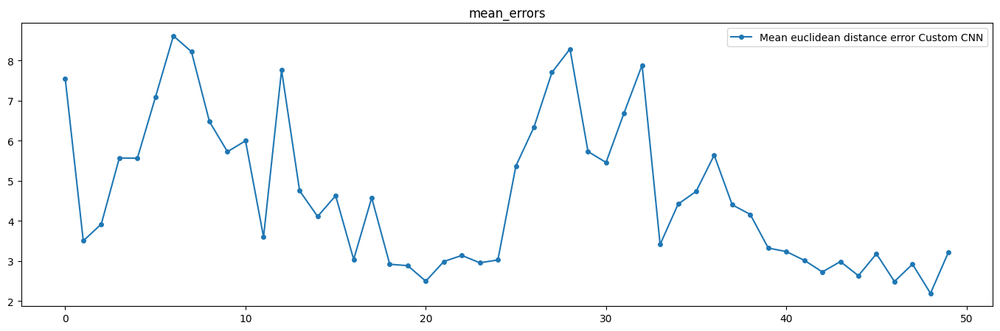

Average error of all points:  4.667897635615427
Minimum error of all points:  2.1958746589172016  for point:  48
Maximim error of all points:  8.61838769553961  for point:  6


In [ ]:
import numpy as np
import matplotlib.pyplot as plt


def calculate_error(predicted_coords, actual_coords):
    errors = np.sqrt(np.sum((predicted_coords - actual_coords) ** 2, axis=1))
    return errors



all_error=[]
predictions = ffnn_pointNet_loaded.predict(X_test, verbose=0)
predictions = fix_precition(X_test, predictions)
# predictions = fix_precition_new(X_test, predictions)


# y_test = y_test * alpha
# predictions = predictions * alpha

for i in range(len(predictions)):
    errors = calculate_error(predictions[i], y_test[i])
    all_error.append(errors)

all_error = np.array(all_error).transpose()
mean_errors=[]

for i in range(len(all_error)):
    mean_errors.append(all_error[i].mean())

plt.figure(figsize=(17,5))
plt.plot(mean_errors,  marker='o', markersize=4, linestyle='-',label = "Mean euclidean distance error Custom CNN")
plt.title('mean_errors')
plt.legend()
plt.show()
print("Average error of all points: " , np.array(mean_errors).mean())
print("Minimum error of all points: " , np.array(mean_errors).min(), " for point: " , mean_errors.index(np.array(mean_errors).min()))
print("Maximim error of all points: " , np.array(mean_errors).max(), " for point: " , mean_errors.index(np.array(mean_errors).max()))

# print("minimu error of all points: " , np.array(mean_errors).mean())



In [ ]:
# np.save('error_41k_rigid_aug.npy', mean_errors)

13.918178084907687


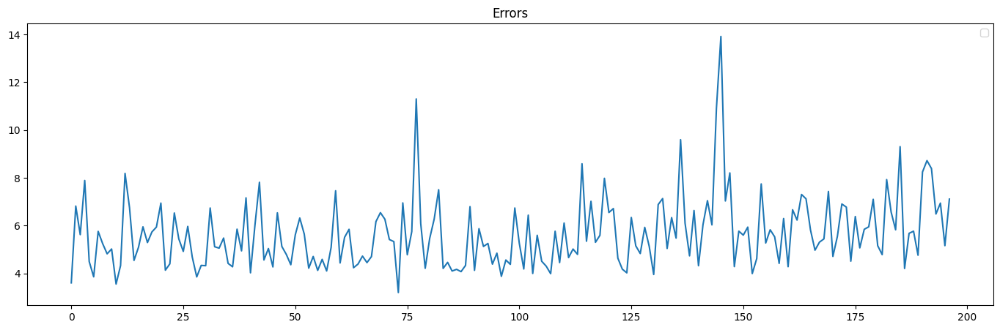

In [ ]:
all_faces = []
for i in range(len(X)):
    face_num = i
    face=[]
    face.append(X[face_num])
    face = np.array(face)
    predictions = ffnn.predict(face, verbose=0)
    predictions
    # predictions = predictions.reshape(50,3)
    predictions.shape
    y[face_num].shape
    # predictions[0].shape

    import math
    actual_ = y[face_num]
    predicted_ = predictions[0]


    def euclidean_distance(coord1, coord2):
        if len(coord1) != 3 or len(coord2) != 3:
            raise ValueError("Coordinates must be 3D (x, y, z)")

        squared_sum = sum((coord1[i] - coord2[i])**2 for i in range(3))
        distance = math.sqrt(squared_sum)
        return distance


    errors=[]
    for i in range(len(actual_)):
        # actual_set = set(actual_[i])
        # predicted_set = set(predicted_[i])
        errors.append(euclidean_distance(actual_[i], predicted_[i]))

    all_faces.append(np.array(errors).mean())

all_faces = np.array(all_faces)
# print(np.array(errors).mean())
print(max(all_faces))
plt.figure(figsize=(17,5))
plt.plot(all_faces)
plt.title('Errors')
plt.legend()
plt.show()

In [ ]:
for i in range(len(all_faces)):
    if all_faces[i]>15:
        print(i, all_faces[i])

In [ ]:
import matplotlib.pyplot as plt

# Your array of data
data = all_faces

# Plotting the histogram
plt.hist(data, bins='auto', alpha=0.7, rwidth=0.85)
plt.grid(axis='y', alpha=0.75)
plt.xlabel('Mean Ecludean Distance')
plt.ylabel('Count')
plt.title('Vertex Distribution Histogram')
plt.show()

NameError: name 'all_faces' is not defined

In [ ]:
#### X
import numpy as np
import plotly.graph_objects as go

# Assuming you have the actual landmarks stored in 'actual_landmarks'
# and the predicted landmarks stored in 'predicted_landmarks'
face_num = 195
predictions = ffnn.predict(X, verbose=0)
predictions = fix_precition(X, predictions)

# Example point cloud with 40000 points in 3D space
point_cloud = X[face_num]  # Replace with your actual face point cloud

# Example landmark coordinates for the actual and predicted landmarks
actual_landmarks = y[face_num]  # Replace with your actual landmark coordinates
predicted_landmarks = predictions[face_num]  # Replace with your predicted landmark coordinates

# Create a scatter plot for the original point cloud
scatter_original = go.Scatter3d(
    x=point_cloud[:, 0],
    y=point_cloud[:, 1],
    z=point_cloud[:, 2],
    mode='markers',
    marker=dict(size=0.5, color='blue', opacity=0.5),
    name='Point Cloud'
)

# Create a scatter plot for the actual landmarks
scatter_actual_landmarks = go.Scatter3d(
    x=actual_landmarks[:, 0],
    y=actual_landmarks[:, 1],
    z=actual_landmarks[:, 2],
    mode='markers',
    marker=dict(size=2, color='green', symbol='circle', opacity=1),
    name='Actual Landmarks'
)

# Create a scatter plot for the predicted landmarks
scatter_predicted_landmarks = go.Scatter3d(
    x=predicted_landmarks[:, 0],
    y=predicted_landmarks[:, 1],
    z=predicted_landmarks[:, 2],
    mode='markers',
    marker=dict(size=2, color='red', symbol='circle', opacity=1),
    name='Predicted Landmarks'
)

# Create the 3D figure
fig = go.Figure(data=[scatter_original, scatter_actual_landmarks, scatter_predicted_landmarks])

# Set layout options
fig.update_layout(
    scene=dict(aspectmode="data"),
    scene_camera=dict(eye=dict(x=1.25, y=1.25, z=1.25)),
    title='Point Cloud with Landmarks',
    showlegend=True
)

# Show the interactive 3D plot
fig.show()


In [ ]:
import numpy as np
import plotly.graph_objects as go

# Assuming you have the actual landmarks stored in 'actual_landmarks'
# and the predicted landmarks stored in 'predicted_landmarks'
face_num = 79
# predictions = ffnn.predict(X, verbose=0)
# predictions = fix_precition(X, predictions)

# Example point cloud with 40000 points in 3D space
point_cloud = X[face_num]  # Replace with your actual face point cloud

# Example landmark coordinates for the actual and predicted landmarks
actual_landmarks = y[face_num]  # Replace with your actual landmark coordinates3


# Create a scatter plot for the original point cloud
scatter_original = go.Scatter3d(
    x=point_cloud[:, 0],
    y=point_cloud[:, 1],
    z=point_cloud[:, 2],
    mode='markers',
    marker=dict(size=0.5, color='blue', opacity=0.5),
    name='Point Cloud'
)

# Create a scatter plot for the actual landmarks
scatter_actual_landmarks = go.Scatter3d(
    x=actual_landmarks[:, 0],
    y=actual_landmarks[:, 1],
    z=actual_landmarks[:, 2],
    mode='markers',
    marker=dict(size=2, color='green', symbol='circle', opacity=1),
    name='Actual Landmarks'
)

# # Create a scatter plot for the predicted landmarks
# scatter_predicted_landmarks = go.Scatter3d(
#     x=predicted_landmarks[:, 0],
#     y=predicted_landmarks[:, 1],
#     z=predicted_landmarks[:, 2],
#     mode='markers',
#     marker=dict(size=2, color='red', symbol='circle', opacity=1),
#     name='Predicted Landmarks'
# )

# Create the 3D figure
# fig = go.Figure(data=[scatter_original, scatter_actual_landmarks, scatter_predicted_landmarks])
fig = go.Figure(data=[scatter_original, scatter_actual_landmarks])

# Set layout options
fig.update_layout(
    scene=dict(aspectmode="data"),
    scene_camera=dict(eye=dict(x=1.25, y=1.25, z=1.25)),
    title='Point Cloud with Landmarks',
    showlegend=True
)

# Show the interactive 3D plot
fig.show()


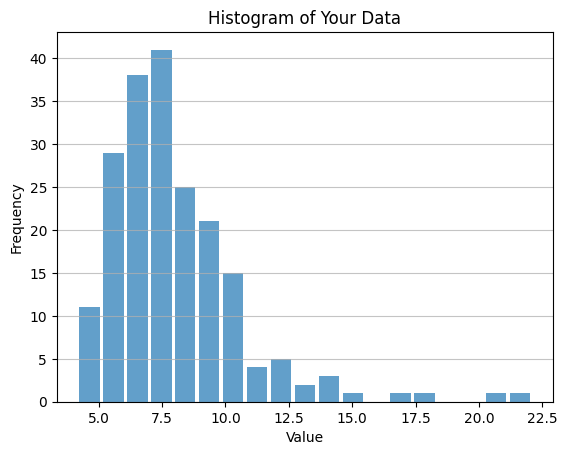

In [ ]:
import matplotlib.pyplot as plt

# Your array of data
data = all_faces

# Plotting the histogram
plt.hist(data, bins='auto', alpha=0.7, rwidth=0.85)
plt.grid(axis='y', alpha=0.75)
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.title('Histogram of Your Data')
plt.show()

In [ ]:
  face_num= 40
# Example usage
coordinates = [
        X[face_num],
        y[face_num],
        # predictions
        # X[0],
        # y_test[5],
        # y_test[18],
        # faces_aligned[69],
        # landmark_aligned[69]
]
colors = [
          # (1, 1, 1)
          (0, 0, 1), #Blue
          (0, 1, 0), #green
          (1, 0, 0)    #Red
          ]  # Black for the first set, red for the second set

scale_factor = [ 0.3 ,
                1,
                  1,
                #   1
                ]


visualize_3d_coordinates(coordinates, colors, scale_factor)

## ResNet Model

In [ ]:
input_shape = X_train.shape[1:]
output_shape = y_train.shape[1:]
output_shape

(50, 3)

In [ ]:
from keras.layers import Input, Conv1D, BatchNormalization, Activation, Add, GlobalAveragePooling1D, Dense
from keras.models import Model

def identity_block(input_tensor, filters, kernel_size=3, stride=1):
    filters1, filters2, filters3 = filters

    x = Conv1D(filters1, 1, strides=stride, padding='same')(input_tensor)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv1D(filters2, kernel_size, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv1D(filters3, 1, padding='same')(x)
    x = BatchNormalization()(x)

    x = Add()([x, input_tensor])
    x = Activation('relu')(x)

    return x

def conv_block(input_tensor, filters, kernel_size=3, stride=1):
    filters1, filters2, filters3 = filters

    shortcut = Conv1D(filters3, 1, strides=stride, padding='same')(input_tensor)
    shortcut = BatchNormalization()(shortcut)

    x = Conv1D(filters1, 1, strides=stride, padding='same')(input_tensor)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv1D(filters2, kernel_size, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv1D(filters3, 1, padding='same')(x)
    x = BatchNormalization()(x)

    x = Add()([x, shortcut])
    x = Activation('relu')(x)

    return x

def build_ResNet50(input_shape, output_shape):
    input_tensor = Input(shape=input_shape)

    x = Conv1D(64, 7, strides=2, padding='same')(input_tensor)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = conv_block(x, [64, 64, 256], stride=1)
    x = identity_block(x, [64, 64, 256])
    x = identity_block(x, [64, 64, 256])

    x = conv_block(x, [128, 128, 512], stride=2)
    x = identity_block(x, [128, 128, 512])
    x = identity_block(x, [128, 128, 512])
    x = identity_block(x, [128, 128, 512])

    # x = conv_block(x, [256, 256, 1024], stride=2)
    # x = identity_block(x, [256, 256, 1024])
    # x = identity_block(x, [256, 256, 1024])
    # x = identity_block(x, [256, 256, 1024])
    # x = identity_block(x, [256, 256, 1024])
    # x = identity_block(x, [256, 256, 1024])

    # x = conv_block(x, [512, 512, 2048], stride=2)
    # x = identity_block(x, [512, 512, 2048])
    # x = identity_block(x, [512, 512, 2048])


    x = tfkl.Flatten()(x)
    x = tfkl.Dense(units=512, activation='relu',kernel_initializer=tfk.initializers.HeUniform(seed=seed))(x)
    x = tfkl.Dense(units=400, activation='relu')(x)
    x = tfkl.Dense(units=300, activation='relu')(x)
    x = tfkl.Dropout(0.1)(x)
    x = tfkl.Dense(units=250, activation='relu')(x)
    # x = tfkl.Dense(units=150, activation='linear')(x)
    x = tfkl.Dense(units=output_shape[0] *output_shape[1], activation='linear')(x)
    output_layer = x

    model = tfk.Model(inputs=input_tensor, outputs=output_layer, name='ResNet50')
    model.compile(loss=tfk.losses.MeanAbsoluteError(), optimizer=tfk.optimizers.Adam(), metrics=['mae'])

    return model




In [ ]:
ResNet50 = build_ResNet50(input_shape ,output_shape)
ResNet50.summary()
# tfk.utils.plot_model(ResNet50)

ResourceExhaustedError: {{function_node __wrapped__StatelessRandomUniformV2_device_/job:localhost/replica:0/task:0/device:GPU:0}} OOM when allocating tensor with shape[5248000,512] and type float on /job:localhost/replica:0/task:0/device:GPU:0 by allocator GPU_0_bfc [Op:StatelessRandomUniformV2] name: 

In [ ]:
# Train the model
history = ffnn.fit(
    x = X_train,
    y = y_train,
    batch_size = 10,
    epochs = 5000,
    validation_data=(X_test, y_test),
    callbacks = [
        tfk.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=25, restore_best_weights=True),
        tfk.callbacks.ReduceLROnPlateau(monitor='val_loss', mode='min', patience=10, factor=0.1, min_lr=1e-15)
    ]
).history

Epoch 1/5000
16/16 [==============================] - 12s 146ms/step - loss: 0.1022 - mae: 0.1022 - val_loss: 0.0393 - val_mae: 0.0393 - lr: 0.0010
Epoch 2/5000
16/16 [==============================] - 1s 65ms/step - loss: 0.0426 - mae: 0.0426 - val_loss: 0.0297 - val_mae: 0.0297 - lr: 0.0010
Epoch 3/5000
16/16 [==============================] - 1s 60ms/step - loss: 0.0324 - mae: 0.0324 - val_loss: 0.0253 - val_mae: 0.0253 - lr: 0.0010
Epoch 4/5000
16/16 [==============================] - 1s 61ms/step - loss: 0.0300 - mae: 0.0300 - val_loss: 0.0245 - val_mae: 0.0245 - lr: 0.0010
Epoch 5/5000
16/16 [==============================] - 1s 58ms/step - loss: 0.0323 - mae: 0.0323 - val_loss: 0.0337 - val_mae: 0.0337 - lr: 0.0010
Epoch 6/5000
16/16 [==============================] - 1s 62ms/step - loss: 0.0336 - mae: 0.0336 - val_loss: 0.0329 - val_mae: 0.0329 - lr: 0.0010
Epoch 7/5000
16/16 [==============================] - 1s 61ms/step - loss: 0.0284 - mae: 0.0284 - val_loss: 0.0265 - val_m

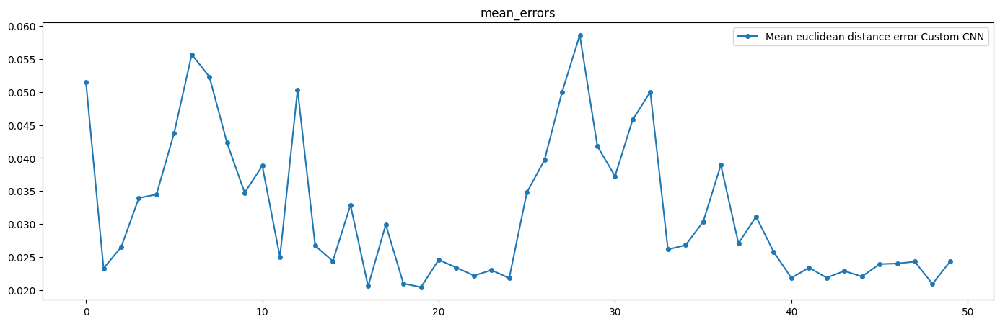

Average error of all points:  0.03193395013474072
Minimum error of all points:  0.02042686092692046  for point:  19
Maximim error of all points:  0.05860899039682379  for point:  28


In [ ]:
import numpy as np
import matplotlib.pyplot as plt


def calculate_error(predicted_coords, actual_coords):
    errors = np.sqrt(np.sum((predicted_coords - actual_coords) ** 2, axis=1))
    return errors



all_error=[]
predictions = ffnn.predict(X_test, verbose=0)
predictions = fix_precition(X_test, predictions)
# predictions = fix_precition_new(X_test, predictions)


# y_test = y_test * alpha
# predictions = predictions * alpha

for i in range(len(predictions)):
    errors = calculate_error(predictions[i], y_test[i])
    all_error.append(errors)

all_error = np.array(all_error).transpose()
mean_errors=[]

for i in range(len(all_error)):
    mean_errors.append(all_error[i].mean())

plt.figure(figsize=(17,5))
plt.plot(mean_errors,  marker='o', markersize=4, linestyle='-',label = "Mean euclidean distance error Custom CNN")
plt.title('mean_errors')
plt.legend()
plt.show()
print("Average error of all points: " , np.array(mean_errors).mean())
print("Minimum error of all points: " , np.array(mean_errors).min(), " for point: " , mean_errors.index(np.array(mean_errors).min()))
print("Maximim error of all points: " , np.array(mean_errors).max(), " for point: " , mean_errors.index(np.array(mean_errors).max()))

# print("minimu error of all points: " , np.array(mean_errors).mean())



In [ ]:
# np.save('error_41k_rigid_aug.npy', mean_errors)

13.918178084907687


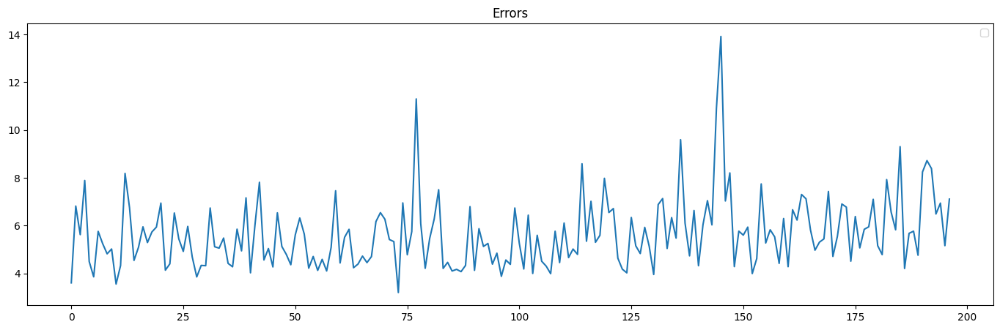

In [ ]:
all_faces = []
for i in range(len(X)):
    face_num = i
    face=[]
    face.append(X[face_num])
    face = np.array(face)
    predictions = ffnn.predict(face, verbose=0)
    predictions
    # predictions = predictions.reshape(50,3)
    predictions.shape
    y[face_num].shape
    # predictions[0].shape

    import math
    actual_ = y[face_num]
    predicted_ = predictions[0]


    def euclidean_distance(coord1, coord2):
        if len(coord1) != 3 or len(coord2) != 3:
            raise ValueError("Coordinates must be 3D (x, y, z)")

        squared_sum = sum((coord1[i] - coord2[i])**2 for i in range(3))
        distance = math.sqrt(squared_sum)
        return distance


    errors=[]
    for i in range(len(actual_)):
        # actual_set = set(actual_[i])
        # predicted_set = set(predicted_[i])
        errors.append(euclidean_distance(actual_[i], predicted_[i]))

    all_faces.append(np.array(errors).mean())

all_faces = np.array(all_faces)
# print(np.array(errors).mean())
print(max(all_faces))
plt.figure(figsize=(17,5))
plt.plot(all_faces)
plt.title('Errors')
plt.legend()
plt.show()

In [ ]:
for i in range(len(all_faces)):
    if all_faces[i]>15:
        print(i, all_faces[i])

In [ ]:
import matplotlib.pyplot as plt

# Your array of data
data = all_faces

# Plotting the histogram
plt.hist(data, bins='auto', alpha=0.7, rwidth=0.85)
plt.grid(axis='y', alpha=0.75)
plt.xlabel('Mean Ecludean Distance')
plt.ylabel('Count')
plt.title('Vertex Distribution Histogram')
plt.show()

NameError: name 'all_faces' is not defined

In [ ]:
#### X
import numpy as np
import plotly.graph_objects as go

# Assuming you have the actual landmarks stored in 'actual_landmarks'
# and the predicted landmarks stored in 'predicted_landmarks'
face_num = 195
predictions = ffnn.predict(X, verbose=0)
predictions = fix_precition(X, predictions)

# Example point cloud with 40000 points in 3D space
point_cloud = X[face_num]  # Replace with your actual face point cloud

# Example landmark coordinates for the actual and predicted landmarks
actual_landmarks = y[face_num]  # Replace with your actual landmark coordinates
predicted_landmarks = predictions[face_num]  # Replace with your predicted landmark coordinates

# Create a scatter plot for the original point cloud
scatter_original = go.Scatter3d(
    x=point_cloud[:, 0],
    y=point_cloud[:, 1],
    z=point_cloud[:, 2],
    mode='markers',
    marker=dict(size=0.5, color='blue', opacity=0.5),
    name='Point Cloud'
)

# Create a scatter plot for the actual landmarks
scatter_actual_landmarks = go.Scatter3d(
    x=actual_landmarks[:, 0],
    y=actual_landmarks[:, 1],
    z=actual_landmarks[:, 2],
    mode='markers',
    marker=dict(size=2, color='green', symbol='circle', opacity=1),
    name='Actual Landmarks'
)

# Create a scatter plot for the predicted landmarks
scatter_predicted_landmarks = go.Scatter3d(
    x=predicted_landmarks[:, 0],
    y=predicted_landmarks[:, 1],
    z=predicted_landmarks[:, 2],
    mode='markers',
    marker=dict(size=2, color='red', symbol='circle', opacity=1),
    name='Predicted Landmarks'
)

# Create the 3D figure
fig = go.Figure(data=[scatter_original, scatter_actual_landmarks, scatter_predicted_landmarks])

# Set layout options
fig.update_layout(
    scene=dict(aspectmode="data"),
    scene_camera=dict(eye=dict(x=1.25, y=1.25, z=1.25)),
    title='Point Cloud with Landmarks',
    showlegend=True
)

# Show the interactive 3D plot
fig.show()


In [ ]:
import numpy as np
import plotly.graph_objects as go

# Assuming you have the actual landmarks stored in 'actual_landmarks'
# and the predicted landmarks stored in 'predicted_landmarks'
face_num = 79
# predictions = ffnn.predict(X, verbose=0)
# predictions = fix_precition(X, predictions)

# Example point cloud with 40000 points in 3D space
point_cloud = X[face_num]  # Replace with your actual face point cloud

# Example landmark coordinates for the actual and predicted landmarks
actual_landmarks = y[face_num]  # Replace with your actual landmark coordinates3


# Create a scatter plot for the original point cloud
scatter_original = go.Scatter3d(
    x=point_cloud[:, 0],
    y=point_cloud[:, 1],
    z=point_cloud[:, 2],
    mode='markers',
    marker=dict(size=0.5, color='blue', opacity=0.5),
    name='Point Cloud'
)

# Create a scatter plot for the actual landmarks
scatter_actual_landmarks = go.Scatter3d(
    x=actual_landmarks[:, 0],
    y=actual_landmarks[:, 1],
    z=actual_landmarks[:, 2],
    mode='markers',
    marker=dict(size=2, color='green', symbol='circle', opacity=1),
    name='Actual Landmarks'
)

# # Create a scatter plot for the predicted landmarks
# scatter_predicted_landmarks = go.Scatter3d(
#     x=predicted_landmarks[:, 0],
#     y=predicted_landmarks[:, 1],
#     z=predicted_landmarks[:, 2],
#     mode='markers',
#     marker=dict(size=2, color='red', symbol='circle', opacity=1),
#     name='Predicted Landmarks'
# )

# Create the 3D figure
# fig = go.Figure(data=[scatter_original, scatter_actual_landmarks, scatter_predicted_landmarks])
fig = go.Figure(data=[scatter_original, scatter_actual_landmarks])

# Set layout options
fig.update_layout(
    scene=dict(aspectmode="data"),
    scene_camera=dict(eye=dict(x=1.25, y=1.25, z=1.25)),
    title='Point Cloud with Landmarks',
    showlegend=True
)

# Show the interactive 3D plot
fig.show()


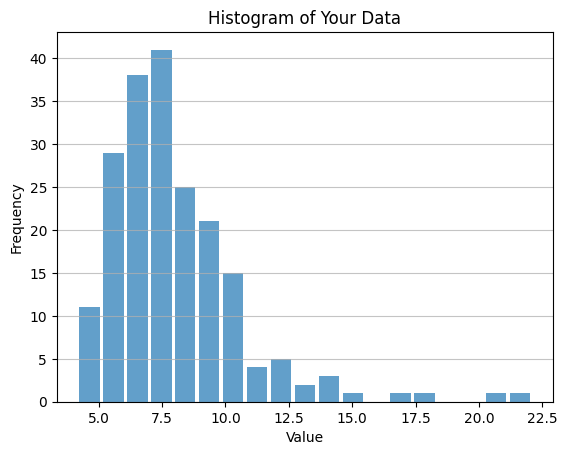

In [ ]:
import matplotlib.pyplot as plt

# Your array of data
data = all_faces

# Plotting the histogram
plt.hist(data, bins='auto', alpha=0.7, rwidth=0.85)
plt.grid(axis='y', alpha=0.75)
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.title('Histogram of Your Data')
plt.show()

In [ ]:
  face_num= 40
# Example usage
coordinates = [
        X[face_num],
        y[face_num],
        # predictions
        # X[0],
        # y_test[5],
        # y_test[18],
        # faces_aligned[69],
        # landmark_aligned[69]
]
colors = [
          # (1, 1, 1)
          (0, 0, 1), #Blue
          (0, 1, 0), #green
          (1, 0, 0)    #Red
          ]  # Black for the first set, red for the second set

scale_factor = [ 0.3 ,
                1,
                  1,
                #   1
                ]


visualize_3d_coordinates(coordinates, colors, scale_factor)

## Custom Model point cloud

In [ ]:
input_shape_pc = X_train_pc.shape[1:]
input_shape_image = X_train_image.shape[1:]
output_shape = y_train.shape[1:]
output_shape

NameError: ignored

In [ ]:
# Download and plot the VGG16 model
supernet = tfk.applications.VGG16(
    include_top=False,
    weights="imagenet",
    input_shape=input_shape_image
)

# supernet.summary()
# tfk.utils.plot_model(supernet)

In [ ]:
##### trail image + pc
def build_ffnn(input_shape_pc, input_shape_image, output_shape):

  supernet.trainable = True


  input_pc     = tfkl.Input(shape=input_shape_pc, name='Input_pc')
  inputs_image = tfkl.Input(shape=input_shape_image, name='Input_image')

  x_pc = input_pc
  x_image = inputs_image


  ##############################################################################################  Image
  x_image = supernet(x_image)
  x_image = tfkl.Flatten(name='Flattening')(x_image)
  x_image = tfkl.Dense(units=1500, activation='relu')(x_image)


##############################################################################################  poitwise

  x_pc = tfkl.Conv1D(filters=50, kernel_size=1, activation='relu',padding='same' )(x_pc)
  x_pc = tfkl.MaxPooling1D(pool_size=4)(x_pc)


  x_pc = tfkl.Conv1D(filters=200, kernel_size=1, activation='relu',padding='same')(x_pc)
  x_pc = tfkl.Conv1D(filters=100, kernel_size=1, activation='relu',padding='same')(x_pc)
  x_pc = tfkl.MaxPooling1D(pool_size=5)(x_pc)

  x_pc = tfkl.Conv1D(filters=200, kernel_size=1, activation='relu',padding='same')(x_pc)
  x_pc = tfkl.MaxPooling1D(pool_size=5)(x_pc)

  x_pc = tfkl.Conv1D(filters=100, kernel_size=1, activation='relu',padding='same')(x_pc)
  x_pc = tfkl.MaxPooling1D(pool_size=2)(x_pc)
  x_pc = tfkl.Flatten()(x_pc)
  x_pc = tfkl.Dense(units=1500, activation='relu')(x_pc)




  # x = tfkl.GlobalAveragePooling1D()(x)
  # x = tfkl.Flatten()(x)
  # x = tfkl.Concatenate(axis = 1)([x_pc, x_image])
  x = tf.stack([x_pc, x_image], axis=1)

  x = tfkl.Conv1D(filters=1000, kernel_size=1, activation='relu',padding='same')(x)
  x = tfkl.Conv1D(filters=512, kernel_size=1, activation='relu',padding='same')(x)
  x = tfkl.MaxPooling1D(pool_size=2)(x)
  # x = tfkl.Flatten()(x)
  x = tfkl.Dense(units=512, activation='relu',kernel_initializer=tfk.initializers.HeUniform(seed=seed))(x)
  x = tfkl.Dense(units=400, activation='relu')(x)
  x = tfkl.Dense(units=300, activation='relu')(x)
  # x = tfkl.Dropout(0.3, seed=seed)(x)
  x = tfkl.Dense(units=250, activation='relu')(x)
  x = tfkl.Dense(units=150, activation='linear')(x)
  x = tfkl.Reshape(output_shape)(x)



  output_layer = x

  # Connect input and output through the Model class
  model = tfk.Model(inputs=[input_pc, inputs_image], outputs=output_layer, name='FFNN')

  # Compile the model
  # model.compile(loss=tfk.losses.MeanAbsoluteError(), optimizer=tfk.optimizers.Adam(), metrics=['mae'])
  model.compile(loss=tfk.losses.MeanSquaredError(), optimizer=tfk.optimizers.Adam(), metrics=['mse','mae'])

  # model.compile(loss=euclidean_distance_loss, optimizer=tfk.optimizers.Adam())
  # model.compile(loss=equi_loss, optimizer=tfk.optimizers.Adam())



  # Return the model
  return model


In [ ]:
# def build_ffnn(input_shape, output_shape):
#     # Build the neural network layer by layer
#     input_layer = tfkl.Input(shape=input_shape, name='Input')
#     x = input_layer


# ##############################################################################################  poitwise
#     x = tfkl.Conv1D(filters=50, kernel_size=1, activation='relu',padding='same' )(x)
#     x = tfkl.MaxPooling1D(pool_size=4)(x)


#     x = tfkl.Conv1D(filters=200, kernel_size=1, activation='relu',padding='same')(x)
#     x = tfkl.Conv1D(filters=100, kernel_size=1, activation='relu',padding='same')(x)
#     x = tfkl.MaxPooling1D(pool_size=5)(x)

#     x = tfkl.Conv1D(filters=200, kernel_size=1, activation='relu',padding='same')(x)
#     x = tfkl.MaxPooling1D(pool_size=5)(x)

#     x = tfkl.Conv1D(filters=100, kernel_size=1, activation='relu',padding='same')(x)
#     x = tfkl.MaxPooling1D(pool_size=2)(x)

# ############################################################################################### 2D poitwise

#     # x = tfkl.Conv2D(filters=50, kernel_size=(1, 1), activation='relu', padding='same')(x)
#     # x = tfkl.MaxPooling2D(pool_size=(5, 1))(x)

#     # x = tfkl.Conv2D(filters=200, kernel_size=(1, 1), activation='relu', padding='same')(x)
#     # x = tfkl.Conv2D(filters=100, kernel_size=(1, 1), activation='relu', padding='same')(x)

#     # x = tfkl.MaxPooling2D(pool_size=(5, 1))(x)

#     # x = tfkl.Conv2D(filters=200, kernel_size=(1, 1), activation='relu', padding='same')(x)
#     # x = tfkl.MaxPooling2D(pool_size=(10, 1))(x)

#     # x = tfkl.Conv2D(filters=100, kernel_size=(1, 1), activation='relu', padding='same')(x)
#     # x = tfkl.MaxPooling2D(pool_size=(2, 1))(x)

#     # x = tfkl.Conv2D(filters=3, kernel_size=(1, 1), activation='relu', padding='same')(x)
#     # x = tfkl.MaxPooling2D(pool_size=(2, 2))(x)



#     # x = tfkl.GlobalAveragePooling1D()(x)
#     x = tfkl.Flatten()(x)
#     x = tfkl.Dense(units=512, activation='relu',kernel_initializer=tfk.initializers.HeUniform(seed=seed))(x)
#     x = tfkl.Dense(units=400, activation='relu')(x)
#     x = tfkl.Dense(units=300, activation='relu')(x)
#     x = tfkl.Dense(units=250, activation='relu')(x)
#     x = tfkl.Dense(units=150, activation='linear')(x)
#     x = tfkl.Reshape(output_shape)(x)



#     output_layer = x

#     # Connect input and output through the Model class
#     model = tfk.Model(inputs=input_layer, outputs=output_layer, name='FFNN')

#     # Compile the model
#     # model.compile(loss=tfk.losses.MeanAbsoluteError(), optimizer=tfk.optimizers.Adam(), metrics=['mae'])
#     model.compile(loss=tfk.losses.MeanSquaredError(), optimizer=tfk.optimizers.Adam(), metrics=['mse','mae'])

#     # model.compile(loss=euclidean_distance_loss, optimizer=tfk.optimizers.Adam())
#     # model.compile(loss=equi_loss, optimizer=tfk.optimizers.Adam())



#     # Return the model
#     return model


In [ ]:
ffnn = build_ffnn(input_shape_pc, input_shape_image,output_shape)
ffnn.summary()
# tfk.utils.plot_model(ffnn)

Model: "FFNN"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 Input_pc (InputLayer)       [(None, 90529, 3)]           0         []                            
                                                                                                  
 conv1d (Conv1D)             (None, 90529, 50)            200       ['Input_pc[0][0]']            
                                                                                                  
 max_pooling1d (MaxPooling1  (None, 22632, 50)            0         ['conv1d[0][0]']              
 D)                                                                                               
                                                                                                  
 conv1d_1 (Conv1D)           (None, 22632, 200)           10200     ['max_pooling1d[0][0]']    

In [ ]:
# Train the model
history = ffnn.fit(
    x = [X_train_pc, X_train_image],
    y = y_train,
    batch_size = 10,
    epochs = 5000,
    validation_data=([X_test_pc, X_test_image], y_test),
    callbacks = [
        tfk.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=25, restore_best_weights=True),
        tfk.callbacks.ReduceLROnPlateau(monitor='val_loss', mode='min', patience=10, factor=0.1, min_lr=1e-15)
    ]
).history

Epoch 1/5000
8/8 [==============================] - 59s 3s/step - loss: 8094.4409 - mse: 8094.4404 - mae: 50.7668 - val_loss: 977.0513 - val_mse: 977.0513 - val_mae: 23.2159 - lr: 0.0010
Epoch 2/5000
8/8 [==============================] - 6s 799ms/step - loss: 628.1929 - mse: 628.1927 - mae: 18.4524 - val_loss: 223.8175 - val_mse: 223.8176 - val_mae: 11.5428 - lr: 0.0010
Epoch 3/5000
8/8 [==============================] - 6s 761ms/step - loss: 181.7915 - mse: 181.7915 - mae: 9.7159 - val_loss: 64.4666 - val_mse: 64.4666 - val_mae: 6.2522 - lr: 0.0010
Epoch 4/5000
8/8 [==============================] - 5s 661ms/step - loss: 123.6160 - mse: 123.6160 - mae: 7.7743 - val_loss: 90.5228 - val_mse: 90.5228 - val_mae: 7.2901 - lr: 0.0010
Epoch 5/5000
8/8 [==============================] - 6s 722ms/step - loss: 112.1639 - mse: 112.1639 - mae: 7.1709 - val_loss: 42.4976 - val_mse: 42.4976 - val_mae: 5.0025 - lr: 0.0010
Epoch 6/5000
8/8 [==============================] - 5s 619ms/step - loss: 107

In [ ]:
# ffnn.save('mae_7.5')
# ffnn = load_model('mae_7.5')

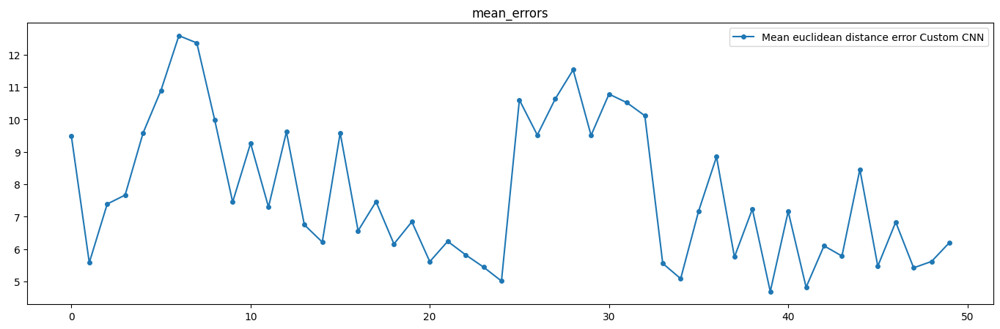

Average error of all points:  7.725307362569896
Minimum error of all points:  4.689349688961057  for point:  39
Maximim error of all points:  12.583902970778357  for point:  6


In [ ]:
import numpy as np
import matplotlib.pyplot as plt


def calculate_error(predicted_coords, actual_coords):
    errors = np.sqrt(np.sum((predicted_coords - actual_coords) ** 2, axis=1))
    return errors



all_error=[]
# predictions = ffnn.predict(X_test, verbose=0)
predictions = ffnn.predict([X_test_pc, X_test_image], verbose=0)
predictions = fix_precition(X_test_pc, predictions)

for i in range(len(predictions)):
    errors = calculate_error(predictions[i], y_test[i])
    all_error.append(errors)

all_error = np.array(all_error).transpose()
mean_errors=[]

for i in range(len(all_error)):
    mean_errors.append(all_error[i].mean())

plt.figure(figsize=(17,5))
plt.plot(mean_errors,  marker='o', markersize=4, linestyle='-',label = "Mean euclidean distance error Custom CNN")
plt.title('mean_errors')
plt.legend()
plt.show()
print("Average error of all points: " , np.array(mean_errors).mean())
print("Minimum error of all points: " , np.array(mean_errors).min(), " for point: " , mean_errors.index(np.array(mean_errors).min()))
print("Maximim error of all points: " , np.array(mean_errors).max(), " for point: " , mean_errors.index(np.array(mean_errors).max()))

# print("minimu error of all points: " , np.array(mean_errors).mean())



In [ ]:
max(mean_errors)

15.575706068990105

In [ ]:
# np.save('error_41k_rigid_aug.npy', mean_errors)

37.947195939632955


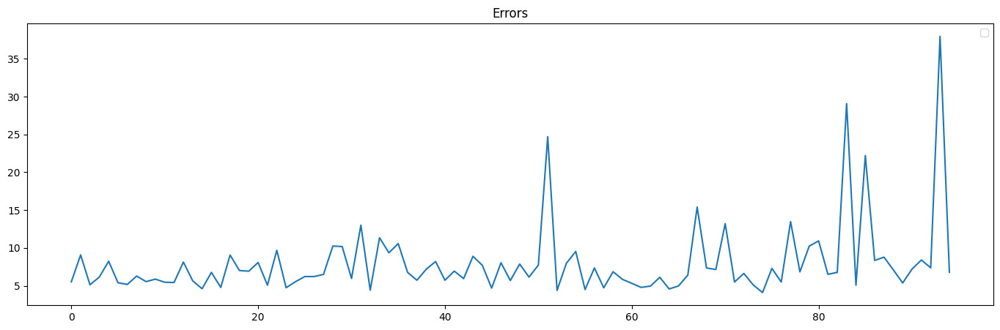

In [ ]:
all_faces = []
for i in range(len(X)):
    face_num = i
    face=[]
    face.append(X[face_num])
    face = np.array(face)
    predictions = ffnn.predict(face, verbose=0)
    predictions
    # predictions = predictions.reshape(50,3)
    predictions.shape
    y[face_num].shape
    # predictions[0].shape

    import math
    actual_ = y[face_num]
    predicted_ = predictions[0]


    def euclidean_distance(coord1, coord2):
        if len(coord1) != 3 or len(coord2) != 3:
            raise ValueError("Coordinates must be 3D (x, y, z)")

        squared_sum = sum((coord1[i] - coord2[i])**2 for i in range(3))
        distance = math.sqrt(squared_sum)
        return distance


    errors=[]
    for i in range(len(actual_)):
        # actual_set = set(actual_[i])
        # predicted_set = set(predicted_[i])
        errors.append(euclidean_distance(actual_[i], predicted_[i]))

    all_faces.append(np.array(errors).mean())

all_faces = np.array(all_faces)
# print(np.array(errors).mean())
print(max(all_faces))
plt.figure(figsize=(17,5))
plt.plot(all_faces)
plt.title('Errors')
plt.legend()
plt.show()

In [ ]:
for i in range(len(all_faces)):
    if all_faces[i]>30:
        print(i, all_faces[i])

93 37.947195939632955


In [ ]:
len(predictions)

1

In [ ]:
face_num= 40
# Example usage
coordinates = [
        X[face_num],
        y[face_num],
        # predictions
        # X[0],
        # y_test[5],
        # y_test[18],
        # faces_aligned[69],
        # landmark_aligned[69]
]
colors = [
          # (1, 1, 1)
          (0, 0, 1), #Blue
          (0, 1, 0), #green
          (1, 0, 0)    #Red
          ]  # Black for the first set, red for the second set

scale_factor = [ 0.3 ,
                1,
                  1,
                #   1
                ]


visualize_3d_coordinates(coordinates, colors, scale_factor)

## Custom Model con images

In [ ]:
X_pc = X
X_images = np.load('images.npy')

indices_to_remove = [23,32,79,180]
# X = np.delete(input_array, indices_to_remove, axis=0)
X_images = np.delete(X_images, indices_to_remove, axis=0)

print("shape of the image array: " , X_images.shape)
print("shape of the pointcloud array: ", X_pc.shape)

shape of the image array:  (197, 300, 500, 3)
shape of the pointcloud array:  (197, 41000, 3)


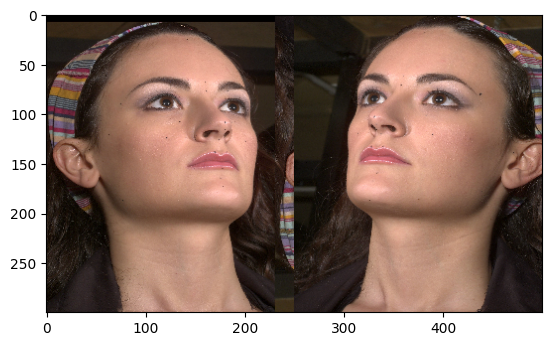

In [ ]:
plt.imshow(X_images[0])

(197, 41000, 3)

In [ ]:
from sklearn.model_selection import train_test_split

#SPLIT DATA INTO TRAIN AND TEST SET
X_train_pc, X_test_pc, y_train, y_test = train_test_split(X_pc, y,
                                                    test_size =0.2, #by default is 75%-25%
                                                    random_state= 123,
                                                    shuffle=True) #fix random seed for replicability

print(X_train_pc.shape,y_train.shape,X_test_pc.shape, y_test.shape)


#SPLIT DATA INTO TRAIN AND TEST SET
X_train_image, X_test_image, y_train, y_test = train_test_split(X_images, y,
                                                    test_size =0.2, #by default is 75%-25%
                                                    random_state= 123,
                                                    shuffle=True) #fix random seed for replicability

print(X_train_image.shape,y_train.shape,X_test_image.shape, y_test.shape)

# X_train_orig = X_train.copy()
# X_test_orig = X_test.copy()
# y_train_orig = y_train.copy()
# y_test_orig = y_test.copy()

(157, 41000, 3) (157, 50, 3) (40, 41000, 3) (40, 50, 3)
(157, 300, 500, 3) (157, 50, 3) (40, 300, 500, 3) (40, 50, 3)


In [ ]:
input_shape_pc = X_train_pc.shape[1:]
input_shape_image = X_train_image.shape[1:]
output_shape = y_train.shape[1:]
output_shape

(50, 3)

In [ ]:
# Download and plot the VGG16 model
supernet = tfk.applications.VGG16(
    include_top=False,
    weights="imagenet",
    input_shape=input_shape_image
)

# supernet.summary()
# tfk.utils.plot_model(supernet)

58889256/58889256 [==============================] - 1s 0us/step


In [ ]:
##### trail image + pc
def build_ffnn(input_shape_pc, input_shape_image, output_shape):

  supernet.trainable = True


  input_pc     = tfkl.Input(shape=input_shape_pc, name='Input_pc')
  inputs_image = tfkl.Input(shape=input_shape_image, name='Input_image')

  x_pc = input_pc
  x_image = inputs_image


  ##############################################################################################  Image
  x_image = supernet(x_image)
  x_image = tfkl.Flatten(name='Flattening')(x_image)
  x_image = tfkl.Dense(units=1500, activation='relu')(x_image)


##############################################################################################  poitwise

  x_pc = tfkl.Conv1D(filters=50, kernel_size=1, activation='relu',padding='same' )(x_pc)
  x_pc = tfkl.MaxPooling1D(pool_size=4)(x_pc)


  x_pc = tfkl.Conv1D(filters=200, kernel_size=1, activation='relu',padding='same')(x_pc)
  x_pc = tfkl.Conv1D(filters=100, kernel_size=1, activation='relu',padding='same')(x_pc)
  x_pc = tfkl.MaxPooling1D(pool_size=5)(x_pc)

  x_pc = tfkl.Conv1D(filters=200, kernel_size=1, activation='relu',padding='same')(x_pc)
  x_pc = tfkl.MaxPooling1D(pool_size=5)(x_pc)

  x_pc = tfkl.Conv1D(filters=100, kernel_size=1, activation='relu',padding='same')(x_pc)
  x_pc = tfkl.MaxPooling1D(pool_size=2)(x_pc)
  x_pc = tfkl.Flatten()(x_pc)
  x_pc = tfkl.Dense(units=1500, activation='relu')(x_pc)




  # x = tfkl.GlobalAveragePooling1D()(x)
  # x = tfkl.Flatten()(x)
  # x = tfkl.Concatenate(axis = 1)([x_pc, x_image])
  x = tf.stack([x_pc, x_image], axis=1)

  x = tfkl.Conv1D(filters=1000, kernel_size=1, activation='relu',padding='same')(x)
  x = tfkl.Conv1D(filters=512, kernel_size=1, activation='relu',padding='same')(x)
  x = tfkl.MaxPooling1D(pool_size=2)(x)
  # x = tfkl.Flatten()(x)
  x = tfkl.Dense(units=512, activation='relu',kernel_initializer=tfk.initializers.HeUniform(seed=seed))(x)
  x = tfkl.Dense(units=400, activation='relu')(x)
  x = tfkl.Dense(units=300, activation='relu')(x)
  x = tfkl.Dropout(0.1)(x)
  x = tfkl.Dense(units=250, activation='relu')(x)
  x = tfkl.Dense(units=150, activation='linear')(x)
  x = tfkl.Reshape(output_shape)(x)



  output_layer = x

  # Connect input and output through the Model class
  model = tfk.Model(inputs=[input_pc, inputs_image], outputs=output_layer, name='FFNN')

  # Compile the model
  # model.compile(loss=tfk.losses.MeanAbsoluteError(), optimizer=tfk.optimizers.Adam(), metrics=['mae'])
  model.compile(loss=tfk.losses.MeanSquaredError(), optimizer=tfk.optimizers.Adam(), metrics=['mse','mae'])

  # model.compile(loss=euclidean_distance_loss, optimizer=tfk.optimizers.Adam())
  # model.compile(loss=equi_loss, optimizer=tfk.optimizers.Adam())



  # Return the model
  return model


In [ ]:
ffnn = build_ffnn(input_shape_pc, input_shape_image,output_shape)
ffnn.summary()
# tfk.utils.plot_model(ffnn)

Model: "FFNN"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 Input_pc (InputLayer)       [(None, 41000, 3)]           0         []                            
                                                                                                  
 conv1d_7 (Conv1D)           (None, 41000, 50)            200       ['Input_pc[0][0]']            
                                                                                                  
 max_pooling1d_5 (MaxPoolin  (None, 10250, 50)            0         ['conv1d_7[0][0]']            
 g1D)                                                                                             
                                                                                                  
 conv1d_8 (Conv1D)           (None, 10250, 200)           10200     ['max_pooling1d_5[0][0]']  

In [ ]:
# Train the model
history = ffnn.fit(
    x = [X_train_pc, X_train_image],
    y = y_train,
    batch_size = 10,
    epochs = 5000,
    validation_data=([X_test_pc, X_test_image], y_test),
    callbacks = [
        tfk.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=25, restore_best_weights=True),
        tfk.callbacks.ReduceLROnPlateau(monitor='val_loss', mode='min', patience=10, factor=0.1, min_lr=1e-15)
    ]
).history

Epoch 1/5000
16/16 [==============================] - 21s 723ms/step - loss: 655.1580 - mse: 655.1580 - mae: 17.9361 - val_loss: 111.1199 - val_mse: 111.1199 - val_mae: 8.2773 - lr: 0.0010
Epoch 2/5000
16/16 [==============================] - 9s 595ms/step - loss: 100.3145 - mse: 100.3145 - mae: 7.6733 - val_loss: 45.0938 - val_mse: 45.0938 - val_mae: 5.0483 - lr: 0.0010
Epoch 3/5000
16/16 [==============================] - 10s 643ms/step - loss: 64.7601 - mse: 64.7601 - mae: 6.0111 - val_loss: 40.4271 - val_mse: 40.4271 - val_mae: 4.7884 - lr: 0.0010
Epoch 4/5000
16/16 [==============================] - 9s 564ms/step - loss: 53.3133 - mse: 53.3133 - mae: 5.4807 - val_loss: 43.9855 - val_mse: 43.9855 - val_mae: 5.0724 - lr: 0.0010
Epoch 5/5000
16/16 [==============================] - 10s 645ms/step - loss: 61.8029 - mse: 61.8029 - mae: 5.8807 - val_loss: 32.4268 - val_mse: 32.4268 - val_mae: 4.2703 - lr: 0.0010
Epoch 6/5000
16/16 [==============================] - 10s 635ms/step - loss

In [ ]:
# ffnn.save('mae_7.5')
# ffnn = load_model('mae_7.5')

In [ ]:
import numpy as np
import matplotlib.pyplot as plt


def calculate_error(predicted_coords, actual_coords):
    errors = np.sqrt(np.sum((predicted_coords - actual_coords) ** 2, axis=1))
    return errors



all_error=[]
# predictions = ffnn.predict(X_test, verbose=0)
predictions = ffnn.predict([X_test_pc, X_test_image], verbose=0)
predictions = fix_precition(X_test_pc, predictions)

for i in range(len(predictions)):
    errors = calculate_error(predictions[i], y_test[i])
    all_error.append(errors)

all_error = np.array(all_error).transpose()
mean_errors=[]

for i in range(len(all_error)):
    mean_errors.append(all_error[i].mean())

plt.figure(figsize=(17,5))
plt.plot(mean_errors,  marker='o', markersize=4, linestyle='-',label = "Mean euclidean distance error Custom CNN")
plt.title('mean_errors')
plt.legend()
plt.show()
print("Average error of all points: " , np.array(mean_errors).mean())
print("Minimum error of all points: " , np.array(mean_errors).min(), " for point: " , mean_errors.index(np.array(mean_errors).min()))
print("Maximim error of all points: " , np.array(mean_errors).max(), " for point: " , mean_errors.index(np.array(mean_errors).max()))

# print("minimu error of all points: " , np.array(mean_errors).mean())



NameError: name 'X_test_pc' is not defined

In [ ]:
max(mean_errors)

15.575706068990105

In [ ]:
# np.save('error_41k_rigid_aug.npy', mean_errors)

37.947195939632955


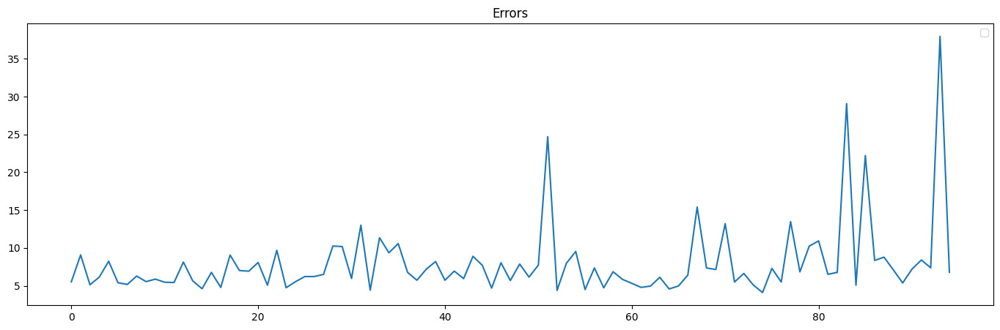

In [ ]:
all_faces = []
for i in range(len(X)):
    face_num = i
    face=[]
    face.append(X[face_num])
    face = np.array(face)
    predictions = ffnn.predict(face, verbose=0)
    predictions
    # predictions = predictions.reshape(50,3)
    predictions.shape
    y[face_num].shape
    # predictions[0].shape

    import math
    actual_ = y[face_num]
    predicted_ = predictions[0]


    def euclidean_distance(coord1, coord2):
        if len(coord1) != 3 or len(coord2) != 3:
            raise ValueError("Coordinates must be 3D (x, y, z)")

        squared_sum = sum((coord1[i] - coord2[i])**2 for i in range(3))
        distance = math.sqrt(squared_sum)
        return distance


    errors=[]
    for i in range(len(actual_)):
        # actual_set = set(actual_[i])
        # predicted_set = set(predicted_[i])
        errors.append(euclidean_distance(actual_[i], predicted_[i]))

    all_faces.append(np.array(errors).mean())

all_faces = np.array(all_faces)
# print(np.array(errors).mean())
print(max(all_faces))
plt.figure(figsize=(17,5))
plt.plot(all_faces)
plt.title('Errors')
plt.legend()
plt.show()

In [ ]:
for i in range(len(all_faces)):
    if all_faces[i]>30:
        print(i, all_faces[i])

93 37.947195939632955


In [ ]:
len(predictions)

1

In [ ]:
face_num= 40
# Example usage
coordinates = [
        X[face_num],
        y[face_num],
        # predictions
        # X[0],
        # y_test[5],
        # y_test[18],
        # faces_aligned[69],
        # landmark_aligned[69]
]
colors = [
          # (1, 1, 1)
          (0, 0, 1), #Blue
          (0, 1, 0), #green
          (1, 0, 0)    #Red
          ]  # Black for the first set, red for the second set

scale_factor = [ 0.3 ,
                1,
                  1,
                #   1
                ]


visualize_3d_coordinates(coordinates, colors, scale_factor)

## Fine Tune

In [20]:
# predictions = ffnn.predict(X_fine, verbose=0)
# predictions = fix_precition(X_fine, predictions)
# predictions.shape

# predictions = ffnn_pointNet_loaded.predict(X, verbose=0)
# predictions = ffnn_pointNet.predict(X, verbose=0)
predictions = ffnn.predict(X, verbose=0)

predictions = fix_precition(X, predictions)
predictions.shape



(157, 50, 3)

In [21]:
import numpy as np
from scipy.spatial import cKDTree
import open3d as o3d

face_heatmaps=[]
for i in range(len(X)):

    all_radius=[]
    for j in range(len(predictions[i])):

        # Sample 3D point cloud as a NumPy array
        point_cloud = X[i,:,:3]
        # point_cloud_w_normals = X[i]

        # Choose a point and radius
        chosen_point = predictions[i][j]
        # radius = mean_errors[j] + 5  # Replace with your desired radius
        radius = max(mean_errors) + 3

        # Build a k-d tree from the point cloud
        kdtree = cKDTree(point_cloud)

        # Query for points within the radius
        indices = kdtree.query_ball_point(chosen_point, radius)


        # Get the points within the radius
        #
        points_within_radius = point_cloud[indices]
        all_radius.append(points_within_radius)

        # if j ==0:
        #     points_within_radius = point_cloud[indices]

        # elif j >0:
        #     points_within_radius = np.concatenate( (points_within_radius , point_cloud[indices]), axis =0)

    # sampled=[]
    # for n in range(len(all_radius)):
    #   sampled.append(resample_with_normals(np.array(all_radius[n]),500)[0])
    # sampled = np.array(sampled)



    sampled = resample(all_radius,500)
    # w_normal = add_normals(sampled)


    # face_heatmaps.append(points_within_radius)
    # face_heatmaps.append(w_normal)
    face_heatmaps.append(sampled)



KeyboardInterrupt: 

In [ ]:
# face_heatmaps = np.load('face_heatmaps_500.npy')
face_heatmaps = np.array(face_heatmaps)
X_fine = face_heatmaps

import numpy as np
import point_cloud_utils as pcu

#######################################################################

# X_fine_temp = []
# X_fine_final=[]
# for i in range(len(X_fine)):
#   for j in range(len(X_fine[i])):

#     pts = X_fine[i][j]

#     # quantize points to bins of size 1/128
#     # NOTE: quantized point coordinates must lie between -1048576 and 1048576
#     eps = 1.0 / 128.0
#     pts_quantized = (pts / eps).astype(np.int32)

#     # Convert points to morton codes
#     # morton_codes has shape [pts.shape[0],] (one code per point)
#     morton_codes = pcu.morton_encode(pts_quantized)
#     sorted_pts = pts[np.argsort(morton_codes)]
#     X_fine_temp.append(sorted_pts)

#   X_fine_final.append(X_fine_temp)
#   X_fine_temp = []

################################################################################################

import math

def calculate_distance(point1, point2):
    # Assuming point1 and point2 are tuples or lists representing 3D points
    return math.sqrt((point1[0] - point2[0])**2 + (point1[1] - point2[1])**2 + (point1[2] - point2[2])**2)

def sort_point_cloud_by_distance(point_cloud, reference_point):
    # Use a lambda function as the key to the sorted function
    sorted_point_cloud = sorted(point_cloud, key=lambda point: calculate_distance(point, reference_point))
    return sorted_point_cloud

X_fine_temp = []
X_fine_final=[]
for i in range(len(X_fine)):
  for j in range(len(X_fine[i])):
    point_cloud = X_fine[i][j]
    reference_point = (0, 0, 0)
    X_fine_temp.append(sort_point_cloud_by_distance(point_cloud, reference_point))
  X_fine_final.append(X_fine_temp)
  X_fine_temp = []

################################################################################################
X_fine_final = np.array(X_fine_final)
X_fine_final.shape
X_fine_final = np.array(X_fine_final)
X_fine_final.shape
X_fine = X_fine_final

from sklearn.model_selection import train_test_split

#SPLIT DATA INTO TRAIN AND TEST SET
X_train, X_test, y_train, y_test = train_test_split(X_fine, y,
                                                    test_size =0.2, #by default is 75%-25%
                                                    random_state= 123,
                                                    shuffle=True) #fix random seed for replicability

print(X_train.shape,y_train.shape,X_test.shape, y_test.shape)


X_test = X_fine



### Fine tune Training

In [16]:
input_shape = X_train.shape[1:]
output_shape = y_train.shape[1:]
input_shape

(50, 500, 3)

In [17]:
def build_ffnn(input_shape, output_shape):
    # Build the neural network layer by layer
    input_layer = tfkl.Input(shape=input_shape, name='Input')
    x = input_layer


###############################################################################################  poitwise

    x = tfkl.Conv2D(filters=32, kernel_size=(1, 1), activation='relu',kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed) , padding='same')(x)
    x = tfkl.Conv2D(filters=32, kernel_size=(1, 1), activation='relu',kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed) , padding='same')(x)
    x = tfkl.MaxPooling2D(pool_size=(1, 5))(x)

    x = tfkl.Conv2D(filters=64, kernel_size=(1, 1), activation='relu',kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed) , padding='same')(x)
    x = tfkl.Conv2D(filters=64, kernel_size=(1, 1), activation='relu',kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed) , padding='same')(x)
    x = tfkl.MaxPooling2D(pool_size=(1, 5))(x)

    x = tfkl.Conv2D(filters=128, kernel_size=(1, 1), activation='relu',kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed) , padding='same')(x)
    x = tfkl.Conv2D(filters=128, kernel_size=(1, 1), activation='relu',kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed) , padding='same')(x)
    x = tfkl.MaxPooling2D(pool_size=(1, 4))(x)

    x = tfkl.Flatten()(x)
    x = tfkl.Dense(units=1024, activation='relu' , kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed))(x)
    # x = tfkl.Dropout(0.1)(x)
    x = tfkl.Dropout(0.2)(x)

    x = tfkl.Dense(units=output_shape[0] * output_shape[1], activation='linear',  kernel_initializer=tf.keras.initializers.GlorotNormal(seed = seed))(x)
    x = tfkl.Reshape(output_shape)(x)
    output_layer = x


    model = tfk.Model(inputs=input_layer, outputs=output_layer, name='FFNN')

    model.compile(loss=tfk.losses.MeanSquaredError(), optimizer=tfk.optimizers.Adam(), metrics=['mae'])


    # Return the model
    return model


In [18]:
ffnn_finetune = build_ffnn(input_shape,output_shape)
ffnn_finetune.summary()
# tfk.utils.plot_model(ffnn)

Model: "FFNN"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input (InputLayer)          [(None, 50, 500, 3)]      0         
                                                                 
 conv2d (Conv2D)             (None, 50, 500, 32)       128       
                                                                 
 conv2d_1 (Conv2D)           (None, 50, 500, 32)       1056      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 50, 100, 32)      0         
 )                                                               
                                                                 
 conv2d_2 (Conv2D)           (None, 50, 100, 64)       2112      
                                                                 
 conv2d_3 (Conv2D)           (None, 50, 100, 64)       4160      
                                                              

In [19]:
# Train the model
history = ffnn_finetune.fit(
    x = X_train,
    y = y_train,
    batch_size = 4,
    epochs = 5000,
    validation_data=(X_test, y_test),
    callbacks = [
        tfk.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=15, restore_best_weights=True),
        tfk.callbacks.ReduceLROnPlateau(monitor='val_loss', mode='min', patience=10, factor=0.1, min_lr=1e-12)
    ]
).history

Epoch 1/5000
 1/40 [..............................] - ETA: 48s - loss: 1720.9576 - mae: 30.9893

40/40 [==============================] - ETA: 0s - loss: 192.7731 - mae: 9.5490

ValueError: in user code:

    File "c:\Users\Ali\anaconda3\lib\site-packages\keras\engine\training.py", line 1727, in test_function  *
        return step_function(self, iterator)
    File "c:\Users\Ali\anaconda3\lib\site-packages\keras\engine\training.py", line 1713, in step_function  **
        outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "c:\Users\Ali\anaconda3\lib\site-packages\keras\engine\training.py", line 1701, in run_step  **
        outputs = model.test_step(data)
    File "c:\Users\Ali\anaconda3\lib\site-packages\keras\engine\training.py", line 1665, in test_step
        y_pred = self(x, training=False)
    File "c:\Users\Ali\anaconda3\lib\site-packages\keras\utils\traceback_utils.py", line 70, in error_handler
        raise e.with_traceback(filtered_tb) from None
    File "c:\Users\Ali\anaconda3\lib\site-packages\keras\engine\input_spec.py", line 295, in assert_input_compatibility
        raise ValueError(

    ValueError: Input 0 of layer "FFNN" is incompatible with the layer: expected shape=(None, 50, 500, 3), found shape=(4, 10000, 3)


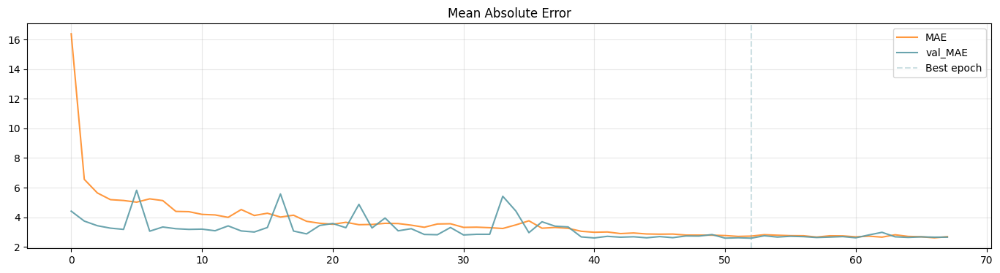

In [ ]:
best_epoch = np.argmin(history['val_mae'])
plt.figure(figsize=(17,4))
plt.plot(history['mae'], label='MAE', alpha=.8, color='#ff7f0e')
plt.plot(history['val_mae'], label='val_MAE', alpha=.9, color='#5a9aa5')
plt.axvline(x=best_epoch, label='Best epoch', alpha=.3, ls='--', color='#5a9aa5')
plt.title('Mean Absolute Error')
plt.legend()
plt.grid(alpha=.3)
plt.show()

In [ ]:
# ffnn_finetune.save('MODELS/base_line_(Refinement_model_Estimate)_w_normals')
# ffnn_finetune.save('MODELS/base_line_(Refinement_model_EsTi)_ref_sorting_origin')

# # ffnn_finetune = tfk.models.load_model('MODELS/base_line_(Refinement_model)',compile=False)
# ffnn_finetune = tfk.models.load_model('MODELS/base_line_(Refinement_model_Esti)',compile=False)
# ffnn_finetune = tfk.models.load_model('MODELS/base_line_(Refinement_model_Estimate)_ref_sorting_origin',compile=False)
# ffnn_finetune.compile(loss=tfk.losses.MeanSquaredError(), optimizer=tfk.optimizers.Adam(), metrics=['mae'])



In [ ]:
import numpy as np
import matplotlib.pyplot as plt


def calculate_error(predicted_coords, actual_coords):
    errors = np.sqrt(np.sum((predicted_coords - actual_coords) ** 2, axis=1))
    return errors



all_error=[]
predictions = ffnn_finetune.predict(X_test, verbose=0)
predictions = fix_precition_finetune(X_test_orig, predictions)

for i in range(len(predictions)):
    errors = calculate_error(predictions[i], y_test[i])
    all_error.append(errors)

all_error = np.array(all_error).transpose()
mean_errors=[]

for i in range(len(all_error)):
    mean_errors.append(all_error[i].mean())

plt.figure(figsize=(17,5))
plt.plot(mean_errors,  marker='o', markersize=4, linestyle='-',label = "Mean euclidean distance error Custom CNN - Fine Tuned", color = 'red')
plt.title('mean_errors')
plt.legend()
plt.show()
print("Average error of all points: " , np.array(mean_errors).mean())
print("Minimum error of all points: " , np.array(mean_errors).min(), " for point: " , mean_errors.index(np.array(mean_errors).min()))
print("Maximim error of all points: " , np.array(mean_errors).max(), " for point: " , mean_errors.index(np.array(mean_errors).max()))

# print("minimu error of all points: " , np.array(mean_errors).mean())



NameError: name 'ffnn_finetune' is not defined

Remove biased landmarks

In [ ]:

def finalize_landmark(y_pre):
  y=[]
  for i in range(len(y_pre)):
    landmarks = y_pre[i]
    landmarks_sorted = landmarks[[ 0, 11, 22, 33, 44, 46, 47, 48, 49,  1,  2,  3,  4,  5,  6,  7,  8,
                          9, 10, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27,
                          28, 29, 30, 31, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 45]]


    landmarks_to_remove = [13,14,15,16,32,33,34,35]
    y.append(np.delete(landmarks_sorted, landmarks_to_remove, axis=0))
    # y.append(landmarks_sorted)

  y= np.array(y)
  return y


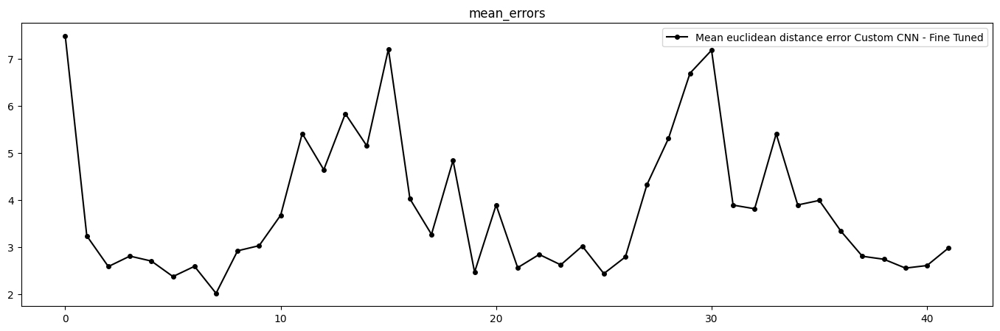

Average error of all points:  3.8072881474240257
Minimum error of all points:  2.0148076000457458  for point:  7
Maximim error of all points:  7.486725675354291  for point:  0


In [ ]:
import numpy as np
import matplotlib.pyplot as plt


def calculate_error(predicted_coords, actual_coords):
    errors = np.sqrt(np.sum((predicted_coords - actual_coords) ** 2, axis=1))
    return errors



all_error=[]
predictions = ffnn_finetune.predict(X_test, verbose=0)
# predictions = fix_precition_finetune(X_test_orig, predictions)
predictions = fix_precition_finetune_new(X_test_orig, predictions,10)


predictions = finalize_landmark(predictions)
y_test_finalized = finalize_landmark(y_test)


for i in range(len(predictions)):
    errors = calculate_error(predictions[i], y_test_finalized[i])
    all_error.append(errors)

all_error = np.array(all_error).transpose()
mean_errors=[]

for i in range(len(all_error)):
    mean_errors.append(all_error[i].mean())

plt.figure(figsize=(17,5))
plt.plot(mean_errors,  marker='o', markersize=4, linestyle='-',label = "Mean euclidean distance error Custom CNN - Fine Tuned",color = "black")
plt.title('mean_errors')
plt.legend()
plt.show()
print("Average error of all points: " , np.array(mean_errors).mean())
print("Minimum error of all points: " , np.array(mean_errors).min(), " for point: " , mean_errors.index(np.array(mean_errors).min()))
print("Maximim error of all points: " , np.array(mean_errors).max(), " for point: " , mean_errors.index(np.array(mean_errors).max()))

# print("minimu error of all points: " , np.array(mean_errors).mean())



array([40,  2,  1, 37,  6,  7, 25, 19, 26, 38, 22,  5,  3,  4, 23, 21, 41,
       39,  9, 36, 17, 24,  8, 32, 31, 34, 16, 35, 10, 20, 27, 28, 18, 33,
       12, 11, 13, 14, 29, 15, 30,  0])

In [ ]:
# np.save('fine_tune_error_41k_vn.npy', mean_errors)

In [ ]:
import numpy as np
import plotly.graph_objects as go

# Assuming you have the actual landmarks stored in 'actual_landmarks'
# and the predicted landmarks stored in 'predicted_landmarks'
face_num = 180
predictions = ffnn_finetune.predict(X_fine, verbose=0)
# predictions = fix_precition_finetune(X, predictions)

# Example point cloud with 40000 points in 3D space
point_cloud = X[face_num]  # Replace with your actual face point cloud

# Example landmark coordinates for the actual and predicted landmarks
actual_landmarks = y[face_num]  # Replace with your actual landmark coordinates
predicted_landmarks = predictions[face_num]  # Replace with your predicted landmark coordinates

# Create a scatter plot for the original point cloud
scatter_original = go.Scatter3d(
    x=point_cloud[:, 0],
    y=point_cloud[:, 1],
    z=point_cloud[:, 2],
    mode='markers',
    marker=dict(size=0.5, color='blue', opacity=0.5),
    name='Point Cloud'
)

# Create a scatter plot for the actual landmarks
scatter_actual_landmarks = go.Scatter3d(
    x=actual_landmarks[:, 0],
    y=actual_landmarks[:, 1],
    z=actual_landmarks[:, 2],
    mode='markers',
    marker=dict(size=2, color='green', symbol='circle', opacity=1),
    name='Actual Landmarks'
)

# Create a scatter plot for the predicted landmarks
scatter_predicted_landmarks = go.Scatter3d(
    x=predicted_landmarks[:, 0],
    y=predicted_landmarks[:, 1],
    z=predicted_landmarks[:, 2],
    mode='markers',
    marker=dict(size=2, color='red', symbol='circle', opacity=1),
    name='Predicted Landmarks'
)

# Create the 3D figure
fig = go.Figure(data=[scatter_original, scatter_actual_landmarks, scatter_predicted_landmarks])

# Set layout options
fig.update_layout(
    scene=dict(aspectmode="data"),
    scene_camera=dict(eye=dict(x=1.25, y=1.25, z=1.25)),
    title='Point Cloud with Landmarks',
    showlegend=True
)

# Show the interactive 3D plot
fig.show()


In [ ]:
import numpy as np
import plotly.graph_objects as go

# Assuming you have the actual landmarks stored in 'actual_landmarks'
# and the predicted landmarks stored in 'predicted_landmarks'
face_num = 20
predictions = ffnn_finetune.predict(X_test, verbose=0)
predictions = fix_precition_finetune(X_test_orig, predictions)

# Example point cloud with 40000 points in 3D space
point_cloud = X_test_orig[face_num]  # Replace with your actual face point cloud

# Example landmark coordinates for the actual and predicted landmarks
actual_landmarks = y_test[face_num]  # Replace with your actual landmark coordinates
predicted_landmarks = predictions[face_num]  # Replace with your predicted landmark coordinates

# Create a scatter plot for the original point cloud
scatter_original = go.Scatter3d(
    x=point_cloud[:, 0],
    y=point_cloud[:, 1],
    z=point_cloud[:, 2],
    mode='markers',
    marker=dict(size=0.5, color='blue', opacity=0.5),
    name='Point Cloud'
)

# Create a scatter plot for the actual landmarks
scatter_actual_landmarks = go.Scatter3d(
    x=actual_landmarks[:, 0],
    y=actual_landmarks[:, 1],
    z=actual_landmarks[:, 2],
    mode='markers',
    marker=dict(size=2, color='green', symbol='circle', opacity=1),
    name='Actual Landmarks'
)

# Create a scatter plot for the predicted landmarks
scatter_predicted_landmarks = go.Scatter3d(
    x=predicted_landmarks[:, 0],
    y=predicted_landmarks[:, 1],
    z=predicted_landmarks[:, 2],
    mode='markers',
    marker=dict(size=2, color='red', symbol='circle', opacity=1),
    name='Predicted Landmarks'
)

# Create the 3D figure
fig = go.Figure(data=[scatter_original, scatter_actual_landmarks, scatter_predicted_landmarks])

# Set layout options
fig.update_layout(
    scene=dict(aspectmode="data"),
    scene_camera=dict(eye=dict(x=1.25, y=1.25, z=1.25)),
    title='Point Cloud with Landmarks',
    showlegend=True
)

# Show the interactive 3D plot
fig.show()


### Fine tune ResNet50 Training

In [ ]:
input_shape = X_train.shape[1:]
output_shape = y_train.shape[1:]
input_shape

(50, 500, 3)

In [ ]:
supernet1 = tfk.applications.ConvNeXtBase(
    include_top=False,
    # weights= "imagenet",
    weights= None,
    input_shape=input_shape
)

ValueError: `input_shape` must be a tuple of three integers.

In [ ]:
def build_ffnn(input_shape, output_shape):
    # Build the neural network layer by layer
    input_layer = tfkl.Input(shape=input_shape, name='Input')
    x = input_layer

    x = supernet1(x)
    # x = tfkl.GlobalAveragePooling1D()(x)
    x = tfkl.Flatten()(x)
    x = tfkl.Dense(units=512, activation='relu',kernel_initializer=tfk.initializers.HeUniform(seed=seed))(x)
    x = tfkl.Dense(units=400, activation='relu')(x)
    x = tfkl.Dense(units=300, activation='relu')(x)

    x = tfkl.Dense(units=250, activation='relu')(x)
    x = tfkl.Dense(units=output_shape[0] * output_shape[1], activation='linear')(x)
    x = tfkl.Reshape(output_shape)(x)

    # outputs=[]
    # for i in range(len(y[0])):
    #       outputs.append(tfkl.Dense(units=3, activation='linear')(x))

    # x = tf.keras.layers.concatenate(outputs, axis=1)
    # output_shape = (len(y[0]), 3)
    # x = tf.keras.layers.Reshape(output_shape)(x)


    output_layer = x

    # Connect input and output through the Model class
    model = tfk.Model(inputs=input_layer, outputs=output_layer, name='FFNN')

    # Compile the model
    # model.compile(loss=tfk.losses.MeanAbsoluteError(), optimizer=tfk.optimizers.Adam(), metrics=['mae'])
    model.compile(loss=tfk.losses.MeanSquaredError(), optimizer=tfk.optimizers.Adam(), metrics=['mae'])

    # model.compile(loss=euclidean_distance_loss, optimizer=tfk.optimizers.Adam())
    # model.compile(loss=equi_loss, optimizer=tfk.optimizers.Adam())



    # Return the model
    return model


In [ ]:
ffnn_finetune = build_ffnn(input_shape,output_shape)
ffnn_finetune.summary()
# tfk.utils.plot_model(ffnn)

Model: "FFNN"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input (InputLayer)          [(None, 50, 1000, 3)]     0         
                                                                 
 convnext_base (Functional)  (None, 1, 31, 1024)       87566464  
                                                                 
 flatten_7 (Flatten)         (None, 31744)             0         
                                                                 
 dense_23 (Dense)            (None, 512)               16253440  
                                                                 
 dense_24 (Dense)            (None, 400)               205200    
                                                                 
 dense_25 (Dense)            (None, 300)               120300    
                                                                 
 dense_26 (Dense)            (None, 250)               75250  

In [ ]:
# Train the model
history = ffnn_finetune.fit(
    x = X_train,
    y = y_train,
    batch_size = 5,
    epochs = 5000,
    validation_data=(X_test, y_test),
    callbacks = [
        tfk.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=18, restore_best_weights=True),
        tfk.callbacks.ReduceLROnPlateau(monitor='val_loss', mode='min', patience=10, factor=0.1, min_lr=1e-12)
    ]
).history

Epoch 1/5000
32/32 [==============================] - 105s 865ms/step - loss: 296.9819 - mae: 10.7177 - val_loss: 44.3198 - val_mae: 5.1023 - lr: 0.0010
Epoch 2/5000
32/32 [==============================] - 10s 319ms/step - loss: 45.1898 - mae: 4.8255 - val_loss: 34.2250 - val_mae: 4.4137 - lr: 0.0010
Epoch 3/5000
32/32 [==============================] - 11s 341ms/step - loss: 43.5565 - mae: 4.7003 - val_loss: 31.3158 - val_mae: 4.2228 - lr: 0.0010
Epoch 4/5000
32/32 [==============================] - 10s 307ms/step - loss: 49.6720 - mae: 5.0805 - val_loss: 41.5642 - val_mae: 4.7380 - lr: 0.0010
Epoch 5/5000
32/32 [==============================] - 10s 319ms/step - loss: 43.1814 - mae: 4.6957 - val_loss: 29.5428 - val_mae: 4.0442 - lr: 0.0010
Epoch 6/5000
32/32 [==============================] - 10s 311ms/step - loss: 40.2593 - mae: 4.5348 - val_loss: 31.0723 - val_mae: 4.1836 - lr: 0.0010
Epoch 7/5000
32/32 [==============================] - 11s 331ms/step - loss: 47.6184 - mae: 4.984

In [ ]:
# ffnn_finetune.save('ffnn_finetune')

In [ ]:
X_test.shape
X_test_orig.shape

(40, 41000, 3)

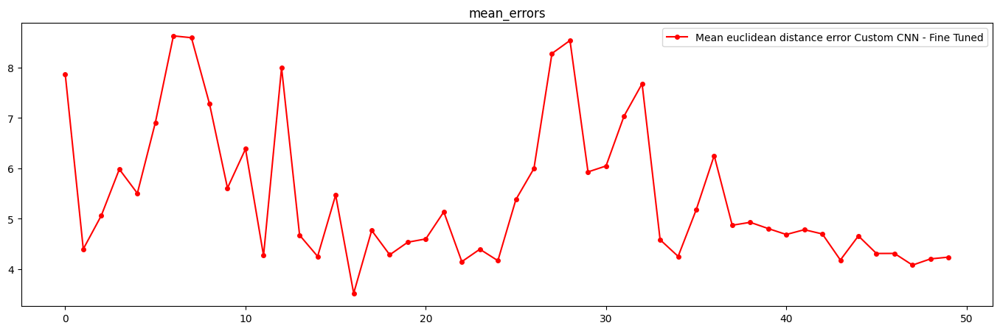

Average error of all points:  5.446588004978557
Minimum error of all points:  3.5207030224238736  for point:  16
Maximim error of all points:  8.62614691032456  for point:  6


In [ ]:
import numpy as np
import matplotlib.pyplot as plt


def calculate_error(predicted_coords, actual_coords):
    errors = np.sqrt(np.sum((predicted_coords - actual_coords) ** 2, axis=1))
    return errors



all_error=[]
predictions = ffnn_finetune.predict(X_test, verbose=0)
predictions = fix_precition_finetune(X_test_orig, predictions)

for i in range(len(predictions)):
    errors = calculate_error(predictions[i], y_test[i])
    all_error.append(errors)

all_error = np.array(all_error).transpose()
mean_errors=[]

for i in range(len(all_error)):
    mean_errors.append(all_error[i].mean())

plt.figure(figsize=(17,5))
plt.plot(mean_errors,  marker='o', markersize=4, linestyle='-',label = "Mean euclidean distance error Custom CNN - Fine Tuned", color = 'red')
plt.title('mean_errors')
plt.legend()
plt.show()
print("Average error of all points: " , np.array(mean_errors).mean())
print("Minimum error of all points: " , np.array(mean_errors).min(), " for point: " , mean_errors.index(np.array(mean_errors).min()))
print("Maximim error of all points: " , np.array(mean_errors).max(), " for point: " , mean_errors.index(np.array(mean_errors).max()))

# print("minimu error of all points: " , np.array(mean_errors).mean())



In [ ]:
 0.030832266246076438 * alpha

5.080646039073816

Remove biased landmarks

In [ ]:

def finalize_landmark(y_pre):
  y=[]
  for i in range(len(y_pre)):
    landmarks = y_pre[i]
    landmarks_sorted = landmarks[[ 0, 11, 22, 33, 44, 46, 47, 48, 49,  1,  2,  3,  4,  5,  6,  7,  8,
                          9, 10, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27,
                          28, 29, 30, 31, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 45]]


    landmarks_to_remove = [13,14,15,16,32,33,34,35]
    y.append(np.delete(landmarks_sorted, landmarks_to_remove, axis=0))
    # y.append(landmarks_sorted)

  y= np.array(y)
  return y


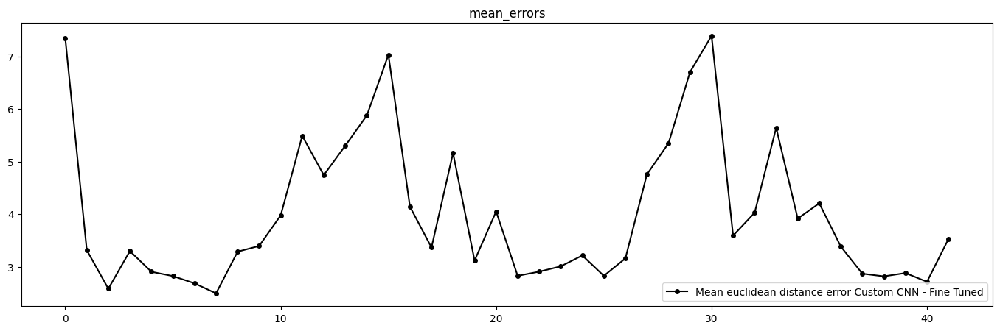

Average error of all points:  4.001895941931736
Minimum error of all points:  2.493537124280392  for point:  7
Maximim error of all points:  7.390315117326435  for point:  30


In [ ]:
import numpy as np
import matplotlib.pyplot as plt


def calculate_error(predicted_coords, actual_coords):
    errors = np.sqrt(np.sum((predicted_coords - actual_coords) ** 2, axis=1))
    return errors



all_error=[]
predictions = ffnn_finetune.predict(X_test, verbose=0)
# predictions = fix_precition_finetune(X_test_orig, predictions)
predictions = fix_precition_finetune_new(X_test_orig, predictions,10)


predictions = finalize_landmark(predictions)
y_test_finalized = finalize_landmark(y_test)


for i in range(len(predictions)):
    errors = calculate_error(predictions[i], y_test_finalized[i])
    all_error.append(errors)

all_error = np.array(all_error).transpose()
mean_errors=[]

for i in range(len(all_error)):
    mean_errors.append(all_error[i].mean())

plt.figure(figsize=(17,5))
plt.plot(mean_errors,  marker='o', markersize=4, linestyle='-',label = "Mean euclidean distance error Custom CNN - Fine Tuned",color = "black")
plt.title('mean_errors')
plt.legend()
plt.show()
print("Average error of all points: " , np.array(mean_errors).mean())
print("Minimum error of all points: " , np.array(mean_errors).min(), " for point: " , mean_errors.index(np.array(mean_errors).min()))
print("Maximim error of all points: " , np.array(mean_errors).max(), " for point: " , mean_errors.index(np.array(mean_errors).max()))

# print("minimu error of all points: " , np.array(mean_errors).mean())



array([40,  2,  1, 37,  6,  7, 25, 19, 26, 38, 22,  5,  3,  4, 23, 21, 41,
       39,  9, 36, 17, 24,  8, 32, 31, 34, 16, 35, 10, 20, 27, 28, 18, 33,
       12, 11, 13, 14, 29, 15, 30,  0])

In [ ]:
# np.save('fine_tune_error_41k_vn.npy', mean_errors)

In [ ]:
import numpy as np
import plotly.graph_objects as go

# Assuming you have the actual landmarks stored in 'actual_landmarks'
# and the predicted landmarks stored in 'predicted_landmarks'
face_num = 180
predictions = ffnn_finetune.predict(X_fine, verbose=0)
# predictions = fix_precition_finetune(X, predictions)

# Example point cloud with 40000 points in 3D space
point_cloud = X[face_num]  # Replace with your actual face point cloud

# Example landmark coordinates for the actual and predicted landmarks
actual_landmarks = y[face_num]  # Replace with your actual landmark coordinates
predicted_landmarks = predictions[face_num]  # Replace with your predicted landmark coordinates

# Create a scatter plot for the original point cloud
scatter_original = go.Scatter3d(
    x=point_cloud[:, 0],
    y=point_cloud[:, 1],
    z=point_cloud[:, 2],
    mode='markers',
    marker=dict(size=0.5, color='blue', opacity=0.5),
    name='Point Cloud'
)

# Create a scatter plot for the actual landmarks
scatter_actual_landmarks = go.Scatter3d(
    x=actual_landmarks[:, 0],
    y=actual_landmarks[:, 1],
    z=actual_landmarks[:, 2],
    mode='markers',
    marker=dict(size=2, color='green', symbol='circle', opacity=1),
    name='Actual Landmarks'
)

# Create a scatter plot for the predicted landmarks
scatter_predicted_landmarks = go.Scatter3d(
    x=predicted_landmarks[:, 0],
    y=predicted_landmarks[:, 1],
    z=predicted_landmarks[:, 2],
    mode='markers',
    marker=dict(size=2, color='red', symbol='circle', opacity=1),
    name='Predicted Landmarks'
)

# Create the 3D figure
fig = go.Figure(data=[scatter_original, scatter_actual_landmarks, scatter_predicted_landmarks])

# Set layout options
fig.update_layout(
    scene=dict(aspectmode="data"),
    scene_camera=dict(eye=dict(x=1.25, y=1.25, z=1.25)),
    title='Point Cloud with Landmarks',
    showlegend=True
)

# Show the interactive 3D plot
fig.show()


In [ ]:
import numpy as np
import plotly.graph_objects as go

# Assuming you have the actual landmarks stored in 'actual_landmarks'
# and the predicted landmarks stored in 'predicted_landmarks'
face_num = 20
predictions = ffnn_finetune.predict(X_test, verbose=0)
predictions = fix_precition_finetune(X_test_orig, predictions)

# Example point cloud with 40000 points in 3D space
point_cloud = X_test_orig[face_num]  # Replace with your actual face point cloud

# Example landmark coordinates for the actual and predicted landmarks
actual_landmarks = y_test[face_num]  # Replace with your actual landmark coordinates
predicted_landmarks = predictions[face_num]  # Replace with your predicted landmark coordinates

# Create a scatter plot for the original point cloud
scatter_original = go.Scatter3d(
    x=point_cloud[:, 0],
    y=point_cloud[:, 1],
    z=point_cloud[:, 2],
    mode='markers',
    marker=dict(size=0.5, color='blue', opacity=0.5),
    name='Point Cloud'
)

# Create a scatter plot for the actual landmarks
scatter_actual_landmarks = go.Scatter3d(
    x=actual_landmarks[:, 0],
    y=actual_landmarks[:, 1],
    z=actual_landmarks[:, 2],
    mode='markers',
    marker=dict(size=2, color='green', symbol='circle', opacity=1),
    name='Actual Landmarks'
)

# Create a scatter plot for the predicted landmarks
scatter_predicted_landmarks = go.Scatter3d(
    x=predicted_landmarks[:, 0],
    y=predicted_landmarks[:, 1],
    z=predicted_landmarks[:, 2],
    mode='markers',
    marker=dict(size=2, color='red', symbol='circle', opacity=1),
    name='Predicted Landmarks'
)

# Create the 3D figure
fig = go.Figure(data=[scatter_original, scatter_actual_landmarks, scatter_predicted_landmarks])

# Set layout options
fig.update_layout(
    scene=dict(aspectmode="data"),
    scene_camera=dict(eye=dict(x=1.25, y=1.25, z=1.25)),
    title='Point Cloud with Landmarks',
    showlegend=True
)

# Show the interactive 3D plot
fig.show()


### VGG?


In [ ]:
def build_ffnn(input_shape, output_shape):
    # Build the neural network layer by layer
    input_layer = tfkl.Input(shape=input_shape, name='Input')
    x = input_layer


    # Block 1
    x = tfkl.Conv2D(64, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.Conv2D(64, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.MaxPooling2D(pool_size=(1, 2))(x)

    # Block 2
    x = tfkl.Conv2D(128, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.Conv2D(128, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.MaxPooling2D(pool_size=(1, 2))(x)

    # Block 3
    x = tfkl.Conv2D(256, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.Conv2D(256, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.Conv2D(256, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.MaxPooling2D(pool_size=(1, 2))(x)

    # Block 4
    x = tfkl.Conv2D(512, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.Conv2D(512, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.Conv2D(512, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.MaxPooling2D(pool_size=(1, 2))(x)

    # Block 5
    x = tfkl.Conv2D(512, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.Conv2D(512, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.Conv2D(512, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.MaxPooling2D(pool_size=(1, 2))(x)

    # Block 6
    x = tfkl.Conv2D(512, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.Conv2D(512, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.Conv2D(512, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.MaxPooling2D(pool_size=(1, 3))(x)





    # x = tfkl.GlobalAveragePooling1D()(x)
    x = tfkl.Flatten()(x)
    x = tfkl.Dense(units=512, activation='relu',kernel_initializer=tfk.initializers.HeUniform(seed=seed))(x)
    x = tfkl.Dense(units=400, activation='relu')(x)
    x = tfkl.Dense(units=300, activation='relu')(x)
    x = tfkl.Dense(units=250, activation='relu')(x)
    x = tfkl.Dense(units=150, activation='linear')(x)
    x = tfkl.Reshape(output_shape)(x)



    output_layer = x

    # Connect input and output through the Model class
    model = tfk.Model(inputs=input_layer, outputs=output_layer, name='FFNN')

    # Compile the model
    model.compile(loss=tfk.losses.MeanAbsoluteError(), optimizer=tfk.optimizers.Adam(), metrics=['mae'])
    # model.compile(loss=euclidean_distance_loss, optimizer=tfk.optimizers.Adam())
    # model.compile(loss=equi_loss, optimizer=tfk.optimizers.Adam())



    # Return the model
    return model


In [ ]:
vgg_model = build_ffnn(input_shape,output_shape)
vgg_model.summary()
# tfk.utils.plot_model(ffnn)

Model: "FFNN"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input (InputLayer)          [(None, 50, 1000, 3)]     0         
                                                                 
 conv2d_6 (Conv2D)           (None, 50, 1000, 64)      256       
                                                                 
 conv2d_7 (Conv2D)           (None, 50, 1000, 64)      4160      
                                                                 
 max_pooling2d_5 (MaxPoolin  (None, 50, 500, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_8 (Conv2D)           (None, 50, 500, 128)      8320      
                                                                 
 conv2d_9 (Conv2D)           (None, 50, 500, 128)      16512     
                                                              

In [ ]:
# Train the model
history = vgg_model.fit(
    x = X_train,
    y = y_train,
    batch_size = 10,
    epochs = 5000,
    validation_data=(X_test, y_test),
    callbacks = [
        tfk.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=20, restore_best_weights=True),
        tfk.callbacks.ReduceLROnPlateau(monitor='val_loss', mode='min', patience=10, factor=0.1, min_lr=1e-10)
    ]
).history

Epoch 1/5000
8/8 [==============================] - 17s 895ms/step - loss: 35.0928 - mae: 35.0928 - val_loss: 26.2829 - val_mae: 26.2829 - lr: 0.0010
Epoch 2/5000
8/8 [==============================] - 4s 492ms/step - loss: 23.3822 - mae: 23.3822 - val_loss: 13.9108 - val_mae: 13.9108 - lr: 0.0010
Epoch 3/5000
8/8 [==============================] - 3s 407ms/step - loss: 10.9828 - mae: 10.9828 - val_loss: 7.5163 - val_mae: 7.5163 - lr: 0.0010
Epoch 4/5000
8/8 [==============================] - 3s 381ms/step - loss: 7.4063 - mae: 7.4063 - val_loss: 4.9917 - val_mae: 4.9917 - lr: 0.0010
Epoch 5/5000
8/8 [==============================] - 2s 301ms/step - loss: 7.0196 - mae: 7.0196 - val_loss: 5.7679 - val_mae: 5.7679 - lr: 0.0010
Epoch 6/5000
8/8 [==============================] - 3s 410ms/step - loss: 7.7153 - mae: 7.7153 - val_loss: 4.4336 - val_mae: 4.4336 - lr: 0.0010
Epoch 7/5000
8/8 [==============================] - 3s 323ms/step - loss: 7.8909 - mae: 7.8909 - val_loss: 5.0259 - val

KeyboardInterrupt: ignored

## 1D VGG

In [ ]:
input_shape = X_train.shape[1:]
output_shape = y_train.shape[1:]
output_shape

(50, 3)

In [ ]:
def build_ffnn(input_shape, output_shape):
    # Build the neural network layer by layer
    input_layer = tfkl.Input(shape=input_shape, name='Input')
    x = input_layer


    # Block 1
    x = tfkl.Conv1D(64, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.Conv1D(64, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.MaxPooling1D(pool_size=10)(x)

    # Block 2
    x = tfkl.Conv1D(128, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.Conv1D(128, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.MaxPooling1D(pool_size=2)(x)

    # Block 3
    x = tfkl.Conv1D(256, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.Conv1D(256, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.Conv1D(256, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.MaxPooling1D(pool_size=2)(x)

    # Block 4
    x = tfkl.Conv1D(512, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.Conv1D(512, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.Conv1D(512, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.MaxPooling1D(pool_size=2)(x)

    # Block 5
    x = tfkl.Conv1D(512, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.Conv1D(512, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.Conv1D(512, kernel_size=1, activation='relu', padding='same')(x)
    x = tfkl.MaxPooling1D(pool_size=2)(x)


    # x = tfkl.GlobalAveragePooling1D()(x)
    x = tfkl.Flatten()(x)
    x = tfkl.Dense(units=512, activation='relu',kernel_initializer=tfk.initializers.HeUniform(seed=seed))(x)
    x = tfkl.Dense(units=400, activation='relu')(x)
    x = tfkl.Dense(units=300, activation='relu')(x)
    x = tfkl.Dropout(0.1)(x)
    x = tfkl.Dense(units=250, activation='relu')(x)
    x = tfkl.Dense(units=150, activation='linear')(x)
    x = tfkl.Reshape(output_shape)(x)



    output_layer = x

    # Connect input and output through the Model class
    model = tfk.Model(inputs=input_layer, outputs=output_layer, name='FFNN')

    # Compile the model
    model.compile(loss=tfk.losses.MeanAbsoluteError(), optimizer=tfk.optimizers.Adam(), metrics=['mae'])
    # model.compile(loss=euclidean_distance_loss, optimizer=tfk.optimizers.Adam())
    # model.compile(loss=equi_loss, optimizer=tfk.optimizers.Adam())



    # Return the model
    return model


In [ ]:
vgg_model = build_ffnn(input_shape,output_shape)
vgg_model.summary()
# tfk.utils.plot_model(ffnn)

Model: "FFNN"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input (InputLayer)          [(None, 41000, 3)]        0         
                                                                 
 conv1d_13 (Conv1D)          (None, 41000, 64)         256       
                                                                 
 conv1d_14 (Conv1D)          (None, 41000, 64)         4160      
                                                                 
 max_pooling1d_5 (MaxPoolin  (None, 4100, 64)          0         
 g1D)                                                            
                                                                 
 conv1d_15 (Conv1D)          (None, 4100, 128)         8320      
                                                                 
 conv1d_16 (Conv1D)          (None, 4100, 128)         16512     
                                                              

In [ ]:
# Train the model
history = vgg_model.fit(
    x = X_train,
    y = y_train,
    batch_size = 5,
    epochs = 5000,
    validation_data=(X_test, y_test),
    callbacks = [
        tfk.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=20, restore_best_weights=True),
        tfk.callbacks.ReduceLROnPlateau(monitor='val_loss', mode='min', patience=10, factor=0.1, min_lr=1e-10)
    ]
).history

Epoch 1/5000
32/32 [==============================] - 10s 121ms/step - loss: 17.4147 - mae: 17.4147 - val_loss: 5.5227 - val_mae: 5.5227 - lr: 0.0010
Epoch 2/5000
32/32 [==============================] - 2s 64ms/step - loss: 6.0124 - mae: 6.0124 - val_loss: 7.8430 - val_mae: 7.8430 - lr: 0.0010
Epoch 3/5000
32/32 [==============================] - 2s 73ms/step - loss: 6.6594 - mae: 6.6594 - val_loss: 4.5561 - val_mae: 4.5561 - lr: 0.0010
Epoch 4/5000
32/32 [==============================] - 2s 72ms/step - loss: 5.7508 - mae: 5.7508 - val_loss: 3.9616 - val_mae: 3.9616 - lr: 0.0010
Epoch 5/5000
32/32 [==============================] - 2s 72ms/step - loss: 5.4148 - mae: 5.4148 - val_loss: 3.9075 - val_mae: 3.9075 - lr: 0.0010
Epoch 6/5000
32/32 [==============================] - 2s 72ms/step - loss: 4.7087 - mae: 4.7087 - val_loss: 3.8851 - val_mae: 3.8851 - lr: 0.0010
Epoch 7/5000
32/32 [==============================] - 2s 72ms/step - loss: 4.8665 - mae: 4.8665 - val_loss: 3.8662 - val

In [ ]:
from tensorflow.keras import layers
from tensorflow.keras.models import Model

def identity_block(x, filters, kernel_size=3):
    """
    Identity block for ResNet.
    """
    x_shortcut = x

    # First convolutional layer
    x = layers.Conv1D(filters, kernel_size, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation('relu')(x)

    # Second convolutional layer
    x = layers.Conv1D(filters, kernel_size, padding='same')(x)
    x = layers.BatchNormalization()(x)

    # Shortcut connection
    x_shortcut = layers.Conv1D(filters, 1, padding='same')(x_shortcut)
    x_shortcut = layers.BatchNormalization()(x_shortcut)

    x = layers.Add()([x, x_shortcut])
    x = layers.Activation('relu')(x)

    return x

def convolutional_block(x, filters, kernel_size=3):
    """
    Convolutional block for ResNet.
    """
    x_shortcut = x

    # First convolutional layer
    x = layers.Conv1D(filters, kernel_size, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation('relu')(x)

    # Second convolutional layer
    x = layers.Conv1D(filters, kernel_size, padding='same')(x)
    x = layers.BatchNormalization()(x)

    # Shortcut connection
    x_shortcut = layers.Conv1D(filters, 1, padding='same')(x_shortcut)
    x_shortcut = layers.BatchNormalization()(x_shortcut)

    x = layers.Add()([x, x_shortcut])
    x = layers.Activation('relu')(x)

    return x

def ResNet1D(input_shape=(41000, 3)):
    """
    ResNet architecture for 1D data.
    """
    input_tensor = layers.Input(shape=input_shape)

    # Initial Convolutional layer
    x = layers.Conv1D(64, 7, padding='same')(input_tensor)
    x = layers.BatchNormalization()(x)
    x = layers.Activation('relu')(x)

    # Residual blocks
    x = convolutional_block(x, filters=64)
    x = identity_block(x, filters=64)
    x = identity_block(x, filters=64)

    x = convolutional_block(x, filters=128)
    x = identity_block(x, filters=128)
    x = identity_block(x, filters=128)
    x = identity_block(x, filters=128)

    x = convolutional_block(x, filters=256)
    x = identity_block(x, filters=256)
    x = identity_block(x, filters=256)
    x = identity_block(x, filters=256)
    x = identity_block(x, filters=256)

    x = convolutional_block(x, filters=512)
    x = identity_block(x, filters=512)
    x = identity_block(x, filters=512)

    # Global average pooling and fully connected layer
    x = layers.GlobalAveragePooling1D()(x)
    x = tfkl.Dense(units=250, activation='relu')(x)
    x = tfkl.Dense(units=150, activation='linear')(x)
    x = tfkl.Reshape(output_shape)(x)


    model = Model(inputs=input_tensor, outputs=x, name='ResNet1D')

    return model

# Instantiate the model
resnet1d_model = ResNet1D()

# Display the model summary
resnet1d_model.summary()


Model: "ResNet1D"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 41000, 3)]           0         []                            
                                                                                                  
 conv1d (Conv1D)             (None, 41000, 64)            1408      ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 41000, 64)            256       ['conv1d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 activation (Activation)     (None, 41000, 64)            0         ['batch_normalization[0

In [ ]:
resnet1d_model.compile(loss=tfk.losses.MeanAbsoluteError(), optimizer=tfk.optimizers.Adam(), metrics=['mae'])

In [ ]:
# Train the model
history = resnet1d_model.fit(
    x = X_train,
    y = y_train,
    batch_size = 1,
    epochs = 5000,
    validation_data=(X_test, y_test),
    callbacks = [
        tfk.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=20, restore_best_weights=True),
        tfk.callbacks.ReduceLROnPlateau(monitor='val_loss', mode='min', patience=10, factor=0.1, min_lr=1e-10)
    ]
).history

Epoch 1/5000
157/157 [==============================] - 161s 868ms/step - loss: 8.7358 - mae: 8.7358 - val_loss: 7.8163 - val_mae: 7.8163 - lr: 0.0010
Epoch 2/5000
157/157 [==============================] - 139s 883ms/step - loss: 4.6502 - mae: 4.6502 - val_loss: 4.1788 - val_mae: 4.1788 - lr: 0.0010
Epoch 3/5000
157/157 [==============================] - 140s 891ms/step - loss: 4.5302 - mae: 4.5302 - val_loss: 4.0331 - val_mae: 4.0331 - lr: 0.0010
Epoch 4/5000
157/157 [==============================] - 140s 892ms/step - loss: 4.6520 - mae: 4.6520 - val_loss: 5.8210 - val_mae: 5.8210 - lr: 0.0010
Epoch 5/5000
157/157 [==============================] - 140s 891ms/step - loss: 4.6186 - mae: 4.6186 - val_loss: 3.9915 - val_mae: 3.9915 - lr: 0.0010
Epoch 6/5000
157/157 [==============================] - 139s 883ms/step - loss: 4.5169 - mae: 4.5169 - val_loss: 4.3416 - val_mae: 4.3416 - lr: 0.0010
Epoch 7/5000
157/157 [==============================] - 140s 890ms/step - loss: 4.4779 - mae: 

KeyboardInterrupt: 

In [ ]:
# ffnn.save('mae_7.5')
# ffnn = load_model('mae_7.5')

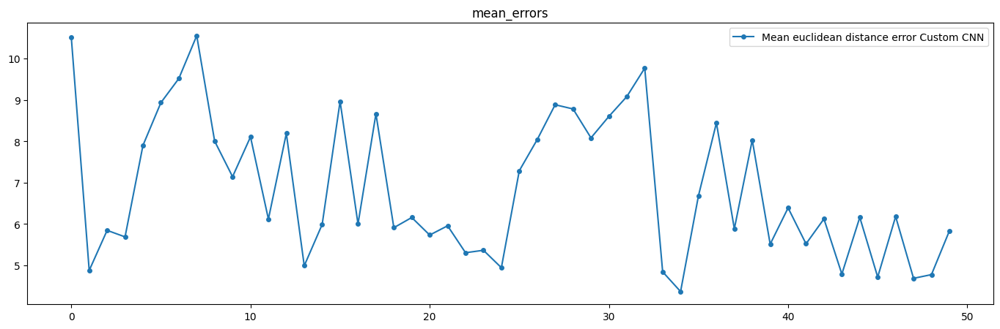

Average error of all points:  6.8583121728686685
Minimum error of all points:  4.369166830711748  for point:  34
Maximim error of all points:  10.553408218153308  for point:  7


In [ ]:
import numpy as np
import matplotlib.pyplot as plt


def calculate_error(predicted_coords, actual_coords):
    errors = np.sqrt(np.sum((predicted_coords - actual_coords) ** 2, axis=1))
    return errors



all_error=[]
predictions = vgg_model.predict(X_test, verbose=0)
predictions = fix_precition(X_test, predictions)

for i in range(len(predictions)):
    errors = calculate_error(predictions[i], y_test[i])
    all_error.append(errors)

all_error = np.array(all_error).transpose()
mean_errors=[]

for i in range(len(all_error)):
    mean_errors.append(all_error[i].mean())

plt.figure(figsize=(17,5))
plt.plot(mean_errors,  marker='o', markersize=4, linestyle='-',label = "Mean euclidean distance error Custom CNN")
plt.title('mean_errors')
plt.legend()
plt.show()
print("Average error of all points: " , np.array(mean_errors).mean())
print("Minimum error of all points: " , np.array(mean_errors).min(), " for point: " , mean_errors.index(np.array(mean_errors).min()))
print("Maximim error of all points: " , np.array(mean_errors).max(), " for point: " , mean_errors.index(np.array(mean_errors).max()))

# print("minimu error of all points: " , np.array(mean_errors).mean())



## PointNet


In [ ]:
input_shape = X_train.shape[1:]
output_shape = y_train.shape[1:]
output_shape

(50, 3)

In [ ]:
def conv_bn(x, filters):
    x = layers.Conv1D(filters, kernel_size=1, padding="valid")(x)
    x = layers.BatchNormalization(momentum=0.0)(x)
    return layers.Activation("relu")(x)


def dense_bn(x, filters):
    x = layers.Dense(filters)(x)
    x = layers.BatchNormalization(momentum=0.0)(x)
    return layers.Activation("relu")(x)


In [ ]:
class OrthogonalRegularizer(keras.regularizers.Regularizer):
    def __init__(self, num_features, l2reg=0.001):
        self.num_features = num_features
        self.l2reg = l2reg
        self.eye = tf.eye(num_features)

    def __call__(self, x):
        x = tf.reshape(x, (-1, self.num_features, self.num_features))
        xxt = tf.tensordot(x, x, axes=(2, 2))
        xxt = tf.reshape(xxt, (-1, self.num_features, self.num_features))
        return tf.reduce_sum(self.l2reg * tf.square(xxt - self.eye))

In [ ]:

def tnet(inputs, num_features):

    # Initalise bias as the indentity matrix
    bias = keras.initializers.Constant(np.eye(num_features).flatten())
    reg = OrthogonalRegularizer(num_features)

    x = conv_bn(inputs, 32)
    x = conv_bn(x, 64)
    x = conv_bn(x, 512)
    x = layers.GlobalMaxPooling1D()(x)
    x = dense_bn(x, 256)
    x = dense_bn(x, 128)


    x = layers.Dense(
        num_features * num_features,
        kernel_initializer="zeros",
        bias_initializer=bias,
        activity_regularizer=reg,
    )(x)
    feat_T = layers.Reshape((num_features, num_features))(x)
    # Apply affine transformation to input features
    return layers.Dot(axes=(2, 1))([inputs, feat_T])



In [ ]:
x = 0
model = 0
input_shape

(41000, 3)

In [ ]:
inputs = keras.Input(shape=input_shape)


# x = tnet(inputs, 3)
# x = conv_bn(x, 8)
# x = conv_bn(x, 8)
# x = tfkl.MaxPooling1D(pool_size=2)(x)
# x = tnet(x, 8)
# x = conv_bn(x, 8)
# x = conv_bn(x, 8)
# x = tfkl.MaxPooling1D(pool_size=2)(x)
# x = conv_bn(x, 8)
# # x = layers.GlobalMaxPooling1D()(x)
# # x = dense_bn(x, 256)
# # # x = layers.Dropout(0.3)(x)
# # x = dense_bn(x, 128)
# # # x = layers.Dropout(0.3)(x)

x = tnet(inputs, 3)
x = conv_bn(x, 32)
x = conv_bn(x, 32)
x = tnet(x, 32)
x = conv_bn(x, 32)
x = conv_bn(x, 64)
# x = conv_bn(x, 512)
x = layers.GlobalMaxPooling1D()(x)
# x = dense_bn(x, 256)
x = layers.Dropout(0.3)(x)
x = dense_bn(x, 128)
x = layers.Dropout(0.3)(x)



x = tfkl.Flatten()(x)
x = tfkl.Dense(units=512, activation='relu',kernel_initializer=tfk.initializers.HeUniform(seed=seed))(x)
x = tfkl.Dense(units=400, activation='relu')(x)
x = tfkl.Dense(units=300, activation='relu')(x)
x = tfkl.Dense(units=250, activation='relu')(x)
x = tfkl.Dense(units=150, activation='linear')(x)
outputs = tfkl.Reshape(output_shape)(x)



# outputs = layers.Reshape(output_shape)(x)


model = keras.Model(inputs=inputs, outputs=outputs, name="pointnet")
model.compile(loss=tfk.losses.MeanSquaredError(), optimizer=tfk.optimizers.Adam(), metrics=['mse','mae'])

model.summary()


Model: "pointnet"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 41000, 3)]           0         []                            
                                                                                                  
 conv1d_53 (Conv1D)          (None, 41000, 32)            128       ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 41000, 32)            128       ['conv1d_53[0][0]']           
 Normalization)                                                                                   
                                                                                                  
 activation (Activation)     (None, 41000, 32)            0         ['batch_normalization[0

In [ ]:
import trimesh
import matplotlib.pyplot as plt
import numpy as np

# Replace 'path_to_your_mesh.stl' with the actual path to your mesh file
mesh_file_path = "Ali_AcquisitionForThesis/2/2.obj"

# Load the mesh
mesh = trimesh.load(mesh_file_path)

# Extract vertex coordinates
vertices = mesh.vertices

# Extract vertex colors (if available)
if 'vertex_colors' in mesh.visual:
    vertex_colors = mesh.visual['vertex_colors']
else:
    # If no vertex colors are available, assign default color (white) to all vertices
    vertex_colors = np.ones_like(vertices)

# Plot the mesh
mesh.show()

# Plot the point cloud with RGB colors
fig = plt.figure()
ax = fig.add_subplot(111, projection="3d")
ax.scatter(vertices[:, 0], vertices[:, 1], vertices[:, 2], c=vertex_colors / 255.0)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.show()


ModuleNotFoundError: No module named 'trimesh'

In [ ]:
# Train the model
history = model.fit(
    x = X_train,
    y = y_train,
    batch_size = 5,
    epochs = 50000,
    validation_data=(X_test, y_test),
    callbacks = [
        tfk.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=12, restore_best_weights=True),
        tfk.callbacks.ReduceLROnPlateau(monitor='val_loss', mode='min', patience=10, factor=0.1, min_lr=1e-5)
    ]
).history

Epoch 1/50000


ResourceExhaustedError: Graph execution error:

Detected at node pointnet/conv1d_581/Conv1D-0-1-TransposeNCHWToNHWC-LayoutOptimizer defined at (most recent call last):
<stack traces unavailable>
OOM when allocating tensor with shape[5,1,41000,512] and type float on /job:localhost/replica:0/task:0/device:GPU:0 by allocator GPU_0_bfc
	 [[{{node pointnet/conv1d_581/Conv1D-0-1-TransposeNCHWToNHWC-LayoutOptimizer}}]]
Hint: If you want to see a list of allocated tensors when OOM happens, add report_tensor_allocations_upon_oom to RunOptions for current allocation info. This isn't available when running in Eager mode.
 [Op:__inference_train_function_181777]

In [ ]:
import gc
gc.collect()

2199

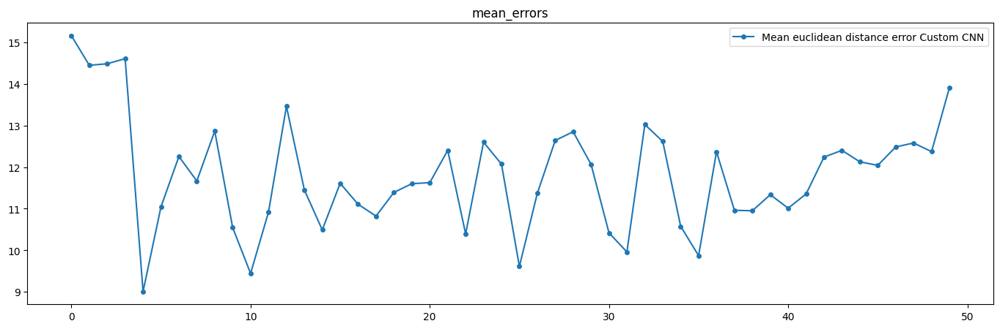

Average error of all points:  11.813487766333207
Minimum error of all points:  9.006261057003004  for point:  4
Maximim error of all points:  15.164160323051938  for point:  0


In [ ]:
import numpy as np
import matplotlib.pyplot as plt


def calculate_error(predicted_coords, actual_coords):
    errors = np.sqrt(np.sum((predicted_coords - actual_coords) ** 2, axis=1))
    return errors



all_error=[]
predictions = model.predict(X_test, verbose=0)
predictions = fix_precition(X_test, predictions)

for i in range(len(predictions)):
    errors = calculate_error(predictions[i], y_test[i])
    all_error.append(errors)

all_error = np.array(all_error).transpose()
mean_errors=[]

for i in range(len(all_error)):
    mean_errors.append(all_error[i].mean())

plt.figure(figsize=(17,5))
plt.plot(mean_errors,  marker='o', markersize=4, linestyle='-',label = "Mean euclidean distance error Custom CNN")
plt.title('mean_errors')
plt.legend()
plt.show()
print("Average error of all points: " , np.array(mean_errors).mean())
print("Minimum error of all points: " , np.array(mean_errors).min(), " for point: " , mean_errors.index(np.array(mean_errors).min()))
print("Maximim error of all points: " , np.array(mean_errors).max(), " for point: " , mean_errors.index(np.array(mean_errors).max()))

# print("minimu error of all points: " , np.array(mean_errors).mean())



## 2D VGG

In [ ]:
# Download and plot the VGG16 model
supernet = tfk.applications.VGG16(
    include_top=False,
    weights="imagenet",
    input_shape=X_images.shape[1:]
)
# supernet.summary()
# tfk.utils.plot_model(supernet)

In [ ]:
# Use the supernet as feature extractor
supernet.trainable = True

inputs = tfk.Input(shape=X_images.shape[1:])

x = supernet(inputs)
x = tfkl.Flatten(name='Flattening')(x)
x = tfkl.Dense(units=512, activation='relu',kernel_initializer=tfk.initializers.HeUniform(seed=seed))(x)
x = tfkl.Dense(units=400, activation='relu')(x)
x = tfkl.Dense(units=300, activation='relu')(x)
x = tfkl.Dense(units=250, activation='relu')(x)
x = tfkl.Dense(units=150, activation='linear')(x)
x = tfkl.Reshape(output_shape)(x)



output_layer = x

# Connect input and output through the Model class
model = tfk.Model(inputs=inputs, outputs=output_layer, name='FFNN')

# Compile the model
# model.compile(loss=tfk.losses.MeanAbsoluteError(), optimizer=tfk.optimizers.Adam(), metrics=['mae'])
model.compile(loss=tfk.losses.MeanSquaredError(), optimizer=tfk.optimizers.Adam(), metrics=['mse','mae'])


Exception ignored in: <function _xla_gc_callback at 0x7fb8e9f0c1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/jax/_src/lib/__init__.py", line 97, in _xla_gc_callback
    def _xla_gc_callback(*args):
KeyboardInterrupt: 


In [ ]:
# Train the model
history = model.fit(
    x = X_train,
    y = y_train,
    batch_size = 10,
    epochs = 5000,
    validation_data=(X_test, y_test),
    callbacks = [
        tfk.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=25, restore_best_weights=True),
        tfk.callbacks.ReduceLROnPlateau(monitor='val_loss', mode='min', patience=10, factor=0.1, min_lr=1e-15)
    ]
).history

Epoch 1/5000
8/8 [==============================] - 9s 917ms/step - loss: 1188.8459 - mse: 1188.8459 - mae: 25.8704 - val_loss: 329.1351 - val_mse: 329.1351 - val_mae: 13.2593 - lr: 0.0010
Epoch 2/5000
8/8 [==============================] - 2s 258ms/step - loss: 222.0319 - mse: 222.0319 - mae: 10.6133 - val_loss: 85.4995 - val_mse: 85.4995 - val_mae: 7.3889 - lr: 0.0010
Epoch 3/5000
8/8 [==============================] - 2s 241ms/step - loss: 122.2922 - mse: 122.2922 - mae: 7.8554 - val_loss: 60.9099 - val_mse: 60.9099 - val_mae: 6.0236 - lr: 0.0010
Epoch 4/5000
8/8 [==============================] - 2s 236ms/step - loss: 98.7559 - mse: 98.7559 - mae: 6.6622 - val_loss: 47.6018 - val_mse: 47.6018 - val_mae: 5.1531 - lr: 0.0010
Epoch 5/5000
8/8 [==============================] - 2s 245ms/step - loss: 82.4506 - mse: 82.4506 - mae: 5.7451 - val_loss: 41.3537 - val_mse: 41.3537 - val_mae: 4.8872 - lr: 0.0010
Epoch 6/5000
8/8 [==============================] - 2s 220ms/step - loss: 81.6431 

In [ ]:
predictions.shape

(19, 50, 3)

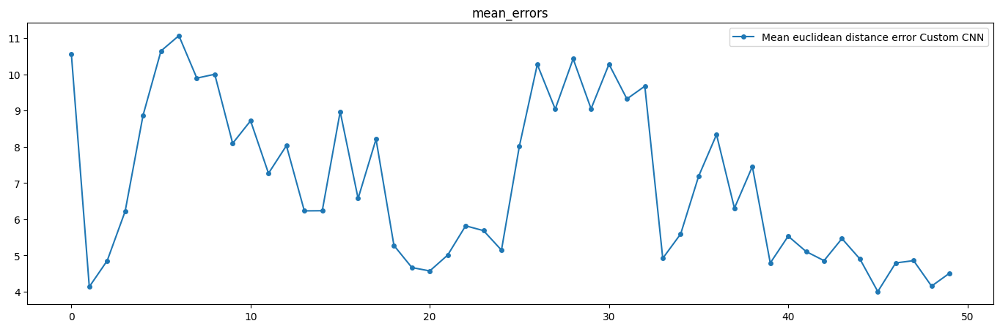

Average error of all points:  6.990029610732107
Minimum error of all points:  4.002253640339559  for point:  45
Maximim error of all points:  11.064610484941252  for point:  6


In [ ]:
import numpy as np
import matplotlib.pyplot as plt


def calculate_error(predicted_coords, actual_coords):
    errors = np.sqrt(np.sum((predicted_coords - actual_coords) ** 2, axis=1))
    return errors



all_error=[]
predictions = model.predict(X_test, verbose=0)
predictions = fix_precition(X_test_orig, predictions)

for i in range(len(predictions)):
    errors = calculate_error(predictions[i], y_test[i])
    all_error.append(errors)

all_error = np.array(all_error).transpose()
mean_errors=[]

for i in range(len(all_error)):
    mean_errors.append(all_error[i].mean())

plt.figure(figsize=(17,5))
plt.plot(mean_errors,  marker='o', markersize=4, linestyle='-',label = "Mean euclidean distance error Custom CNN")
plt.title('mean_errors')
plt.legend()
plt.show()
print("Average error of all points: " , np.array(mean_errors).mean())
print("Minimum error of all points: " , np.array(mean_errors).min(), " for point: " , mean_errors.index(np.array(mean_errors).min()))
print("Maximim error of all points: " , np.array(mean_errors).max(), " for point: " , mean_errors.index(np.array(mean_errors).max()))

# print("minimu error of all points: " , np.array(mean_errors).mean())



## Ensemble

In [ ]:
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import Input, Average


ffnn_model = Model(inputs=ffnn.inputs, outputs=ffnn.outputs, name='ffnn_model')
vgg_model = Model(inputs=vgg_model.inputs, outputs=vgg_model.outputs, name='vgg_model')

In [ ]:
models = [ffnn_model, vgg_model ]
model_input = Input(shape=X[0].shape)
model_outputs = [model(model_input) for model in models]
ensemble_output = Average()(model_outputs)
ensemble_model = Model(inputs=model_input, outputs=ensemble_output, name='ensemble')
# ensemble_model.compile(loss=tfk.losses.MeanAbsoluteError(), optimizer=tfk.optimizers.Adam(), metrics=['mae'])
ensemble_model.compile(loss=tfk.losses.MeanSquaredError(), optimizer=tfk.optimizers.Adam(), metrics=['mse'])

In [ ]:
ensemble_history = ensemble_model.fit(
    x = X_train,
    y = y_train,
    batch_size = 100,
    epochs = 5000,
    validation_data=(X_test, y_test),
    callbacks = [
        tfk.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=20, restore_best_weights=True),
        tfk.callbacks.ReduceLROnPlateau(monitor='val_loss', mode='min', patience=10, factor=0.1, min_lr=1e-10)
    ]).history

Epoch 1/5000
1/1 [==============================] - 11s 11s/step - loss: 680.1796 - mse: 680.1796 - val_loss: 1403.8003 - val_mse: 1403.8003 - lr: 0.0010
Epoch 2/5000
1/1 [==============================] - 9s 9s/step - loss: 1494.2587 - mse: 1494.2587 - val_loss: 135.8278 - val_mse: 135.8278 - lr: 0.0010
Epoch 3/5000
1/1 [==============================] - 8s 8s/step - loss: 214.3531 - mse: 214.3531 - val_loss: 461.8093 - val_mse: 461.8093 - lr: 0.0010
Epoch 4/5000
1/1 [==============================] - 7s 7s/step - loss: 546.0545 - mse: 546.0545 - val_loss: 559.0743 - val_mse: 559.0743 - lr: 0.0010
Epoch 5/5000
1/1 [==============================] - 7s 7s/step - loss: 644.5141 - mse: 644.5141 - val_loss: 464.3468 - val_mse: 464.3468 - lr: 0.0010
Epoch 6/5000
1/1 [==============================] - 7s 7s/step - loss: 547.2719 - mse: 547.2719 - val_loss: 254.5821 - val_mse: 254.5821 - lr: 0.0010
Epoch 7/5000
1/1 [==============================] - 7s 7s/step - loss: 333.2471 - mse: 333.247

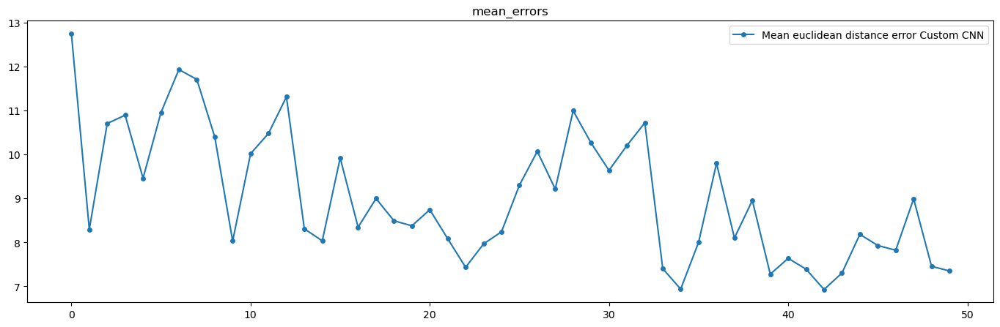

Average error of all points:  9.032114200222203
Minimum error of all points:  6.925199843175919  for point:  42
Maximim error of all points:  12.748450631869378  for point:  0


In [ ]:
import numpy as np
import matplotlib.pyplot as plt


def calculate_error(predicted_coords, actual_coords):
    errors = np.sqrt(np.sum((predicted_coords - actual_coords) ** 2, axis=1))
    return errors



all_error=[]
predictions = ensemble_model.predict(X_test, verbose=0)

for i in range(len(predictions)):
    errors = calculate_error(predictions[i], y_test[i])
    all_error.append(errors)

all_error = np.array(all_error).transpose()
mean_errors=[]

for i in range(len(all_error)):
    mean_errors.append(all_error[i].mean())

plt.figure(figsize=(17,5))
plt.plot(mean_errors,  marker='o', markersize=4, linestyle='-',label = "Mean euclidean distance error Custom CNN")
plt.title('mean_errors')
plt.legend()
plt.show()
print("Average error of all points: " , np.array(mean_errors).mean())
print("Minimum error of all points: " , np.array(mean_errors).min(), " for point: " , mean_errors.index(np.array(mean_errors).min()))
print("Maximim error of all points: " , np.array(mean_errors).max(), " for point: " , mean_errors.index(np.array(mean_errors).max()))

# print("minimu error of all points: " , np.array(mean_errors).mean())



# Images

In [ ]:
X = np.load('images.npy')

In [ ]:
X.shape

(99, 300, 500, 3)

# Big brain

In [ ]:
X_fine.shape
X_reshaped_array = X_fine.reshape(X_fine.shape[0], -1, X_fine.shape[-1])
X_reshaped_array.shape
y_pre = y.copy()

In [ ]:
import numpy as np
from scipy.spatial.distance import cdist

def one_hot_encode_labels(point_cloud, landmarks, radius=5.0):
    num_landmarks = len(landmarks)
    num_points = len(point_cloud)

    # Initialize one-hot encoded labels array with all zeros
    one_hot_labels = np.zeros((num_points, num_landmarks + 1), dtype=float)

    for landmark_idx, landmark in enumerate(landmarks, start=1):
        distances = np.linalg.norm(point_cloud - landmark, axis=1)
        points_within_radius = np.where(distances <= radius)[0]
        one_hot_labels[points_within_radius, landmark_idx] = 1.0

    return one_hot_labels

# Example usage:
# Assuming `point_cloud` and `landmarks` are your input arrays

y_seg=[]
for i in range(len(X_reshaped_array)):
  point_cloud = X_reshaped_array[i]
  landmarks = y_pre[i]

  one_hot_labels = one_hot_encode_labels(point_cloud, landmarks, radius=10.0)
  y_seg.append(one_hot_labels)
# Now, `one_hot_labels` contains the one-hot encoded labels for each point, with a length of 51.
y_seg= np.array(y_seg)
X_seg = X_reshaped_array.copy()
print(X_seg.shape, y_seg.shape)

(197, 5000, 3) (197, 5000, 51)


In [ ]:

def load_data(point_cloud_batch, label_cloud_batch):
    point_cloud_batch.set_shape([NUM_SAMPLE_POINTS, 3])
    label_cloud_batch.set_shape([NUM_SAMPLE_POINTS, train_label_cloud.shape[2]])
    return point_cloud_batch, label_cloud_batch


def augment(point_cloud_batch, label_cloud_batch):
    noise = tf.random.uniform(
        tf.shape(label_cloud_batch), -0.001, 0.001, dtype=tf.float64
    )
    point_cloud_batch += noise[:, :, :3]
    return point_cloud_batch, label_cloud_batch


def generate_dataset(point_clouds, label_clouds, is_training=True):
    dataset = tf.data.Dataset.from_tensor_slices((point_clouds, label_clouds))
    dataset = dataset.shuffle(BATCH_SIZE * 100) if is_training else dataset
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(batch_size=BATCH_SIZE)
    dataset = (
        dataset.map(augment, num_parallel_calls=tf.data.AUTOTUNE)
        if is_training
        else dataset
    )
    return dataset

VAL_SPLIT = 0.2
BATCH_SIZE = 5
NUM_SAMPLE_POINTS = X_seg.shape[1]

split_index = int(len(X_seg) * (1 - VAL_SPLIT))
train_point_clouds = X_seg[:split_index]
train_label_cloud = y_seg[:split_index]
total_training_examples = len(train_point_clouds)

val_point_clouds = X_seg[split_index:]
val_label_cloud = y_seg[split_index:]

print("Num train point clouds:", len(train_point_clouds))
print("Num train point cloud labels:", len(train_label_cloud))
print("Num val point clouds:", len(val_point_clouds))
print("Num val point cloud labels:", len(val_label_cloud))

train_dataset = generate_dataset(train_point_clouds, train_label_cloud)
val_dataset = generate_dataset(val_point_clouds, val_label_cloud, is_training=False)

print("Train Dataset:", train_dataset)
print("Validation Dataset:", val_dataset)

Num train point clouds: 157
Num train point cloud labels: 157
Num val point clouds: 40
Num val point cloud labels: 40
Train Dataset: <_ParallelMapDataset element_spec=(TensorSpec(shape=(None, 5000, 3), dtype=tf.float64, name=None), TensorSpec(shape=(None, 5000, 51), dtype=tf.float64, name=None))>
Validation Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(None, 5000, 3), dtype=tf.float64, name=None), TensorSpec(shape=(None, 5000, 51), dtype=tf.float64, name=None))>


In [ ]:

def conv_block(x, filters, name):
    x = layers.Conv1D(filters, kernel_size=1, padding="valid", name=f"{name}_conv")(x)
    x = layers.BatchNormalization(name=f"{name}_batch_norm")(x)
    return layers.Activation("relu", name=f"{name}_relu")(x)


def mlp_block(x, filters, name):
    x = layers.Dense(filters, name=f"{name}_dense")(x)
    x = layers.BatchNormalization(name=f"{name}_batch_norm")(x)
    return layers.Activation("relu", name=f"{name}_relu")(x)

class OrthogonalRegularizer(keras.regularizers.Regularizer):
    def __init__(self, num_features, l2reg=0.001):
        self.num_features = num_features
        self.l2reg = l2reg
        self.eye = tf.eye(num_features)

    def __call__(self, x):
        x = tf.reshape(x, (-1, self.num_features, self.num_features))
        xxt = tf.tensordot(x, x, axes=(2, 2))
        xxt = tf.reshape(xxt, (-1, self.num_features, self.num_features))
        return tf.reduce_sum(self.l2reg * tf.square(xxt - self.eye))


def transformation_net(inputs, num_features, name):
    """
    Reference: https://keras.io/examples/vision/pointnet/#build-a-model.

    The `filters` values come from the original paper:
    https://arxiv.org/abs/1612.00593.
    """
    x = conv_block(inputs, filters=64, name=f"{name}_1")
    x = conv_block(x, filters=128, name=f"{name}_2")
    x = conv_block(x, filters=1024, name=f"{name}_3")
    x = layers.GlobalMaxPooling1D()(x)
    x = mlp_block(x, filters=512, name=f"{name}_1_1")
    x = mlp_block(x, filters=256, name=f"{name}_2_1")
    return layers.Dense(
        num_features * num_features,
        kernel_initializer="zeros",
        bias_initializer=keras.initializers.Constant(np.eye(num_features).flatten()),
        activity_regularizer=OrthogonalRegularizer(num_features),
        name=f"{name}_final",
    )(x)


def transformation_block(inputs, num_features, name):
    transformed_features = transformation_net(inputs, num_features, name=name)
    transformed_features = layers.Reshape((num_features, num_features))(
        transformed_features
    )
    return layers.Dot(axes=(2, 1), name=f"{name}_mm")([inputs, transformed_features])



from tensorflow import keras
from tensorflow.keras import backend as K


def get_shape_segmentation_model(num_points, num_classes):
    input_points = keras.Input(shape=(None, 3))

    # PointNet Classification Network.
    transformed_inputs = transformation_block(
        input_points, num_features=3, name="input_transformation_block"
    )
    features_64 = conv_block(transformed_inputs, filters=64, name="features_64")
    features_128_1 = conv_block(features_64, filters=128, name="features_128_1")
    features_128_2 = conv_block(features_128_1, filters=128, name="features_128_2")
    transformed_features = transformation_block(
        features_128_2, num_features=128, name="transformed_features"
    )
    features_512 = conv_block(transformed_features, filters=512, name="features_512")
    features_2048 = conv_block(features_512, filters=2048, name="pre_maxpool_block")
    global_features = layers.MaxPool1D(pool_size=num_points, name="global_features")(
        features_2048
    )

    global_features = K.tile(global_features, [1, num_points, 1])

    # Segmentation head.
    segmentation_input = layers.Concatenate(name="segmentation_input")(
        [
            features_64,
            features_128_1,
            features_128_2,
            transformed_features,
            features_512,
            global_features,
        ]
    )
    segmentation_features = conv_block(
        segmentation_input, filters=128, name="segmentation_features"
    )
    outputs = layers.Conv1D(
        num_classes, kernel_size=1, activation="softmax", name="segmentation_head"
    )(segmentation_features)
    return keras.Model(input_points, outputs)


In [ ]:

x, y = next(iter(train_dataset))

num_points = x.shape[1]
num_classes = y.shape[-1]

segmentation_model = get_shape_segmentation_model(num_points, num_classes)
segmentation_model.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, None, 3)]            0         []                            
                                                                                                  
 input_transformation_block  (None, None, 64)             256       ['input_3[0][0]']             
 _1_conv (Conv1D)                                                                                 
                                                                                                  
 input_transformation_block  (None, None, 64)             256       ['input_transformation_block_1
 _1_batch_norm (BatchNormal                                         _conv[0][0]']                 
 ization)                                                                                   

Steps per epoch: 31.
Total training steps: 1860.


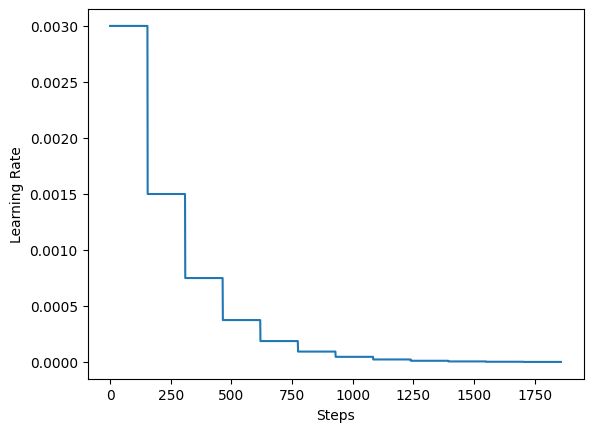

In [ ]:
EPOCHS = 60

steps_per_epoch = total_training_examples // BATCH_SIZE
total_training_steps = steps_per_epoch * EPOCHS
print(f"Steps per epoch: {steps_per_epoch}.")
print(f"Total training steps: {total_training_steps}.")

lr_schedule = keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=0.003,
    decay_steps=steps_per_epoch * 5,
    decay_rate=0.5,
    staircase=True,
)

steps = range(total_training_steps)
lrs = [lr_schedule(step) for step in steps]

plt.plot(lrs)
plt.xlabel("Steps")
plt.ylabel("Learning Rate")
plt.show()

In [ ]:

def run_experiment(epochs):
    segmentation_model = get_shape_segmentation_model(num_points, num_classes)
    segmentation_model.compile(
        optimizer=keras.optimizers.Adam(learning_rate=lr_schedule),
        loss=keras.losses.CategoricalCrossentropy(),
        metrics=["accuracy"],
    )

    checkpoint_filepath = "checkpoint.weights.h5"
    checkpoint_callback = keras.callbacks.ModelCheckpoint(
        checkpoint_filepath,
        monitor="val_accuracy",
        save_best_only=True,
        save_weights_only=True,
    )

    history = segmentation_model.fit(
        train_dataset,
        validation_data=val_dataset,
        epochs=epochs,
        callbacks=[checkpoint_callback],
    )

    segmentation_model.load_weights(checkpoint_filepath)
    return segmentation_model, history


segmentation_model, history = run_experiment(epochs=EPOCHS)

Epoch 1/60
32/32 [==============================] - 32s 453ms/step - loss: 19.1478 - accuracy: 0.0447 - val_loss: 10340491.0000 - val_accuracy: 0.0092
Epoch 2/60
32/32 [==============================] - 14s 445ms/step - loss: 4.4658 - accuracy: 0.1479 - val_loss: 50113.5859 - val_accuracy: 0.0161
Epoch 3/60
32/32 [==============================] - 14s 439ms/step - loss: 5.3838 - accuracy: 0.2088 - val_loss: 207.3269 - val_accuracy: 0.0324
Epoch 4/60
32/32 [==============================] - 13s 401ms/step - loss: 6.1803 - accuracy: 0.2108 - val_loss: 4980.0322 - val_accuracy: 0.0136
Epoch 5/60
32/32 [==============================] - 14s 449ms/step - loss: 4.1459 - accuracy: 0.2925 - val_loss: 13.3559 - val_accuracy: 0.0554
Epoch 6/60
32/32 [==============================] - 13s 399ms/step - loss: 4.0203 - accuracy: 0.3357 - val_loss: 15.9292 - val_accuracy: 0.0345
Epoch 7/60
32/32 [==============================] - 14s 444ms/step - loss: 4.1360 - accuracy: 0.3454 - val_loss: 6.6450 - v

In [ ]:
validation_batch = next(iter(val_dataset))
val_predictions = segmentation_model.predict(validation_batch[0])


1/1 [==============================] - 1s 620ms/step


In [ ]:
X_test_temp =np.array(validation_batch[0])
y_test_temp = np.array(validation_batch[1])
predictions_temp = val_predictions

y_test_temp_index = np.argmax(y_test_temp, axis=2)
predictions_temp_index = np.argmax(predictions_temp, axis=2)

y_test_temp_index.shape
predictions_temp_index.shape


np.unique(predictions_temp_index[0], return_counts=True)


indices_pre = np.where(predictions_temp_index[0] == 10)
indices_test = np.where(y_test_temp_index[0] == 10)

indices
X_test_temp[0][indices].shape


(20, 3)

In [ ]:
plot_face( X_test_temp[0][indices_pre], X_test_temp[0][indices_test])
# plot_face(X_test_temp[0], y_test[])

# EOF

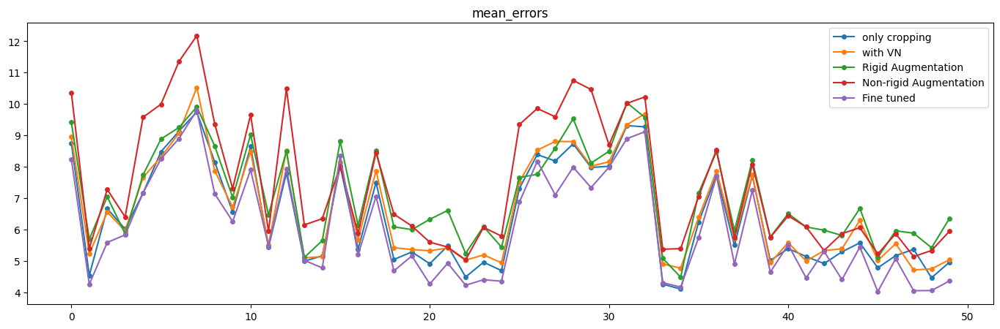

only cropping: 6.43
with VN: 6.63
Rigid Augmentation: 7.08
Non-rigid Augmentation: 7.45
After fine tuned: 6.08


In [ ]:
pure = np.load("error_41k.npy")
vn_alligned = np.load("error_41k_vn.npy")
rigid = np.load("error_41k_rigid_aug.npy")
nonrigid = np.load("error_41k_nonrigid_aug.npy")
finetune = np.load("fine_tune_error_41k.npy")




plt.figure(figsize=(17,5))

plt.plot(pure, marker='o', markersize=4, linestyle='-',label = "only cropping")
plt.plot(vn_alligned, marker='o', markersize=4, linestyle='-', label = "with VN")
plt.plot(rigid, marker='o', markersize=4, linestyle='-',label = "Rigid Augmentation")
plt.plot(nonrigid, marker='o', markersize=4, linestyle='-',label = "Non-rigid Augmentation")
plt.plot(finetune, marker='o', markersize=4, linestyle='-',label = "Fine tuned")

plt.title('mean_errors')
plt.legend()
plt.show()





print("only cropping:" , "{:.2f}".format(np.array(pure).mean()))
print("with VN:" , "{:.2f}".format(np.array(vn_alligned).mean()))
print("Rigid Augmentation:" , "{:.2f}".format(np.array(rigid).mean()))
print("Non-rigid Augmentation:" , "{:.2f}".format(np.array(nonrigid).mean()))
print("After fine tuned:" , "{:.2f}".format(np.array(finetune).mean()))

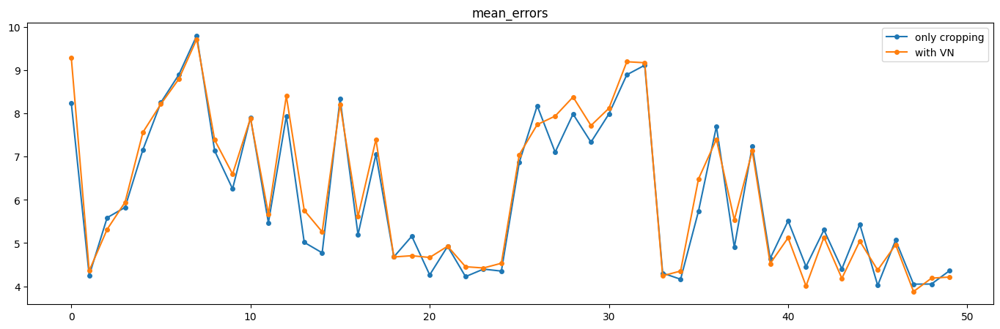

only cropping: 6.08
with VN: 6.20


In [ ]:
pure = np.load("fine_tune_error_41k.npy")
vn_alligned = np.load("fine_tune_error_41k_vn.npy")





plt.figure(figsize=(17,5))

plt.plot(pure, marker='o', markersize=4, linestyle='-',label = "only cropping")
plt.plot(vn_alligned, marker='o', markersize=4, linestyle='-', label = "with VN")

plt.title('mean_errors')
plt.legend()
plt.show()





print("only cropping:" , "{:.2f}".format(np.array(pure).mean()))
print("with VN:" , "{:.2f}".format(np.array(vn_alligned).mean()))